# **Hands-on Motion Estimation and Correction**

> *by swolf*:
>
> I tweak the notebook a little bit making it run more easily on local environments,
>
> using native python packages without the pain of compiling packages like gpuNufft or bart. 
>
> It's a workshop notebook about motion correction,
>
> and we should focus on the most important thing instead of these annoying compiling issues.

*by [Gastao Cruz](https://twitter.com/gastaocruz) and [Thomas Kuestner](https://twitter.com/kuestnerthomas)*

In this hands-on of the [ISMRM Workshop on Motion Detection and Correction 2022](https://www.ismrm.org/workshops/2022/Motion/), we aim to convey the principles of motion artifacts, their appearance in the MR image, means of estimating motion (conventional and deep learning) and correcting for the induced motion artifacts during reconstruction.

This notebook is based on a [Github repository](https://github.com/lab-midas/ismrm-moco-workshop).

## Getting started
First you need to run the
- **[0. Prerequisites](#Prerequisites)** which [installs the Python packages and libraries](#Installation), [imports the modules](#Imports) and [loads the data](#DataLoading) (see Provided material). In this hands-on, we will only focus on 2D single-slice brain MR image. If you want to try out the other datasets, you may need to adapt some functions, as only 2D processing is supported.

Afterwards you can decide to run either (or all) of the following three topics (in any order):
- **[1. Motion artifact appearance](#MotionArtifactAppearance)**: Learn something about the spatial and temporal behaviour of motion and how it manifests in the image for Cartesian and non-Cartesian imaging
- **[2. Motion estimation / image registration](#MotionEstimation)**: Learn how to perform an image registration using conventional and deep learning based solutions
- **[3. Motion-compensated image reconstruction](#MotionCompensated)**: Learn to incorporate motion estimation into image reconstruction to obtain a motion-corrected image

## Provided material
Two datasets (brain and heart) are distributed with this hands-on tutorial:
- `brain_large.npz` (GIT LFS): multi-coil 3D T1w brain MR image; matrix size = 256 x 216 x 65 x 7 (X x Y x Slices x Channels)
- `brain_slice.npz`: single central slice of `brain_large.npz`; matrix size = 256 x 216 x 7 (X x Y x Channels)
- `heart_large.npz` (GIT LFS): multi-coil, multi-slice 2D cardiac CINE MR image; matrix size = 176 x 132 x 12 x 25 x 10 (X x Y x Slices x Cardiac Phases x Channels)

**Attention:** The following codes are only defined for 2D processing. If you plan to use them for a 3D dataset, you would first need to extend some of the functions below.

# 0. Prerequisites
<a name="Prerequisites"></a>

## Installation
<a name="Installation"></a>
Ensure Python 3.8 is used for best compatibility.

### Python packages

In [9]:
# install dependencies
! pip install --upgrade pip
! pip install simpleitk medutils-mri scikit-image voxelmorph # imjoy
# ! git clone https://github.com/voxelmorph/voxelmorph.git

Looking in indexes: https://pypi.tuna.tsinghua.edu.cn/simple


Looking in indexes: https://pypi.tuna.tsinghua.edu.cn/simple


In [10]:
# Download ESPIRiT code for coil sensitivity map estimation
!git clone https://github.com/mikgroup/espirit-python.git
!cp espirit-python/espirit.py .

fatal: destination path 'espirit-python' already exists and is not an empty directory.


### FINUFFT & mri-nufft

*by swolf*: It's much easier to use finufft& mri-nufft instead of bart and gpuNUFFT

In [11]:
!pip install finufft
# the current distribution version has bugs on python 3.8 so we directly install it from source
!pip install git+https://github.com/mind-inria/mri-nufft.git

Looking in indexes: https://pypi.tuna.tsinghua.edu.cn/simple
Looking in indexes: https://pypi.tuna.tsinghua.edu.cn/simple
  Cloning https://github.com/mind-inria/mri-nufft.git to /tmp/pip-req-build-tq20sv3r
  Running command git clone --filter=blob:none --quiet https://github.com/mind-inria/mri-nufft.git /tmp/pip-req-build-tq20sv3r
  Resolved https://github.com/mind-inria/mri-nufft.git to commit cfd747012462274ca9e46b33680e33b29abba517
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for mri-nufft: filename=mri_nufft-0.8.1.dev13-py3-none-any.whl size=89426 sha256=b65487a80772a8c2037387f4ab5917049efc7efbc0c7d82d3d63a5a33caf879a
  Stored in directory: /tmp/pip-ephem-wheel-cache-1_gnd2_l/wheels/03/29/96/8f63aee7cd4d2d95555172590ba436e18857fa07ba09643ec2
Successfully built mri-nufft
  Attempting uninstall: mri-nufft
    Found existing installation: mri-nufft 0.8.1.dev12
    Uninstalling mr

### Optox

### MERLIN

Some helper functions:

In [12]:
!pip uninstall -y matplotlib
!pip install matplotlib==3.2.2

Found existing installation: matplotlib 3.2.2
Uninstalling matplotlib-3.2.2:
  Successfully uninstalled matplotlib-3.2.2
Looking in indexes: https://pypi.tuna.tsinghua.edu.cn/simple
  Using cached https://pypi.tuna.tsinghua.edu.cn/packages/77/5c/6a3aa574ed33911a0b4deb66b3b9d2e72ed4bcbfd70f52a5546395156dd3/matplotlib-3.2.2-cp38-cp38-manylinux1_x86_64.whl (12.4 MB)


### Matplotlib

In [13]:
%matplotlib inline

def plotcfl(files, title=None):
  import numpy as np
  from matplotlib import pyplot as plt
  import cfl
  import os

  from ipywidgets import interact, interactive, fixed, interact_manual
  import ipywidgets as widgets

  def update(Range=(0.,1.),Coil=0, Map=0, Slice=0, Batch=0):

    if(title==None):
      wtitle=[]
      for file in files:
        head, tail = os.path.split(file)
        wtitle.append(tail)
    else:
      wtitle=title

    data=cfl.readcfl(files[0])
    rat=data.shape[0]/data.shape[1]
    width=16

    ncols=len(files)
    nrows=1

    rat=rat
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, constrained_layout=True, squeeze=False, figsize=(width, width*rat))

    for i in range(len(files)):

        data=cfl.readcfl(files[i])
        nshp = [1] * 16

        for k in range(len(data.shape)):
          nshp[k] = data.shape[k]

        idx=[0]*16
        idx[3]=min(Coil,nshp[3]-1)
        idx[4]=min(Map,nshp[4]-1)
        idx[13]=min(Slice,nshp[13]-1)
        idx[15]=min(Batch,nshp[15]-1)

        idx[0]=slice(None, None, -1)
        idx[1]=slice(None, None, None)

        dat=np.abs(data.reshape(nshp)[tuple(idx)])
        if 0 < np.max(dat):
          dat=dat/np.max(dat)

        axs.flatten()[i].imshow(dat,cmap="gray",vmin=Range[0], vmax=Range[1])
        axs.flatten()[i].set_title(wtitle[i])
    for ax in axs.flatten():
      ax.axis("off")

    plt.show()

  nshp = [1] * 16
  for file in files:
    data=cfl.readcfl(file)
    for i in range(len(data.shape)):
      nshp[i] = max(data.shape[i], nshp[i])

  interact(update,
           Range=widgets.FloatRangeSlider(value=[0.,1.], min=0, max=1.),
           Coil=widgets.IntSlider(min=0, max=nshp[3]-1, step=1, value=0),
           Map=widgets.IntSlider(min=0, max=nshp[4]-1, step=1, value=0),
           Slice=widgets.IntSlider(min=0, max=nshp[13]-1, step=1, value=0),
           Batch=widgets.IntSlider(min=0, max=nshp[15]-1, step=1, value=0))

In [64]:
!pip install tensorflow

Looking in indexes: https://pypi.tuna.tsinghua.edu.cn/simple
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 479.6/479.6 MB 6.1 MB/s eta 0:00:00m eta 0:00:010:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.7/133.7 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 22.4 MB/s eta 0:00:00m eta 0:00:010:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 21.6 MB/s eta 0:00:00m eta 0:00:010:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.5/24.5 MB 15.6 MB/s eta 0:00:00m eta 0:00:010:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 12.8 MB/s eta 0:00:00m eta 0:00:010:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.5/65.5 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 7.6 MB/s eta 0:00:0031m20.6 MB/s eta 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 22.3 MB/s eta 0:00:00m eta 0:00:010:00

## Imports
<a name="Imports"></a>

**ATTENTION:** Please make sure that you have restarted the Jupyter kernel after installation of the above libraries (error message of unexpected crash and restart). Otherwise, the installed libraries will not be found. You can restart the kernel with:

```
get_ipython().kernel.do_shutdown(True)
```



In [65]:
# import os
# import sys

# os.environ['TOOLBOX_PATH']=os.getcwd()+"/bart/"
# os.environ['PATH'] = os.environ['TOOLBOX_PATH'] + ":" + os.environ['PATH']
# sys.path.append(os.environ['TOOLBOX_PATH'] + "/python/")

# import numpy as np
# import medutils
# import SimpleITK as sitk
# import matplotlib.pyplot as plt

# try:
#   import optotf
# except:
#   print('Optox not installed')
import tensorflow as tf


# import voxelmorph as vxm
#import neurite as ne

# own utils
# from utils.flowplotting import *
# from utils.imageplotting import *
# from utils.mri import *
# from utils.padding import *
# from utils.radialsampling import *
# from utils.cartesiansampling import *
# from utils.warping import *
# from utils.motionsim import *
# from utils.motioncomp import *

# from mri.operators import NonCartesianFFT

import numpy as np
import medutils
import espirit
import SimpleITK as sitk

from mrinufft.trajectories import initialize_2D_radial
from mrinufft.operators.interfaces.finufft import MRIfinufft
from mrinufft.density import voronoi

from utils.padding import zpad
from utils.imageplotting import plot
from utils.motionsim import transform_img, simulate_motion, plot_motion_course, simulate_motion_radial, get_transform
from utils.mri import rss, fft2c, ifft2c, mriAdjointOp, mriForwardOp, minmaxscale
from utils.cartesiansampling import generate_mask
from utils.radialsampling import prepare_radial
from utils.flowplotting import plot_flow
from utils.warping import warp_2D

2024-06-06 23:29:04.523604: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-06-06 23:29:04.570420: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-06-06 23:29:04.571049: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-06-06 23:29:05.411579: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## Data loading
<a name="DataLoading"></a>

In [15]:
# Load the numpy
import numpy as np
from utils.padding import zpad
from utils.imageplotting import plot

datapath = 'data/brain_slice.npz'  # brain_slice
data = np.load(datapath)
img = data['arr_0']
nRead = np.amax(np.shape(img)[0:2])
img = zpad(img, (nRead, nRead, np.shape(img)[2])).astype(np.complex64)  # make image quadratic for

nX, nY, nCha = np.shape(img)

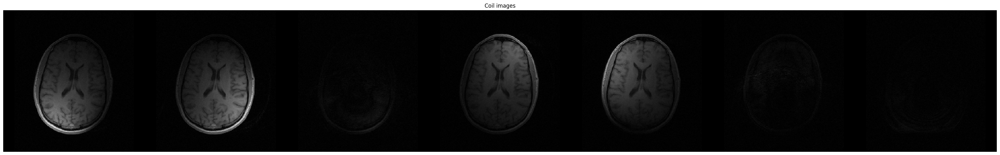

In [16]:
plot(img, title='Coil images')

# 1. Motion artifact appearance
<a name="MotionArtifactAppearance"></a>
In this part, we will examine the impact of the motion artifacts on the image. Motion during an MR scan introduces blurring and aliasing (along the phase-encoding directions). Artifact appereance depends on the imaging trajectory: Cartesian and non-Cartesian. In the following we will first investigate the motion artifact appeareance on fully-sampled cases and then move towards undersampled/accelerated imaging trajectories.



## **Spatial description of motion**
For translational, rigid and affine motion exists a direct linear relationship between the motion-corrected/free k-space $\nu(k)$ and the motion-affected k-space $\nu'(k')$.

$$
\nu(k) = \nu'(k') \frac{\operatorname{exp}(2\pi i k'\cdot t)}{|\det (A)|}
$$
where $k'$ is the motion-affected k-space trajectory, $k$ is the motion-corrected/free k-space trajectory, $t=\lbrack t_x, t_y, t_z \rbrack^T$ is the translational component of the motion and $A$ is the affine motion matrix in 3D

$
\begin{align}
A = RGS = R_x R_y R_z G S = \begin{bmatrix} 1 & 0 & 0 \\ 0 & \cos \phi & -\sin \phi \\ 0 & \sin \phi & \cos \phi \end{bmatrix} \begin{bmatrix} \cos \theta & 0 & \sin \theta \\ 0 & 1 & 0 \\ -\sin \theta & 0 & \cos \theta \end{bmatrix} \begin{bmatrix} \cos \psi & -\sin \psi & 0 \\ \sin \psi & \cos \psi & 0 \\ 0 & 0 & 1 \end{bmatrix} \begin{bmatrix} 1 & G_{xy} & G_{xz} \\ 0 & 1 & G_{yz} \\ 0 & 0 & 1 \end{bmatrix} \begin{bmatrix} S_x & 0 & 0 \\ 0 & S_y & 0 \\ 0 & 0 & S_z \end{bmatrix}
\end{align}
$

consisting of the rotation matrices $R_x, R_y$ and $R_z$ (with angles $\lbrace \phi, \theta, \psi \rbrace$) along the respective axis $x, y$ and $z$, shearing matrix $G$ (with 3D shear parameters $\lbrace G_{xy}, G_{xz}, G_{yz} \rbrace$) and scaling matrix $S$ (with 3D scale factors $\lbrace S_x, S_y, S_z \rbrace$).

In 2D, the affine motion matrix simplifies to

$
A=RGS = \begin{bmatrix} \cos \phi & \sin \phi \\-\sin \phi & \cos \phi \end{bmatrix} \begin{bmatrix} 1 & G_{xy} \\ 0 & 1 \end{bmatrix} \begin{bmatrix} S_x & 0 \\ 0 & S_y \end{bmatrix}
$

### Affine motion
The 3D affine transformation has 12 degrees of freedom consisting of 3D translations, rotations, shears and scaling. It maps the k-space point $k=\lbrack k_x, k_y, k_z \rbrack^T$ to the corrupted k-space point $k'=\lbrack k'_x, k'_y, k'_z \rbrack^T$ following $k'=A^{-T} k$

in k-space: $
\begin{bmatrix} k'_x \\ k'_y \\ k'_z \end{bmatrix} = R \begin{bmatrix} 1 & 0 & 0 \\ -G_{xy} & 1 & 0 \\ (G_{xy}G_{yz}-G_{xz}) & -G_{yz} & 1\end{bmatrix} \begin{bmatrix} S_x^{-1} & 0 & 0 \\ 0 & S_y^{-1} & 0 \\ 0 & 0 & S_z^{-1} \end{bmatrix} \begin{bmatrix} k_x \\ k_y \\ k_z \end{bmatrix}
$

or equivalently

in image domain: $
\begin{bmatrix} x' \\ y' \\ z' \\ 1 \end{bmatrix} = \begin{bmatrix} & & & t_x \\ & R & & t_y \\ & & & t_z \\ 0 & 0 & 0 & 1 \end{bmatrix} GS \begin{bmatrix} x \\ y \\ z \\ 1 \end{bmatrix}
$

In this case, we are considering the augmented matrix form (i.e. 4D for 3D spatial), which conveniently allows us to write translations and the other affine components as a series of matrix multiplications.

### Rigid motion
In case of rigid motion, we only have translation $t$ and rotation $R$, i.e. $G=S=I$, where $I$ is the identity matrix.

### Translational motion
For translational motion $t$, all other components are neglected, i.e. $R=G=S=I$.

### Elastic (non-rigid) motion
For elastic motion, the image $\rho \in \mathbb{R}^N$ is deformed with a deformation field/motion model $u$ which is a vector field containing the motion vector at every voxel $u \in \mathbb{R}^{N \times D}$ for a $D$-dimensional registration. The deformed image is given as
$
\rho_d(x') = \rho(u(x))
$.

## **Temporal description of motion**
Motion represents a displacement over time and this can be addressed most directly by stating the spatial variation (i.e. the affine motion parameters) as a function of time. In practice, however, this belies the complexity of real physiologic motion, where limits on real-world acceleration, shear, etc. limit how displacement can practically vary over time. Moreover, some choice of discretization for the time domain is necessary.

### Regular motion
Many types of physiologic motion exhibit temporal regularity. Respiration has an inspiration and expiration phase; the heartbeat can be characterized by an approximately repeating waveform, identifiable by the QRS complex in the ECG. A key aspect of these types of motion is that while they are generally periodic, they do not necessarily have a fixed frequency through the duration of a scan — a subject may hold their breath; a heartbeat may skip. Therefore, these types of motion are often described as cyclic rather than periodic.

### Irregular motion
Irregular motions (e.g., head motion) are generally represented using a discretized time series of serial displacements.

## Motion in Cartesian imaging
We will first examine the impact of motion on Cartesian imaging. We can apply the motion in the image domain by the function:

```
def transform_img(img, p):
# img      input image to be transformed
# p        affine transformation parameters
#          3D (rank(img) == 3): t_x, t_y, t_z, \phi [°], \theta [°], \psi [°], G_{xy}, G_{xz}, G_{yz}, S_x, S_y, S_z
#          2D (rank(img) == 2): t_x, t_y, \phi [°], G_{xy}, S_x, S_y
# return   transformed image
```
takes care of creating and applying the transformation to the input `img`.



### Motion in fully-sampled imaging
**Task 1:** Apply a 2D translational motion with $t_x=10, t_y=5$ to the RSS coil-combined image (`img_rss = rss(img)`) and plot the original and transformed image side-by-side using the function `plot([img_a, img_b])`.


```
def plot(img, flow=None, ...):
# img        to be plotted image or list of 2D images
#            2D: single 2D image
#            3D: third dimension is plotted side-by-side
# flow       2D: [x, y, flowDir]
#            3D: [x, y, slices, flowDir]
#            flowDir being the x and y components of the flow
```



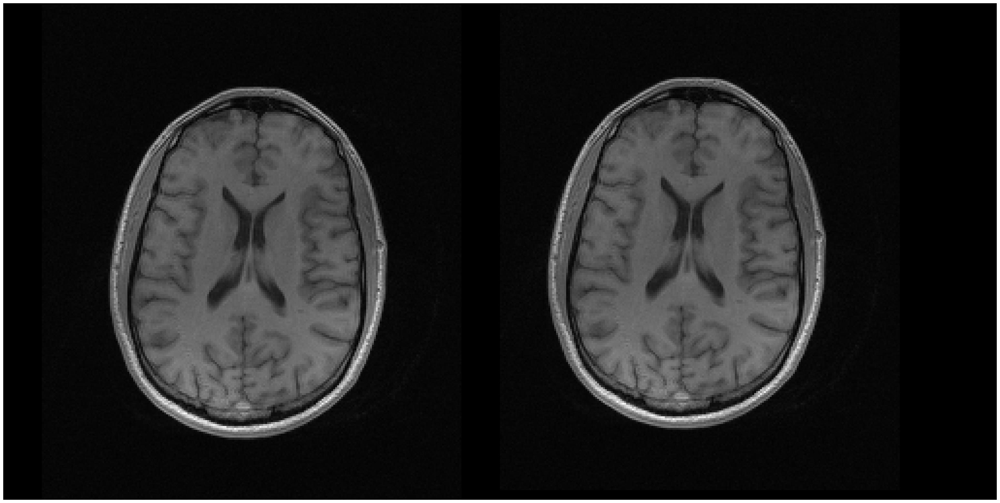

In [17]:
img_rss = rss(img)
img_trans = transform_img(img_rss, [30, 5, 0, 0, 1, 1])
plot([img_rss, img_trans])

**Task 2:** Apply an in-plane rotation of $\phi=30^\circ$.

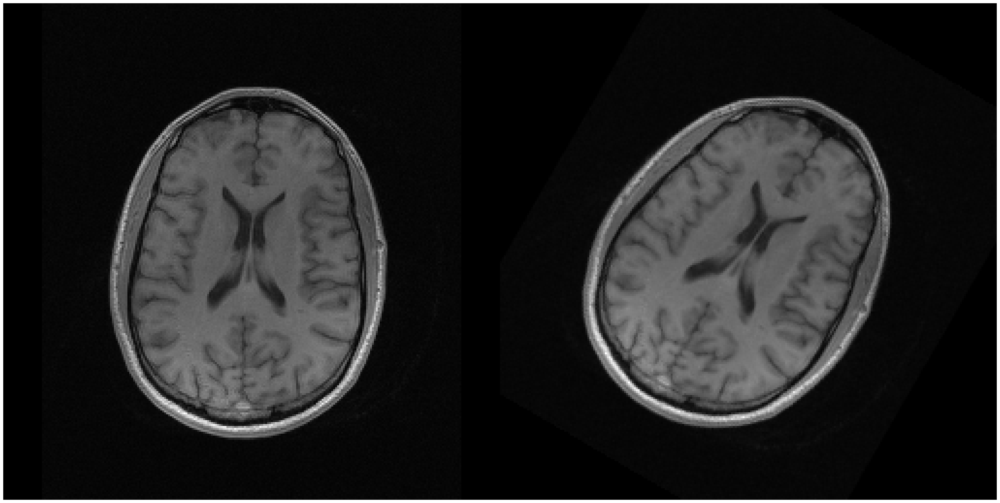

In [18]:
img_rot = transform_img(img_rss, [0, 0, 30, 0, 1, 1])
plot([img_rss, img_rot])

**Task 3:** Try different combinations of translation, rotation, scalings and shearings.

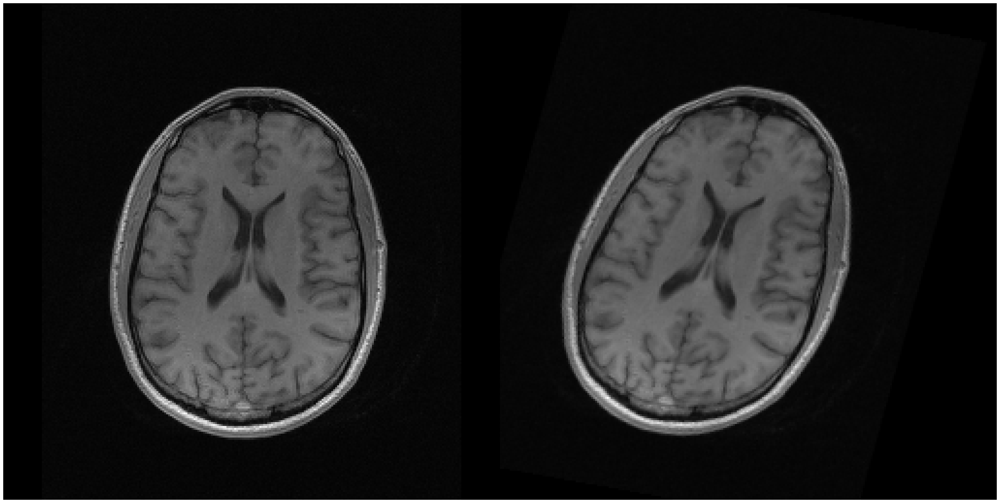

In [19]:
img_affine = transform_img(img_rss, [4, 0, 10, 0.1, 1, 1])
plot([img_rss, img_affine])

**Task 4:** Write the equivalent translational operation of the image domain transformation in k-space. Plot the translational offsetted image performed in image domain, k-space domain and the absolute error between image domain and k-space domain transformation.<br/>
*Optional:* Write the equivalent affine operation in k-space.

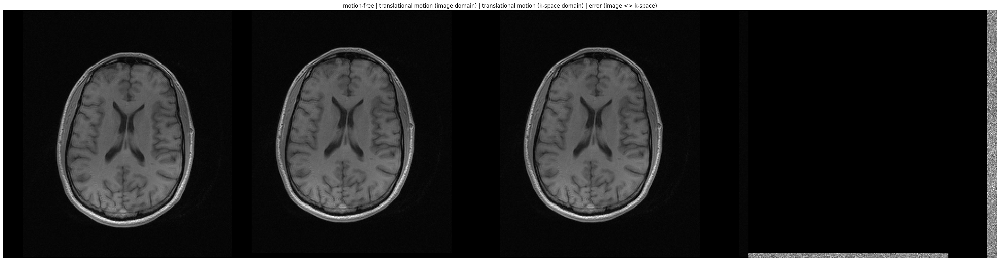

In [20]:
kspace = fft2c(img)
p = [30, 5, 0, 0, 1, 1]

mask_motion = np.ones(np.shape(kspace)[1])
kspace_motion = np.zeros_like(kspace)
y,x=np.meshgrid(np.linspace(-0.5,0.5-1/np.shape(kspace)[0], num=np.shape(kspace)[0]), np.linspace(-0.5,0.5-1/np.shape(kspace)[1], num=np.shape(kspace)[1]), indexing='ij')
dy = 0
for iL in np.arange(np.shape(kspace)[1]):
  if mask_motion[iL]==1:
    dPhase = np.exp(2*np.pi*1j*(x[:, dy+iL]*p[0]\
                    + y[:, dy+iL]*p[1]))

    kspace_motion[:,iL,:] = kspace[:,iL,:]*dPhase[:,np.newaxis]
  else:
    kspace_motion[:,iL,:] = kspace[:,iL,:]

img_motion_k = ifft2c(kspace_motion)

plot([img_rss, img_trans, rss(img_motion_k), np.abs(img_trans - rss(img_motion_k))], title='motion-free | translational motion (image domain) | translational motion (k-space domain) | error (image <> k-space)')

Let us now simulate a simple case of a motion-affected MR scan. Therefore, we will impact every $n$-th phase-encoding line with motion using the function `simulate_motion()`. In order to simulate it, we first need to set up the functions for a zero-filled reconstruction.

### Zero-filled reconstruction
In order to simulate motion and ultimately reconstruct an image, we need the multi-coil forward operator $A$ in `mriForwardOp(image, mask, smaps)` and adjoint operator $A^∗$ in `mriAdjointOp(kspace, mask, smaps)`, as well as an estimation of the coil sensitivities.

*Hint*: We perform a centered FFT with `ortho` normalization in order to provide adjoint operators.
Suggested Readings:<br/>
Pruessmann et al. [SENSE: Sensitivity encoding for fast MRI](https://onlinelibrary.wiley.com/doi/abs/10.1002/%28SICI%291522-2594%28199911%2942%3A5%3C952%3A%3AAID-MRM16%3E3.0.CO%3B2-S) Magnetic Resonance in Medicine, 43(5):952-962, 1999.

#### Forward and adjoint operator
The operators are already defined (and imported) in `utils/mri.py`:


```
def mriAdjointOp(kspace, mask, smaps):
  return np.sum(ifft2c(kspace * mask)*np.conj(smaps), axis=-1)

def mriForwardOp(image, mask, smaps):
  return fft2c(smaps * image[:,:,np.newaxis]) * mask

def fft2c(image, axes=(0,1)):
  return np.fft.fftshift(np.fft.fft2(np.fft.ifftshift(image, axes=axes), norm='ortho', axes=axes), axes=axes)

def ifft2c(kspace, axes=(0,1)):
  return np.fft.fftshift(np.fft.ifft2(np.fft.ifftshift(kspace, axes=axes), norm='ortho', axes=axes), axes=axes)
```


#### Coil sensitivity estimation
The coil sensitivity maps (`smaps`) are smooth maps that show us in which parts the individual coil elements are sensitive. We will need these information for our multi-coil MRI forward and adjoint operators. We use the [python implementation](https://github.com/mikgroup/espirit-python) for ESPIRiT [1,2] to estimate these coil sensitivity maps.

[1] Uecker et al. [ESPIRiT—an eigenvalue approach to autocalibrating parallel MRI: Where SENSE meets GRAPPA](https://onlinelibrary.wiley.com/doi/10.1002/mrm.24751). Magn Reson Med 71(3):990-1001, 2014.

[2] https://github.com/mikgroup/espirit-python

In [21]:
kspace = fft2c(img)
kspace_espirit = kspace[:,:,np.newaxis,:]
smaps_espirit = espirit.espirit(kspace_espirit, 8, 20, 0.05, 0)

smaps = smaps_espirit[:,:,0,:,0]

Let us visualize the sensitivity maps

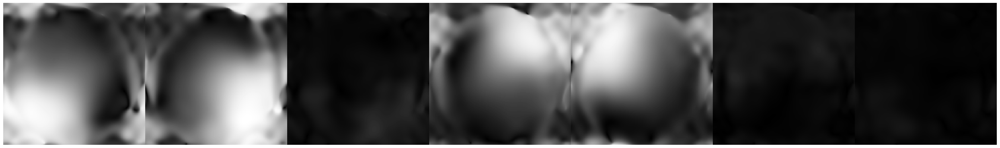

In [22]:
plot(smaps)

Now, you should check if the adjoint operator is working as expected. The result should be a coil-combined image. Right now, there is no undersampling mask involved, i.e., it is set to all ones.

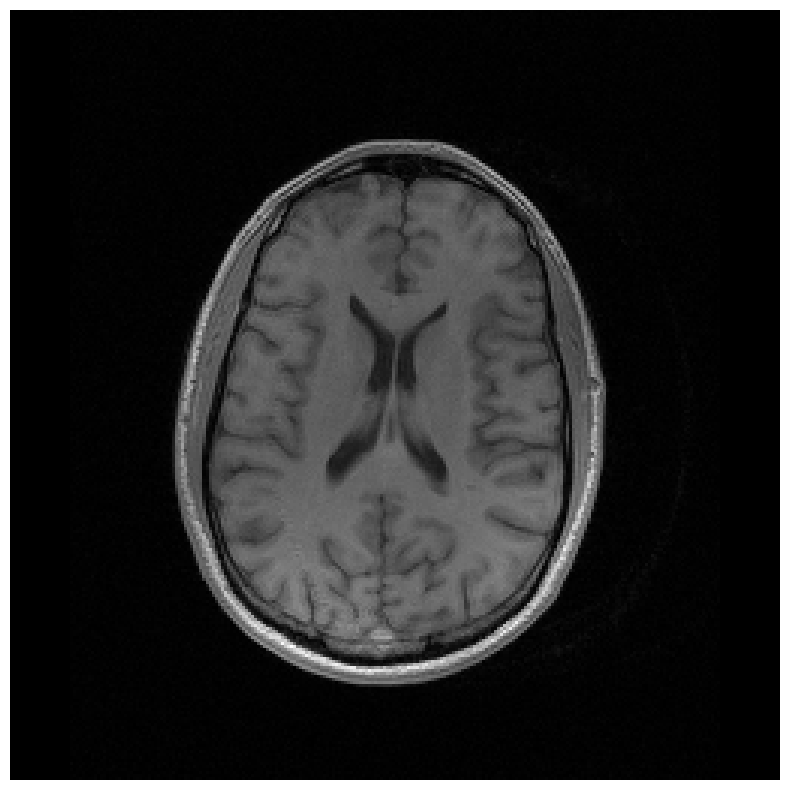

In [23]:
sampling_mask_fs = np.ones_like(kspace)  # fully-sampled sampling mask
img_cc = mriAdjointOp(kspace, sampling_mask_fs, smaps)
plot(img_cc)

### Motion simulation
Now we can simulate motion in the acquired k-space. The temporal behaviour, i.e. when the motion happens can be described by motion signals, which we will look into more detail in the next section. First, we will simulate an abrupt and periodic motion. We will make use of the function `simulate_motion()` in `utils/motionsim.py`.


```
def simulate_motion(img_cc, smaps, mask, p):
  # img_cc      motion-free coil-combined image
  # smaps       coil sensitivity maps
  # mask        k-space sampling mask
  # p           a) affine motion parameters (constant over time), 1x6
  #             b) affine motion course (time-dependent or time-constant), nPE x 6
  #             np.abs(p[:, :5]) > 0 = mask_motion; time points of phase-encoding steps
  #             at which motion parameters > 0 are defined, i.e. motion is happening
  # return:     motion-affected k-space, motion mask
```



**Task 5:** Simulate a motion-affected image, such that every 4-th phase-encoding line (i.e. abrupt motion) is affected by a translational motion with $t_x=10, t_y=5$.

In [24]:
p = [10, 5, 0, 0, 1, 1]
mask_motion = np.zeros(np.shape(sampling_mask_fs)[1])
mask_motion[::4] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]

kspace_motion, mask_motion = simulate_motion(img_cc, smaps, sampling_mask_fs, p)
img_fs_const_motion = mriAdjointOp(kspace_motion, sampling_mask_fs, smaps)

**Task 6:** Let us now visualize the motion-free and the motion-affected image side-by-side.

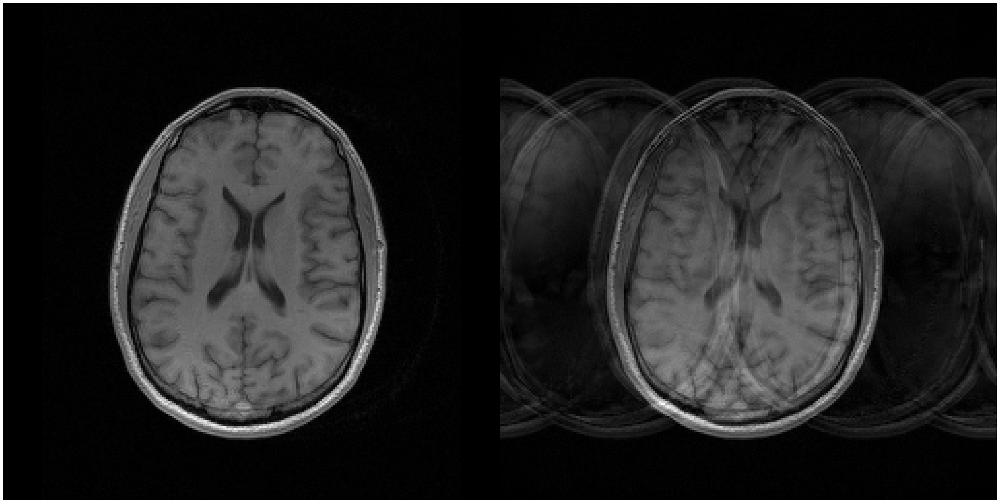

In [25]:
plot([img_cc, img_fs_const_motion])

### Temporal variation of motion
Motion represents a displacement over time and this can be addressed most directly by stating the spatial variation (i.e. the affine motion parameters) as a function of time.

The simulated motion from the previous example affected every $n$-th phase-encoding line, i.e. every $n$ TRs (assuming one echo line per TR) an abrupt motion was happening. We can depict the temporal behaviour of the motion as a function of affine motion parameters over time with the help of `plot_motion_course()` in `utils/motionsim.py`.


```
def plot_motion_course(motion_course, TR=1):
  # motion_course     temporal variation of motion, i.e. temporal course of motion parameters, shape: [motion_parameters, total_time]
  # TR                repetition time [ms]
```



**Task 7:** Plot the affine motion parameters for an abrupt translational motion ($t_x=10, t_y=5$) as a function over time for a TR=5 ms and one echo (phase-encoding line) per TR.

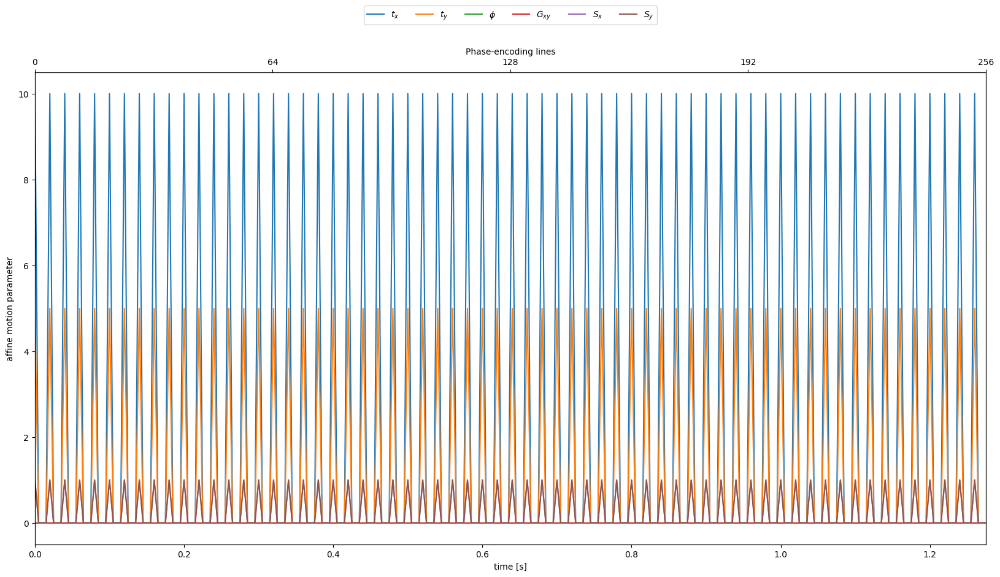

In [26]:
p = [10, 5, 0, 0, 1, 1]
TR = 5E-3

# abrupt motion
motion_course = np.zeros((np.shape(mask_motion)[1], len(p)))
for idx, cp in enumerate(p):
  motion_course[:,idx] = np.squeeze(np.abs(mask_motion[0,:,0] * cp))

plot_motion_course(motion_course, TR)

**Task 8:** Create a periodic motion whose translational motion $t_x$ follows a sinus rhythm with frequency $\omega_x=5 \text{s}^{-1}$ , maximal amplitude 15, and $t_y$ follows a cosine rhythm with a frequency $\omega_y=6 \text{s}^{-1}$, maximal amplitude 8. Both motions happen at every 4-th phase-encoding line. Plot the affine motion parameters over time (TR=5 ms).

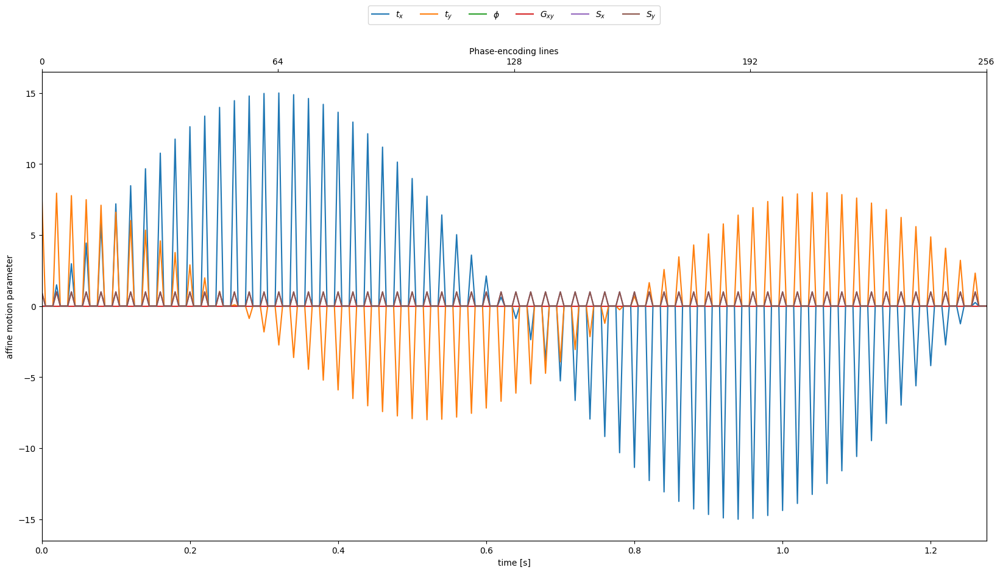

In [27]:
p = [15, 8, 0, 0, 1, 1]
TR = 5E-3

# periodic motion
time = np.arange(np.shape(mask_motion)[1]) * TR
motion_signal = np.concatenate((np.stack([p[0] * np.sin(5 * time), p[1] * np.cos(6 * time)], axis=1), np.tile(p[2:], (len(time), 1))), axis=1)
motion_course = np.zeros((np.shape(mask_motion)[1], len(p)))
mask_motion_curr = np.tile(np.squeeze(np.abs(mask_motion[0,:,0]))[:, np.newaxis], (1, len(p)))  # when is motion happening over time for each motion parameter
for idx, cp in enumerate(p):
  motion_course[:,idx] = mask_motion_curr[:, idx] * motion_signal[:,idx]

plot_motion_course(motion_course, TR)

**Task 9:** Corrupt the k-space now with the time-dependent motion parameters from **Task 8** and visualize the motion-affected image.

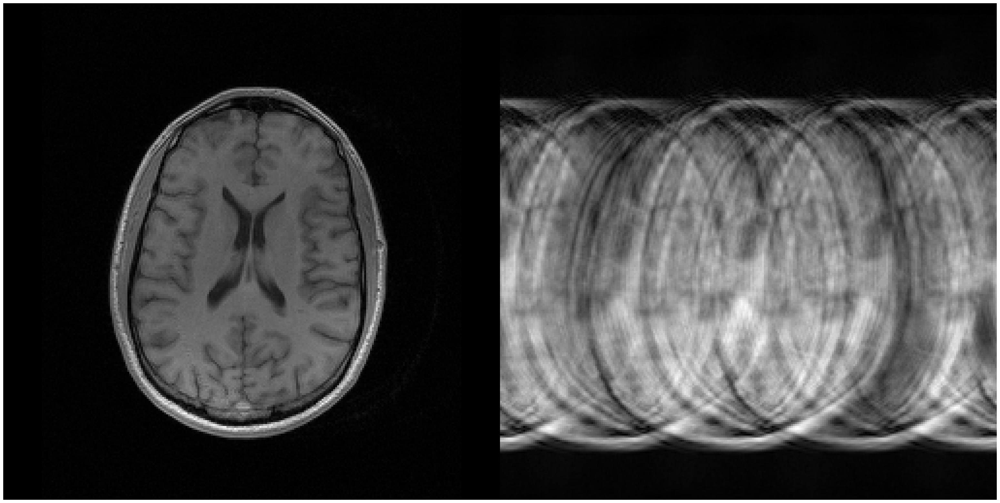

In [28]:
kspace_motion, mask_motion = simulate_motion(img_cc, smaps, sampling_mask_fs, motion_course)
img_motion = mriAdjointOp(kspace_motion, sampling_mask_fs, smaps)

plot([img_cc, img_motion])

It is also conceivable that different motion parameters are happening at different time points, i.e. we will have a different `mask_motion` for each motion parameter.

**Task 10:** Create a periodic motion whose translational motion $t_x$ follows a sinus rhythm with frequency $\omega_x=5 \text{s}^{-1}$ , maximal amplitude 15, and $t_y$ follows a cosine rhythm with a frequency $\omega_y=6 \text{s}^{-1}$, maximal amplitude 8. Translation $t_x$ happens every 4-th phase-encoding line, whereas translation $t_y$ happens at every 8-th phase-encoding line. Plot the affine motion parameters over time (TR=5 ms).

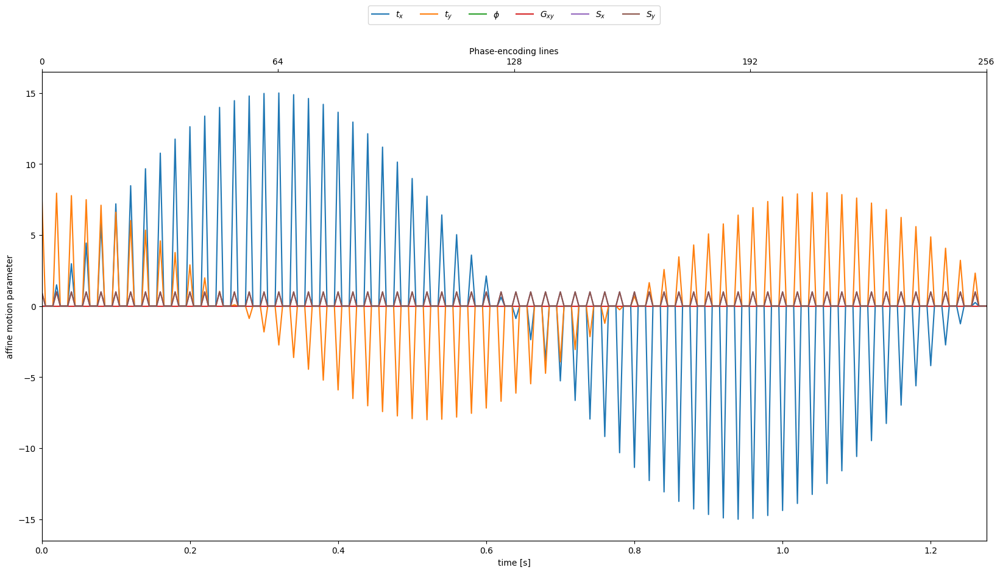

In [29]:
p = [15, 8, 0, 0, 1, 1]
TR = 5E-3

# periodic motion
time = np.arange(np.shape(mask_motion)[1]) * TR
motion_signal = np.concatenate((np.stack([p[0] * np.sin(5 * time), p[1] * np.cos(6 * time)], axis=1), np.tile(p[2:], (len(time), 1))), axis=1)
motion_course = np.zeros((np.shape(mask_motion)[1], len(p)))
mask_motion_curr = np.tile(np.squeeze(np.abs(mask_motion[0,:,0]))[:, np.newaxis], (1, len(p)))  # when is motion happening over time for each motion parameter
for idx, cp in enumerate(p):
  motion_course[:,idx] = mask_motion_curr[:, idx] * motion_signal[:,idx]

plot_motion_course(motion_course, TR)

### Motion in undersampled/accelerated imaging
**Task 11:** Perform a Cartesian undersampling (regular and random) using the provided function `generate_mask()` from `utils/cartesiansampling.py`:


```
def generate_mask(R, nPE, nFE, nRef=20, mode='regular'):
  # R     desired acceleration factor
  # nPE   amount of phase-encoding lines
  # nFE   amount of frequency-encoding lines
  # nRef  amount of fully-sampled center lines
  # mode  'regular': Parallel-Imaging-like/regular undersampling, 'random': Compressed-Sensing-like/random undersampling
```




Now, generate a regular undersampling mask and visualize it (we visualize only a fraction in frequency encoding direction).



Reff=2.56


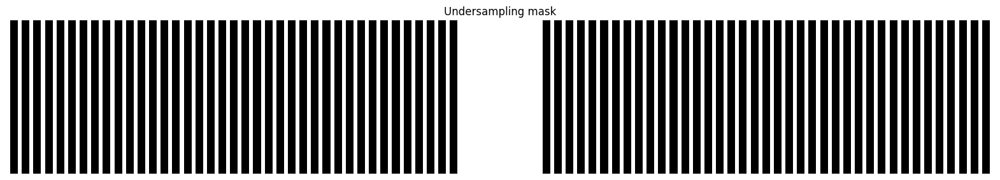

In [30]:
np.random.seed(1001)
sampling_mask = generate_mask(R=3, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='regular')

medutils.visualization.imshow(sampling_mask[:40,:,0], 'Undersampling mask', figsize=(20,20))

Next you can examine the impact of the undersampling masks on the reconstructed image

**Task 12:** Examine the impact of a `regular` undersampling on the image for changing acceleration factors.

Reff=2.56


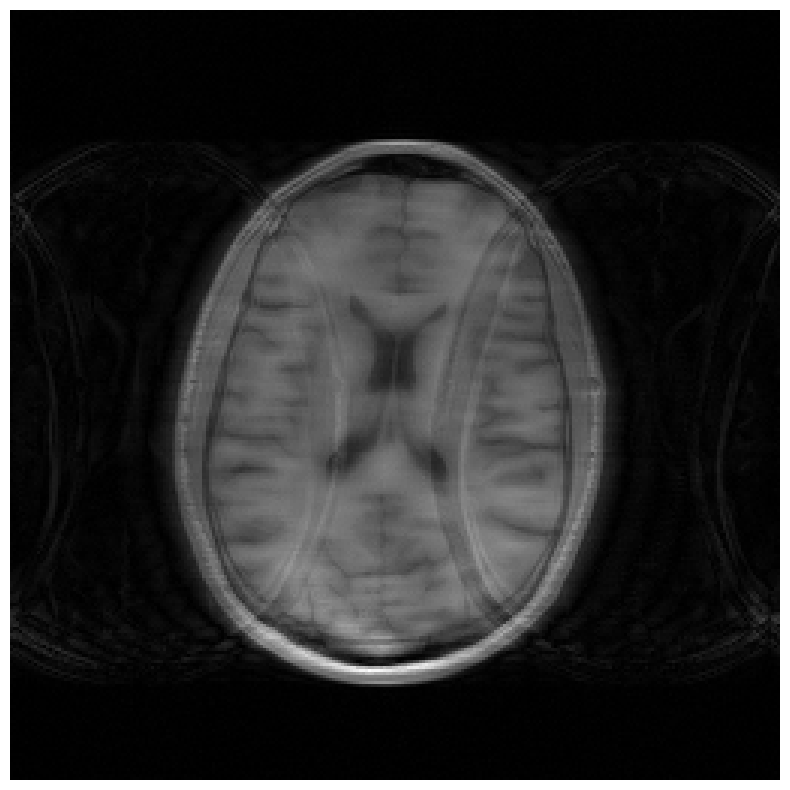

In [31]:
sampling_mask = generate_mask(R=3, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='regular')
img_cc_us = mriAdjointOp(kspace, sampling_mask, smaps)
plot(img_cc_us)

**Task 13:** Examine the impact of a `random` undersampling on the image for changing acceleration factors.

Reff=2.4854368932038833


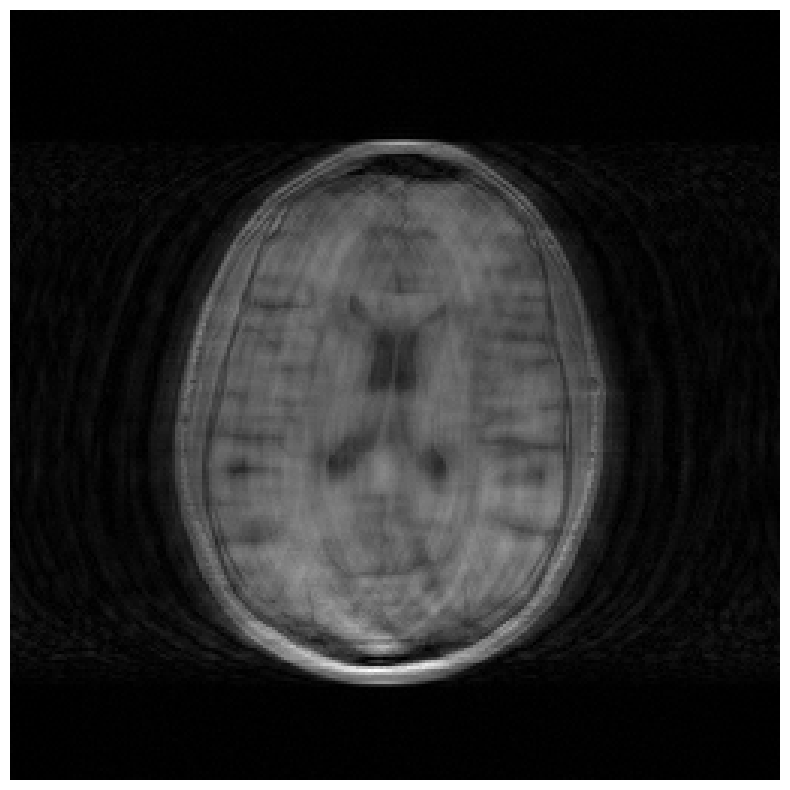

In [32]:
sampling_mask_r = generate_mask(R=3, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='random')
img_cc_us_r = mriAdjointOp(kspace, sampling_mask_r, smaps)
plot(img_cc_us_r)

Let us now combine accelerated imaging with the impact of motion.

**Task 14:** Induce motion in the `regular` undersampled data, assuming every 4-th phase-encoding line is affected by translational motion $t_x=10, t_y=5$. Plot the motion-free, fully-sampled motion-affected, and undersampled motion-affected image side-by-side.

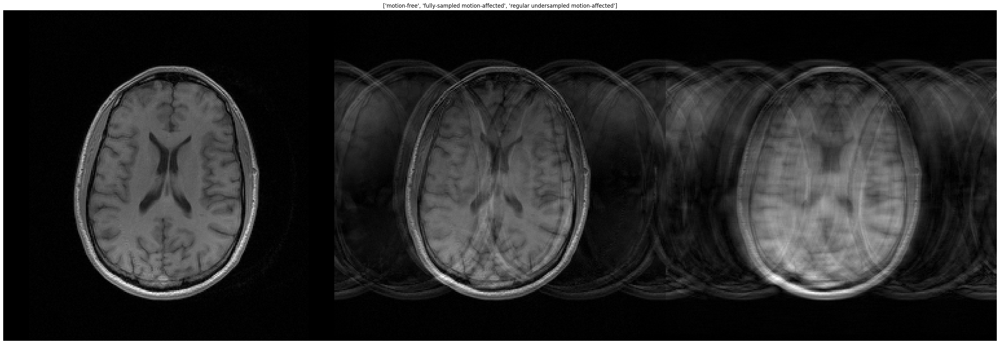

In [33]:
p = [10, 5, 0, 0, 1, 1]
mask_motion = np.zeros(np.shape(sampling_mask_fs)[1])
mask_motion[::4] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]

kspace_motion, mask_motion = simulate_motion(img_cc, smaps, sampling_mask, p)
img_us_motion = mriAdjointOp(kspace_motion, sampling_mask, smaps)
plot([img_cc, img_fs_const_motion, img_us_motion], title=['motion-free', 'fully-sampled motion-affected', 'regular undersampled motion-affected'])

**Task 15:** Induce motion in the `random` undersampled data, assuming every 4-th phase-encoding line is affected by translational motion $t_x=10, t_y=5$. Plot the motion-free, fully-sampled motion-affected, and undersampled motion-affected image side-by-side.

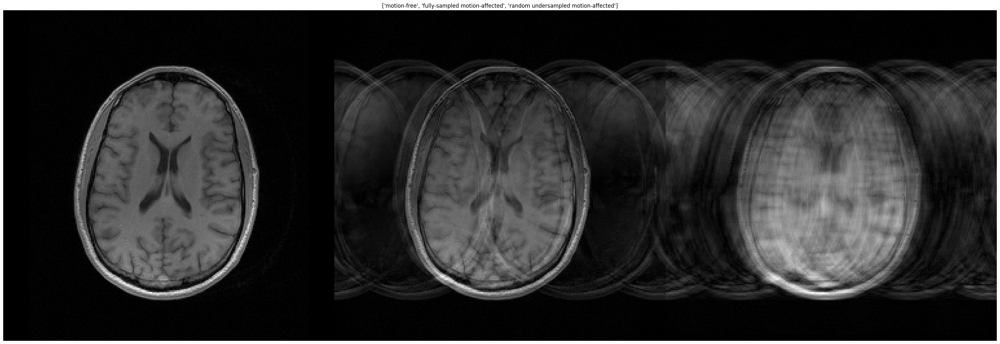

In [34]:
p = [10, 5, 0, 0, 1, 1]
mask_motion = np.zeros(np.shape(sampling_mask_fs)[1])
mask_motion[::4] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]

kspace_motion, mask_motion = simulate_motion(img_cc, smaps, sampling_mask_r, p)
img_us_r_motion = mriAdjointOp(kspace_motion, sampling_mask_r, smaps)
plot([img_cc, img_fs_const_motion, img_us_r_motion], title=['motion-free', 'fully-sampled motion-affected', 'random undersampled motion-affected'])

## Motion in radial imaging
Let's examine the impact of motion in radial imaging. We will therefore first need to radially sample the data. For reconstruction, we use the [gpuNUFFT](https://github.com/andyschwarzl/gpuNUFFT) package with the Python interface provided by [pySAP-mri](https://github.com/CEA-COSMIC/pysap-mri/). Alternatively, one could also use the [BART](https://mrirecon.github.io/bart/) toolbox.

For simplicity, we first zero-pad the image to a quadrativ field of view. Next, we recalculate the coil sensitivity maps.

In [35]:
import espirit

# getting the image into quadrativ FOV
#img_qfov = np.pad(img, ((0,), (int(np.abs(nX-nY)/2),), (0,)))
nRead = np.amax(np.shape(img)[0:2])
img_qfov = zpad(img, (nRead, nRead, np.shape(img)[2])).astype(np.complex64)
img_qfov = img_qfov[:,:,np.newaxis,:]
kspace_qfov = fft2c(img_qfov)

smaps_rad_espirit = espirit.espirit(kspace_qfov, 8, 20, 0.05, 0)
smaps_rad = smaps_rad_espirit[:,:,0,:,0]
img_qfov = np.squeeze(img_qfov)

In [36]:
nSamples = 256
nSpokes = 402
trajs = initialize_2D_radial(nSpokes, nSamples)
trajs = np.reshape(trajs, (-1, trajs.shape[-1]))
dcf = voronoi(trajs)
nufft = MRIfinufft(trajs, (nRead, nRead), n_coils=img_qfov.shape[-1], density=dcf)
kspace_rad = nufft.op(np.transpose(img_qfov, axes=(2,0,1)))
imgreco = nufft.adj_op(kspace_rad)
imgreco = np.transpose(imgreco, (1,2,0))


/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"
/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/finufft/_interfaces.py:329: UserWarning: Argument `data` does not satisfy the following requirement: C. Copying array (this may reduce performance)
  warnings.warn(f"Argument `{name}` does not satisfy the following requirement: {prop}. Copying array (this may reduce performance)")


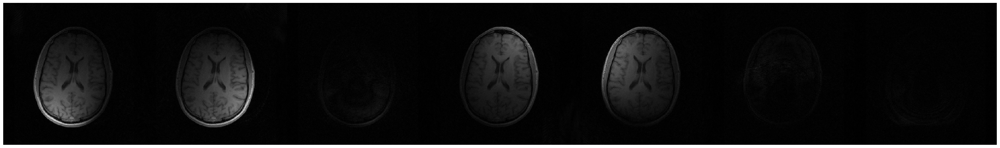

In [37]:
plot(np.squeeze(imgreco))

### Motion in fully-sampled and undersampled/accelerated imaging

**Task 16:** Define the non-uniform FFT (NUFFT) operator `NonCartesianFFT(samples, shape, n_coils, density_comp, smaps, implementation='gpuNUFFT')` using the [gpuNUFFT](https://github.com/andyschwarzl/gpuNUFFT) package and which requires the following inputs:
- `samples`: radial sampling trajectory (shape: `[nSpokes, 2]`)
- `shape`: (list) of quadrative field of view size: `[nRead, nRead]`
- `n_coils`: amount of MR coils
- `density_comp`: density compensation function (shape: `[nSpokes, 1]`)
- `smaps`: coil sensitivity maps (shape: `[coils, nRead, nRead]`)

Plot the radially sampled image.

*Hint:* You can use the function `prepare_radial()` in `utils/radialsampling.py` to obtain the radial sampling trajectory and the density compensation function:

```
def prepare_radial(acc, nRead, nSlices=1):
"""
acc:         acceleration factor
nRead:       number of readout steps
nSlices:     number of slices
:return:     radial trajectory, density compensation function
"""
```

/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"


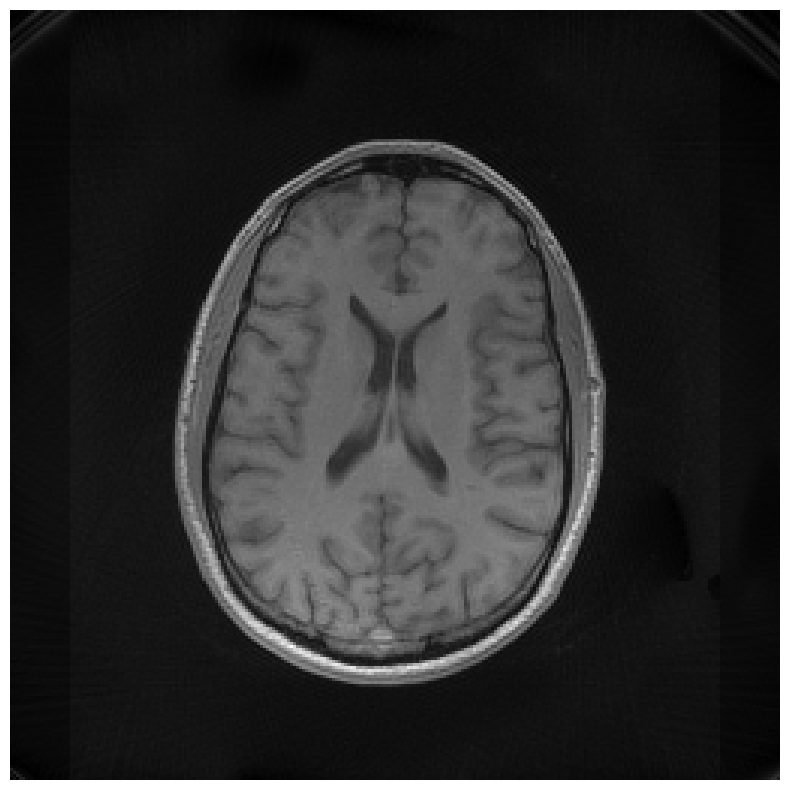

In [38]:
img_rad = rss(img_qfov)
csm = np.transpose(smaps_rad, (2, 0, 1))
kpos, dcf = prepare_radial(acc=1, nRead=nRead)

# NUFFT operator
nufft = MRIfinufft(kpos, (nRead, nRead), n_coils=img_qfov.shape[-1], density=dcf.reshape((-1)), smaps=csm)
kspace_radial = nufft.op(img_rad)
img_radial = nufft.adj_op(kspace_radial)
plot(img_radial)

**Task 17:** Perform a retrospectively accelerated radial imaging with various acceleration factors and plot the image.

/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"


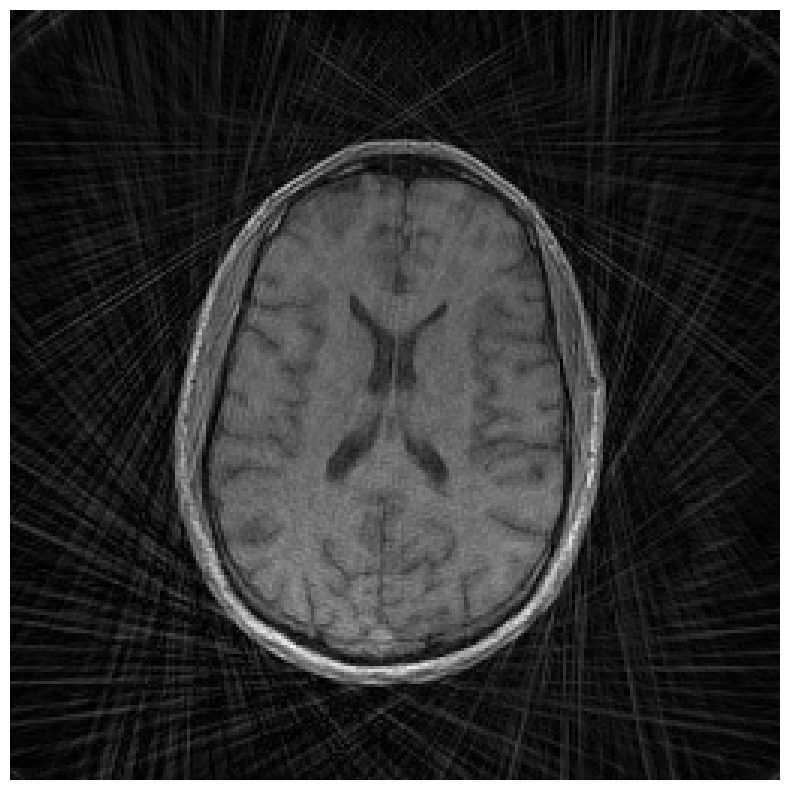

In [39]:
kpos, dcf = prepare_radial(acc=8, nRead=nRead)

# NUFFT operator
nufft = MRIfinufft(kpos, (nRead, nRead), n_coils=img_qfov.shape[-1], density=dcf.reshape((-1)), smaps=csm)
kspace_radial = nufft.op(img_rad)
img_radial_acc = nufft.adj_op(kspace_radial)
plot(img_radial_acc)

**Task 18:** Similar to the Cartesian function `simulate_motion()` in `utils/motionsim.py` create a function that simulates the motion on a radially sampled k-space.

```
def simulate_motion_radial(img_rad, smaps, mask, dcf, p):
    # img_cc      motion-free coil-combined image (quadrativ FOV)
    # smaps       coil sensitivity maps: [nCoils, nRead, nRead]
    # mask        radial sampling mask
    # dcf         density compensation function
    # p           a) affine motion parameters (constant over time), 1x6
    #             b) affine motion course (time-dependent or time-constant), nPE x 6
    #             np.abs(p[:, :5]) > 0 = mask_motion; time points of phase-encoding steps
    #             at which motion parameters > 0 are defined, i.e. motion is happening

    nRead = np.shape(img_rad)[0]
    nufft = MRIfinufft(mask, (nRead, nRead), n_coils=np.shape(smaps)[0], density=dcf, smaps=smaps)
    # nufft = NonCartesianFFT(samples=mask, shape=[nRead, nRead], n_coils=np.shape(smaps)[0], density_comp=dcf, smaps=smaps, implementation='gpuNUFFT')
    kspace = nufft.op(img_rad)
    p = np.asarray(p)
    tmp = np.unique(p, axis=0)
    if len(np.shape(p)) == 1:
        mask_motion = np.ones_like(kspace)
    else:
        mask_motion = np.abs(np.sum(p[:, :5], axis=1)) > 0
        mask_motion = np.tile(mask_motion[np.newaxis, :], (np.shape(kspace)[0], 1))

    if len(np.shape(p)) == 1 or np.shape(tmp[~np.all(tmp == 0, axis=1)])[0] == 1:  # constant motion over time
        if len(np.shape(p)) != 1:
            p = np.squeeze(tmp[~np.all(tmp == 0, axis=1)])
        kspace_motion = nufft.op(transform_img(img_rad, p))
        return kspace * ( 1 -mask_motion) + kspace_motion * mask_motion, mask_motion
    else:  # time-dependent motion
        kspace_aff = np.zeros_like(kspace)
        for ky in np.arange(np.shape(img_rad)[1]):
            kspace_aff[:, ky, :] = nufft.op(transform_img(img_rad, p[ky, :]))[:, ky, :]
        return kspace_aff, mask_motion
```

**Task 19:** Simulate that every 4-th k-space radial readout is affected by a translational motion with $t_x=10, t_y=5$ for a fully-sampled acquisition (`acc=1`). Plot the motion-free and the motion-affected image.

/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"
/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"


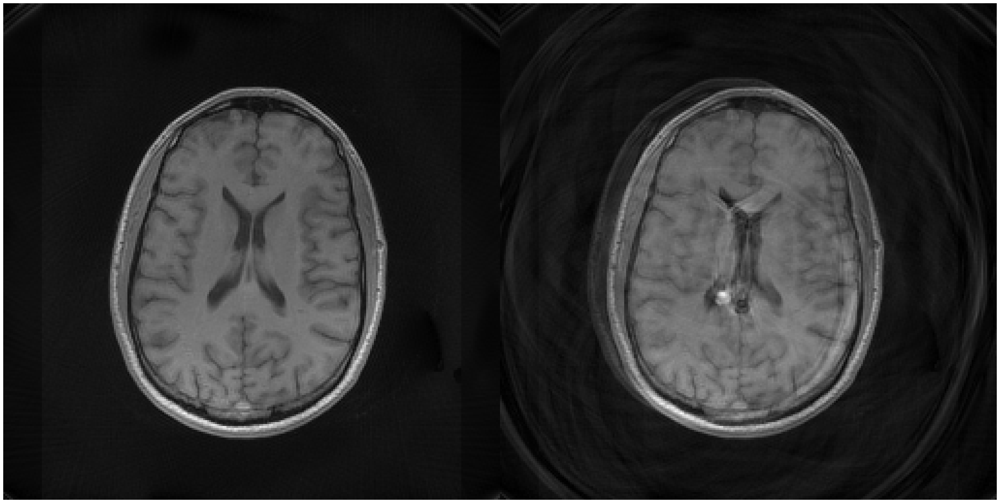

In [40]:
p = [10, 5, 0, 0, 1, 1]
kpos, dcf = prepare_radial(acc=1, nRead=nRead)

mask_motion = np.zeros(np.shape(kpos)[0])
mask_motion[::4] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]

nufft = MRIfinufft(kpos, (nRead, nRead), n_coils=np.shape(csm)[0], density=dcf.reshape((-1)), smaps=csm)
kspace_rad_motion, mask_rad_motion = simulate_motion_radial(img_rad, csm, kpos, dcf, p)
img_rad_motion = nufft.adj_op(kspace_rad_motion)
plot([img_radial, img_rad_motion])


**Task 20:** Plot and compare the fully-sampled (Cartesian/non-Cartesian), fully-sampled motion-affected Cartesian and fully-sampled motion-affected non-Cartesian (radial) images. Which one is less sensitive to motion?

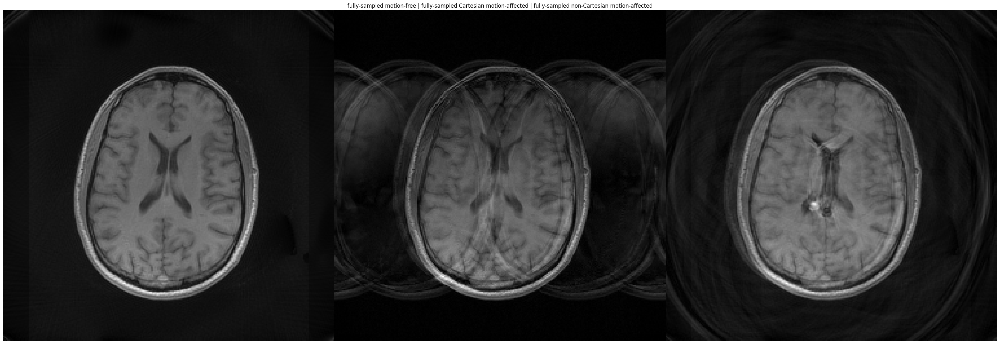

In [41]:
plot([img_radial, img_fs_const_motion, img_rad_motion], title='fully-sampled motion-free | fully-sampled Cartesian motion-affected | fully-sampled non-Cartesian motion-affected')

**Task 21:** Simulate that every 4-th k-space radial readout is affected by a translational motion with $t_x=10, t_y=5$ for an accelerated acquisition (`acc=8`). Plot the motion-free and the motion-affected image.

/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"
/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"


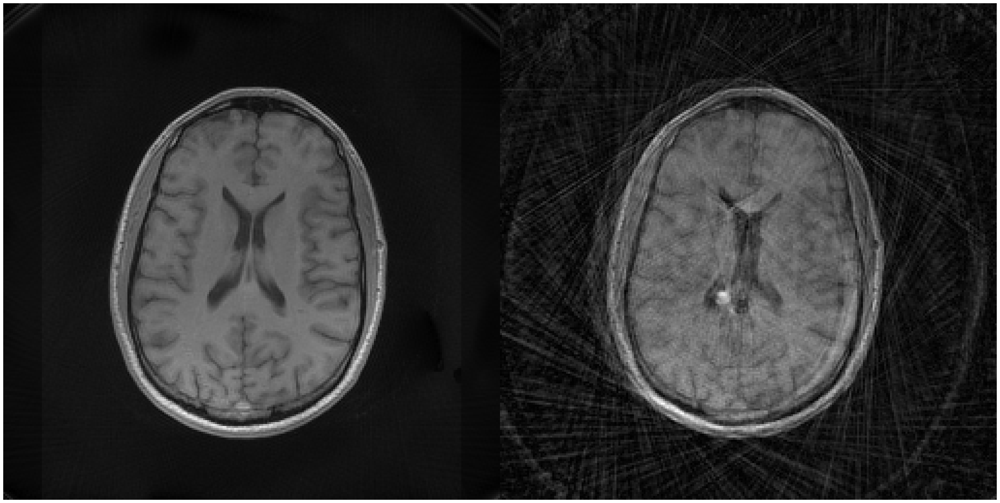

In [42]:
p = [10, 5, 0, 0, 1, 1]
kpos, dcf = prepare_radial(acc=8, nRead=nRead)

mask_motion = np.zeros(np.shape(kpos)[0])
mask_motion[::4] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]


nufft = MRIfinufft(kpos, (nRead, nRead), n_coils=np.shape(csm)[0], density=dcf.reshape((-1)), smaps=csm)
kspace_rad_acc_motion, mask_rad_acc_motion = simulate_motion_radial(img_rad, csm, kpos, dcf, p)
img_rad_acc_motion = nufft.adj_op(kspace_rad_acc_motion)
plot([img_radial, img_rad_acc_motion])

**Task 22:** Repeat the above examples for varying affine motion parameters $p$, motion courses (constant or changing over time), motion time points ($n$-th readout) and acceleration factors of the radial undersampling. Plot and compare the images.

/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"
/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"
/home/swolf/miniconda3/envs/test/lib/python3.8/site-packages/mrinufft/_utils.py:87: UserWarning: Samples will be rescaled to [-pi, pi), assuming they were in [-0.5, 0.5)
  "trajectory should be array_like, with the last dimension being coordinates"


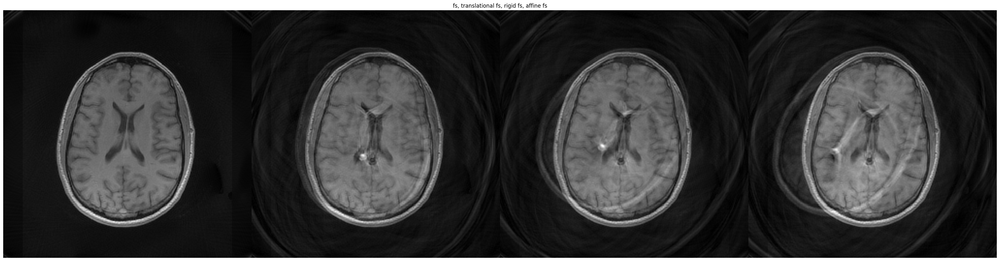

In [43]:
p = [10, 5, 30, 0, 1, 1]
kpos, dcf = prepare_radial(acc=1, nRead=nRead)

mask_motion = np.zeros(np.shape(kpos)[0])
mask_motion[::4] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]

nufft = MRIfinufft(kpos, (nRead, nRead), n_coils=np.shape(csm)[0], density=dcf.reshape((-1)), smaps=csm)
kspace_rad_rigid_motion, _ = simulate_motion_radial(img_rad, csm, kpos, dcf, p)
img_rad_rigid_motion = nufft.adj_op(kspace_rad_rigid_motion)

p = [10, 5, 20, 0.1, 1, 1]
mask_motion = np.zeros(np.shape(kpos)[0])
mask_motion[::4] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]
kspace_rad_affine_motion, _ = simulate_motion_radial(img_rad, csm, kpos, dcf, p)
img_rad_affine_motion = nufft.adj_op(kspace_rad_affine_motion)

plot([img_radial, img_rad_motion, img_rad_rigid_motion, img_rad_affine_motion], title='fs, translational fs, rigid fs, affine fs')

# 2. Motion estimation / image registration
<a name="MotionEstimation"></a>
In this part we will learn about algorithms to register and estimate the motion. We will illustrate conventional (optical flow, B-Spline) and deep-learning methods for this.

In this part of the tutorial we will have a closer look at image registration using conventional and deep learning-based solutions. We will only focus on pairwise registrations, i.e. registering a moving image $\rho_m(r)$ to a fixed image $\rho_f(r)$. The fixed and moving image are of dimension $N$ and are each defined on their own spatial domain: $\Omega_f \subset \mathbb{R}^N$ and $\Omega_m \subset \mathbb{R}^N$. The task of registration is to find a displacement $u(r)$ that makes $\rho_m(r+u(r))$ spatially aligned to $\rho_f(r)$. Equivalently we can say that registration is the process to find the transformation/displacement $T(r) = r+u(r)$ that makes $\rho_m(T(r))$ spatially aligned to $\rho_f(x)$. The transformation is defined as a mapping from the fixed image to the moving image, i.e. $T: \Omega_f \subset \mathbb{R}^N \to \Omega_m \subset \mathbb{R}^N$. The flow/displacement/motion field $u(x)$ contains the flows in the respective directions $u(r) = [u_x(r), u_y(r), \dots]$.

This transformation $T$, respectively its flow/displacement/motion field $u$ is also known as the *forward* motion $u^{(F)}$ (for simplicity we will refer to the forward motion field as $u$). Consequently, we also have a *backward* motion $u^{(B)}$. Ideally, the forward and backward motion should be isomorph, i.e. $u(u^{(B)}(r)) = r$ which allows to obtain either of the flows from the other one. For some cases, it might also be beneficial if the flows are diffeomorph, i.e. forward and backward motion are continously differentiable. During optimization, we are actually solving for the backward motion and later invert this flow to obtain the forward motion. This is usally more numerically stable as we expect that there is a matching voxel in the fixed image to which we can morph the moving image's voxel.   

The main properties of a registration algorithm are:
- dimensionality: 2D to 2D, 2D to 3D, 3D to 3D, ...
- spatial motion: rigid, affine, elastic (non-rigid)
- input modality: mono-modal, multi-modal
- similarity measure: landmark-based, image-intensity based
- cost function: mean-squared-error, mutual information, cross-correlation, ...
- regularization: pyramidal resolution, smoothness or energy constraints, Jacobian constraints, isomorph or diffeomorph constraints, ...
- algorithm: optical flow, diffusion-based, splines (B-splines, thin-plate splines, ...), deep learning, ...

## Conventional image registration
For the conventional image registration methods, we will have a look at the differences between optical flow and B-Spline based registrations, as these methods are the most commonly used ones. Moreover, deep learning-based registrations are often motivated or based on optical flow methods.

### Optical Flow
We will first examine an optical flow-based image registration. Therefore we create a pair of motion-free and motion-affected image.

**Task 23:** Create a pair of motion-free (fixed) and moving image using `transform_img()` and `plot()` them side-by-side.

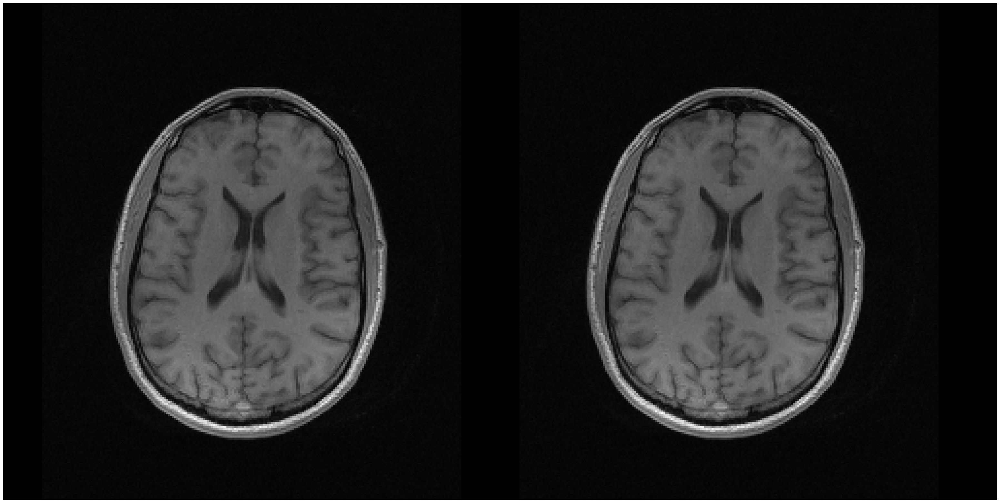

In [44]:
img_fixed = rss(img)
p = [10, 0, 0, 0, 1, 1]
#p = [4, 8, 10, 0.05, 1, 1]
img_moving = transform_img(img_fixed, p)
img_fixed = minmaxscale(img_fixed, [0, 1])
img_moving = minmaxscale(img_moving, [0, 1])
plot([img_fixed, img_moving])

**Task 24:** Let us define the optical flow registration using the scikit-image (or any other library of your liking) for the Lucas-Kanade algorithm.

*Hint:* Check the orientation of the flow for the $x$ and $y$ component, i.e. verify the displacement for a translational motion (`[10, 0, 0, 0, 0, 0]`) in $x$ direction first.

In [45]:
from skimage.registration import optical_flow_ilk
uy, ux = optical_flow_ilk(img_fixed, img_moving)

**Task 25**: First stack the $x$ and $y$ components of the flow $u_x$, $u_y$ along the last dimension to obtain a flow field $u$ of shape $X \times Y \times 2$. Plot the obtained deformation field as quiver and color-plots using `plot` (in `utils/imageplotting.py`) and `plot_flow` (in `utils/flowplotting.py`), respectively.

For displaying the flow fields, we can show them as a quiver plot (vector field overlaid to image) using `plot([image1, image2], [flow_of_image1, flow_of_image2])` or as a color-encoded image (color depicts flow angle $\arg u$ and hue depicts magnitude $|u|$) using `plot_flow(flow)`.

The color-coded image has the following intepretation: <br/>
![](https://github.com/lab-midas/ismrm-moco-workshop/blob/master/doc/colorwheel.png?raw=true)

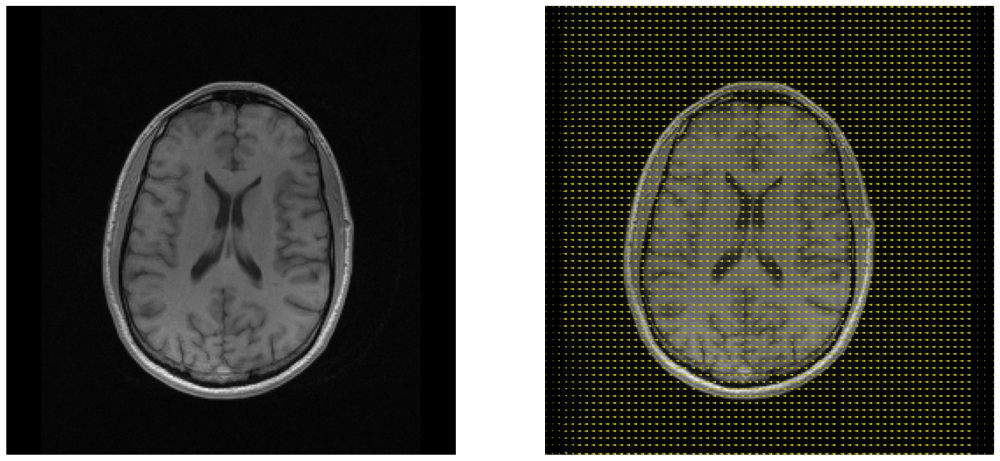

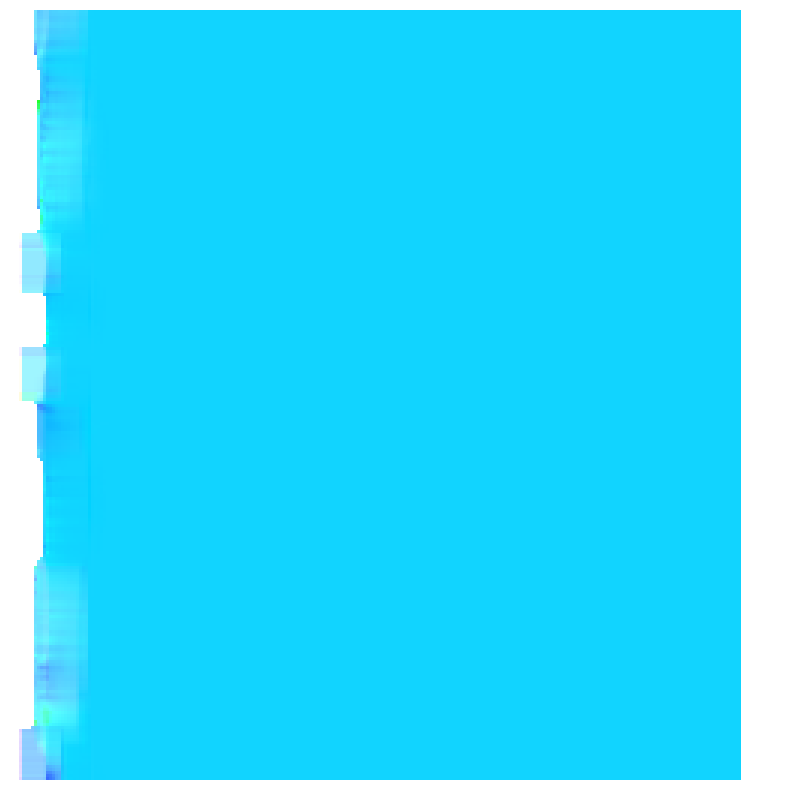

In [46]:
flows = np.stack([ux, uy], -1)

# quiver plots
plot([img_fixed, img_moving], [np.zeros_like(flows), flows], scale=5, figsize=(20,20))

# color-wheel plot
plot_flow(flows)

**Task 26:** Inspect and display the deformed/warped image using `warp_2D()` in `utils/warping.py`.

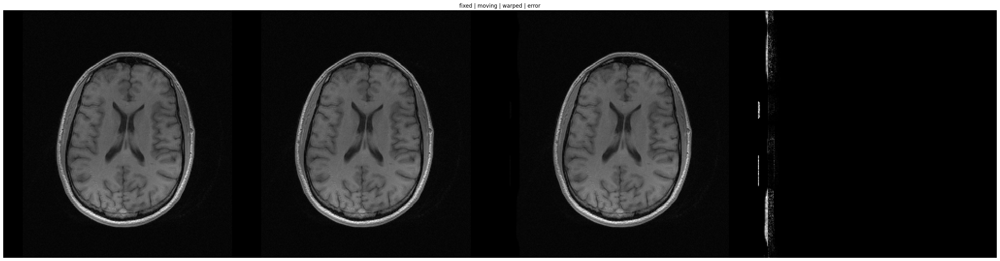

In [47]:
img_warped = warp_2D(img_moving, np.stack([ux, uy], -1))
plot([img_fixed, img_moving, img_warped, np.abs(img_warped-img_fixed)], title='fixed | moving | warped | error')

**Task 27:** Perform the registration using the Total-variation L1-regularized optical flow algorithm.

In [48]:
from skimage.registration import optical_flow_tvl1
uy, ux = optical_flow_tvl1(img_fixed, img_moving)

**Task 28:** Repeat the **Tasks 25** and **26** with the TV L1-regularized optical flow from **Task 27**.

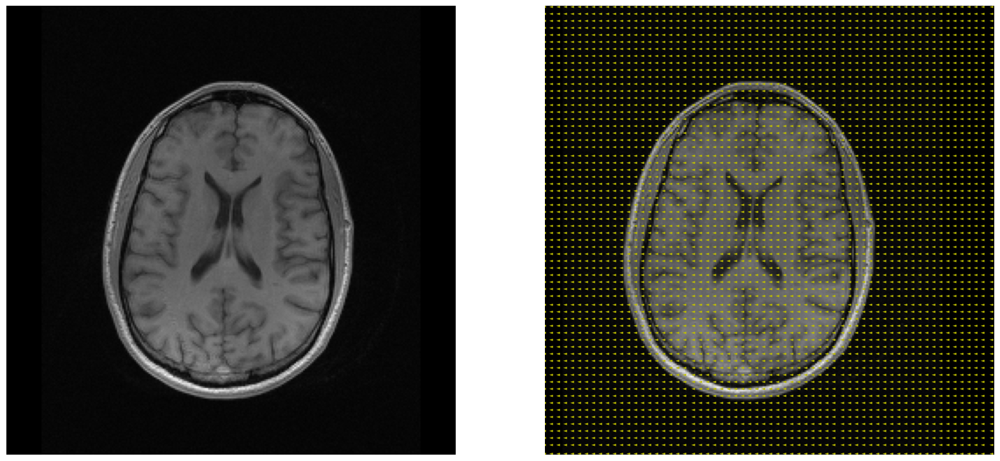

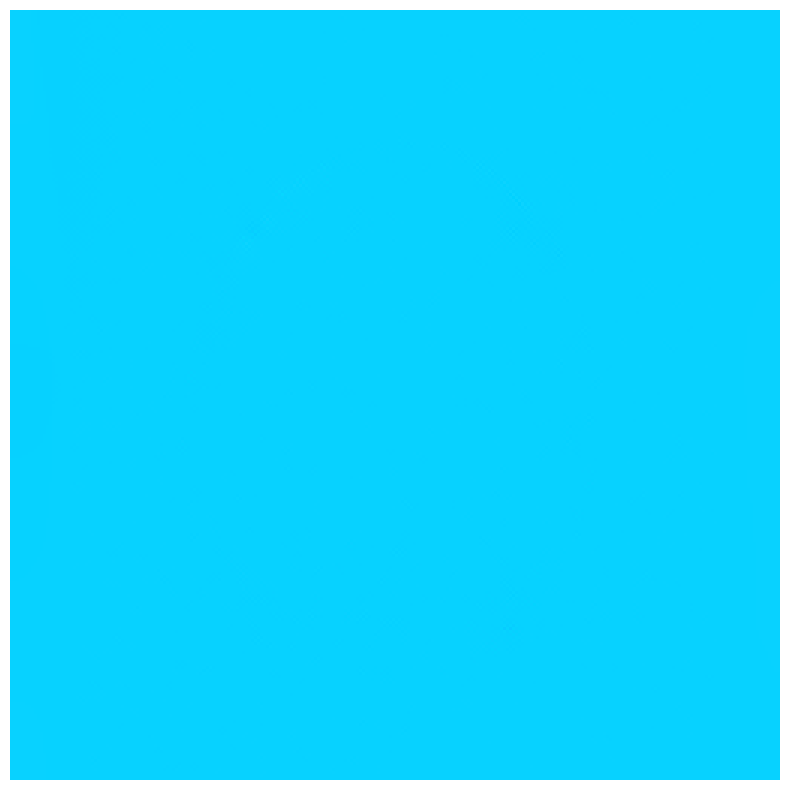

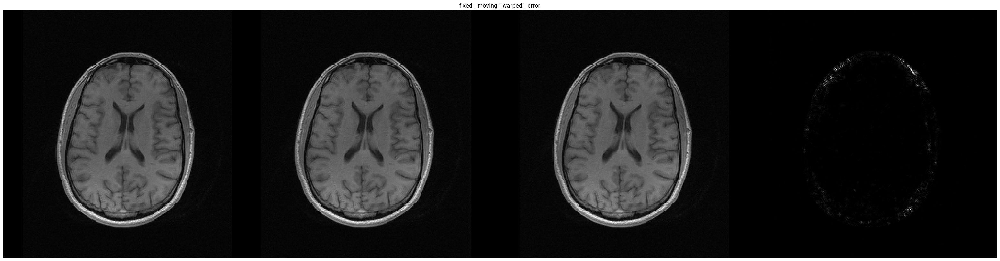

In [49]:
flows = np.stack([ux, uy], -1)

# quiver plots
plot([img_fixed, img_moving], [np.zeros_like(flows), flows], scale=5, figsize=(20,20))

# color-wheel plot
plot_flow(flows)

img_warped = warp_2D(img_moving, np.stack([ux, uy], -1))
plot([img_fixed, img_moving, img_warped, np.abs(img_warped-img_fixed)], title='fixed | moving | warped | error')

**Task 29:** Evaluate the obtained registration performance in the warped image (i.e. warped to fixed image) and compare against before registration (i.e. moving to fixed image). Compute the photometric loss = $\sum (\rho_\text{warped} - \rho_f)^2$, structural similarity (SSIM) and peak signal to noise ratio (PSNR).

In [50]:
from skimage.metrics import structural_similarity, peak_signal_noise_ratio, mean_squared_error

photo = mean_squared_error(img_fixed, img_warped)
ssim = structural_similarity(img_fixed, img_warped, data_range=img_fixed.max() - img_fixed.min())
psnr = peak_signal_noise_ratio(img_fixed, img_warped)

print('Warped to fixed image')
print(f'Photometric: {photo}')
print(f'SSIM: {ssim}')
print(f'PSNR: {psnr}')

photo_m = mean_squared_error(img_moving, img_warped)
ssim_m = structural_similarity(img_moving, img_warped, data_range=img_fixed.max() - img_fixed.min())
psnr_m = peak_signal_noise_ratio(img_moving, img_warped)

print('\nMoving to fixed image')
print(f'Photometric: {photo_m}')
print(f'SSIM: {ssim_m}')
print(f'PSNR: {psnr_m}')

Warped to fixed image
Photometric: 2.678202039426979e-06
SSIM: 0.9999342065057755
PSNR: 55.72156663582963

Moving to fixed image
Photometric: 0.01525521987688572
SSIM: 0.5550225177028347
PSNR: 18.16581528393256


**Task 30:** Now we evaluate the performance of the registration on the obtained motion/displacement field. Calculate
- the determinant of the Jacobian of the transformation <br/>
$\text{Jac} = \operatorname{det}(\nabla T(r)) = \left| \begin{bmatrix} \frac{\partial u_x}{\partial x} + 1 & \frac{\partial u_x}{\partial y} \\ \frac{\partial u_y}{\partial x} & \frac{\partial u_y}{\partial y} + 1 \end{bmatrix} \right|$
- the divergence of the displacement field <br/>
$\operatorname{div}(u) = \nabla \cdot u = \frac{\partial u_x}{\partial x} + \frac{\partial u_y}{\partial y}$
- absolute displacement field change in selected direction $p=\lbrace x,y \rbrace$ <br/>
$| \nabla u | = \sqrt{ \left(\frac{\partial u_x}{\partial p}\right)^2 + \left(\frac{\partial u_y}{\partial p}\right)^2}$

and plot the obtained metrics.

*Optional:* You may also try to implement these functions with SimpleITK ([1](https://itk.org/Doxygen/html/classitk_1_1DisplacementFieldJacobianDeterminantFilter.html), [2](https://simpleitk.org/doxygen/latest/html/classitk_1_1simple_1_1GradientImageFilter.html)).

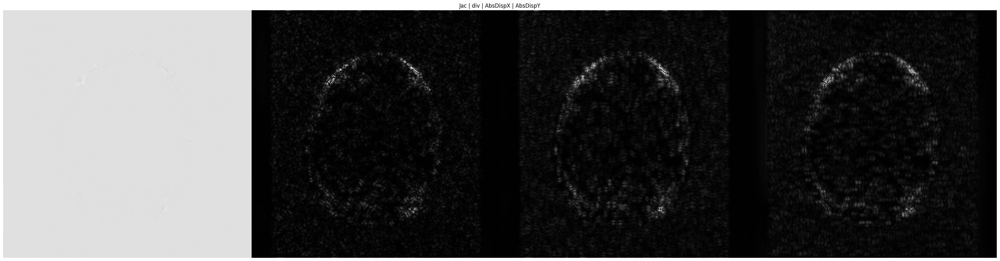

In [51]:
# direct
uxdx = np.gradient(ux, axis=0)
uxdy = np.gradient(ux, axis=1)
uydx = np.gradient(uy, axis=0)
uydy = np.gradient(uy, axis=1)

jac = (uxdx+1)*(uydy+1) - uxdy*uydx
div = uxdx + uydy
absdisp_x = np.sqrt(np.power(uxdx, 2) + np.power(uydx, 2))
absdisp_y = np.sqrt(np.power(uxdy, 2) + np.power(uydy, 2))

plot([jac, div, absdisp_x, absdisp_y], title='Jac | div | AbsDispX | AbsDispY')

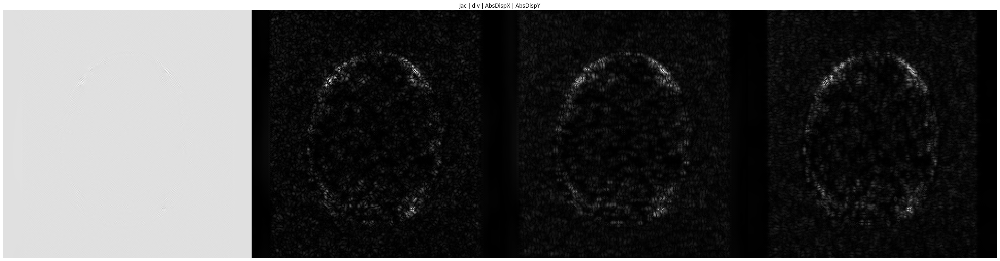

In [52]:
# SimpleITK
flows = np.stack([ux, uy], -1)
sitk_displacement_field = sitk.GetImageFromArray(flows, isVector=True)
jacobian_det_volume = sitk.DisplacementFieldJacobianDeterminant(sitk_displacement_field)
jac = sitk.GetArrayViewFromImage(jacobian_det_volume)
sitk_ux = sitk.GetImageFromArray(ux) # , isVector=True)
sitk_uy = sitk.GetImageFromArray(uy) # , isVector=True)
filter = sitk.GradientImageFilter()
#filter.SetUseImageDirection(True)
uxd = filter.Execute(sitk_ux)
uyd = filter.Execute(sitk_uy)
uxd_np = sitk.GetArrayViewFromImage(uxd)
uyd_np = sitk.GetArrayViewFromImage(uyd)
div = uxd_np[..., 0] + uyd_np[..., 1]
absdisp_x = np.sqrt(np.power(uxd_np[..., 0], 2) + np.power(uyd_np[..., 0], 2))
absdisp_y = np.sqrt(np.power(uxd_np[..., 1], 2) + np.power(uyd_np[..., 1], 2))

plot([jac, div, absdisp_x, absdisp_y], title='Jac | div | AbsDispX | AbsDispY')

Depending on your simulated motion you can identify with these metrics, directional changes or contraction/expansion of the moved tissues.

**Task 31:** Invert the flow fields by changing the registration direction (i.e. swapping moving and fixed image) and compare against direct inversion.

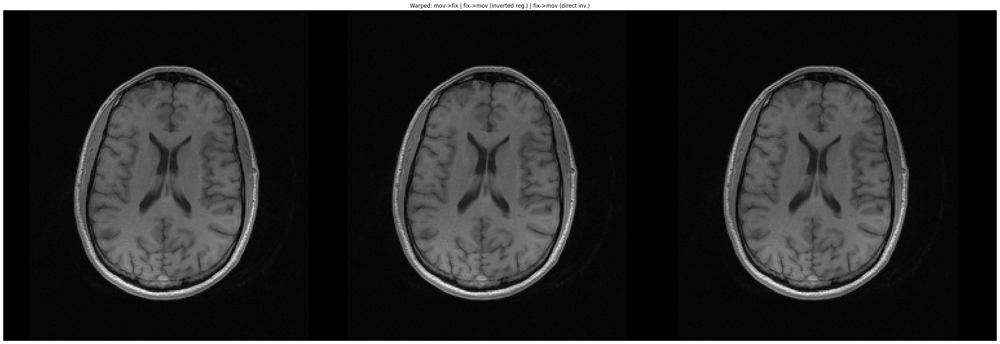

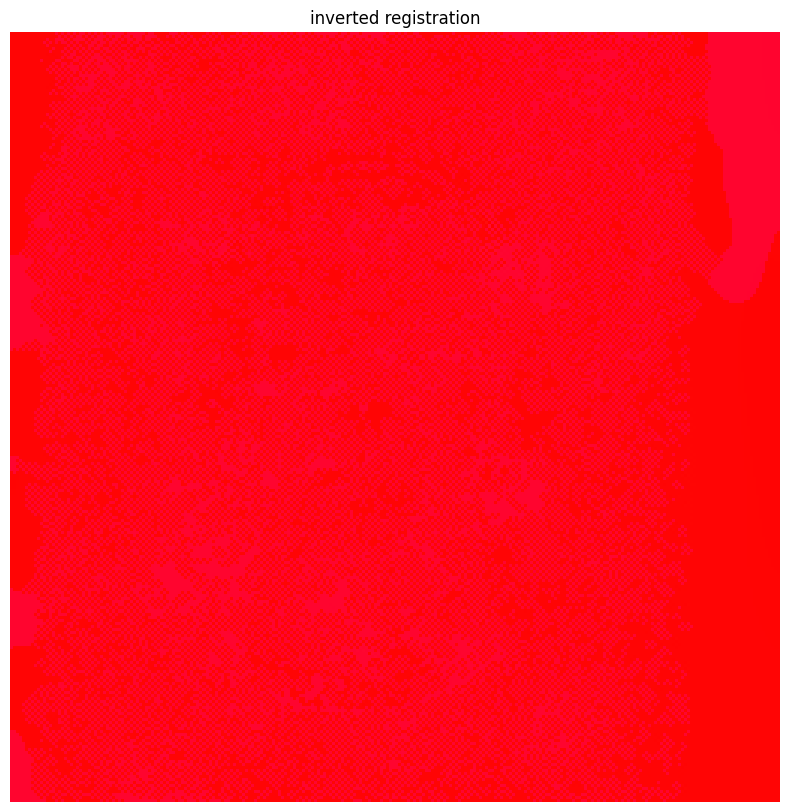

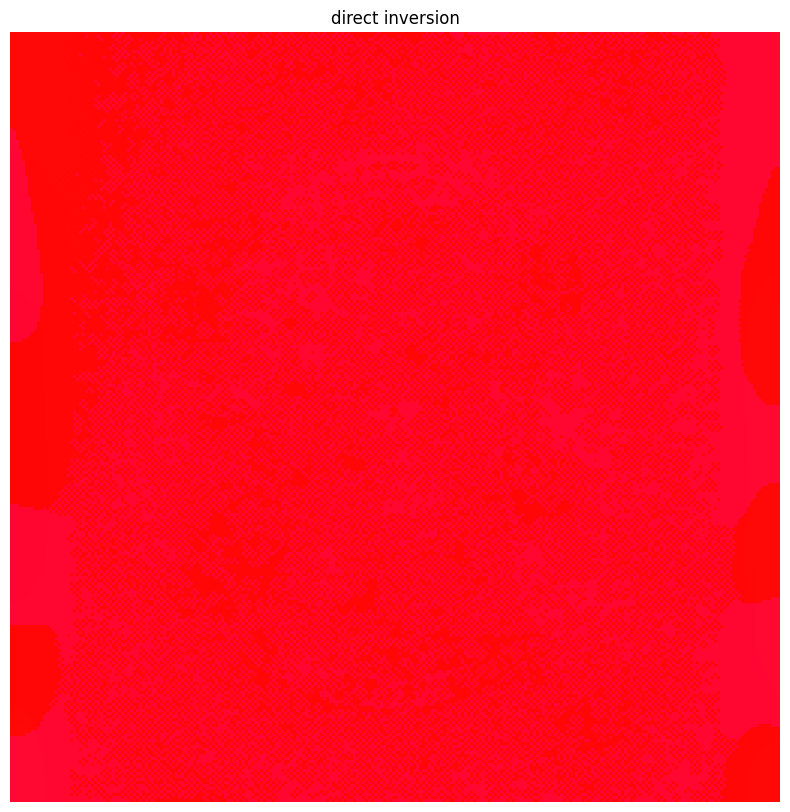

In [53]:
# redo registration
uBy, uBx = optical_flow_tvl1(img_moving, img_fixed)
img_warped_B = warp_2D(img_fixed, np.stack([uBx, uBy], -1))

# direct inversion
uBx_direct = -ux
uBy_direct = -uy
img_warped_B_direct = warp_2D(img_fixed, np.stack([uBx_direct, uBy_direct], -1))

# plot the results
plot([img_warped, img_warped_B, img_warped_B_direct], title='Warped: mov->fix | fix->mov (inverted reg.) | fix->mov (direct inv.)')

# plot the flow fields
plot_flow([uBx, uBy], 'inverted registration')
plot_flow([uBx_direct, uBy_direct], 'direct inversion')

**Task 32:** Calculate the:
- end-point-error (EPE): $\text{EPE} = \|u^{(F)} - u^{(B)}\|_2 = \sqrt{|u_x^{(F)}-u_x^{(B)}|^2 + |u_y^{(F)}-u_y^{(B)}|^2}$
- end-angulation-error (EAE): $\text{EAE} = \arg(u^{(F)}, u^{(B)})$

between the backward flow fields (direct inversion or inverse registration) and the forward flow fields. Plot the EPE and EAE as flow fields: $\text{EPE} \cdot \exp{(1i \cdot \text{EAE})}$ to have a color-coded error map (using `plot_flow()`).

*Note:* EPE and EAE can be calculated between any two flows to investigate their similarity/dissimilarity.

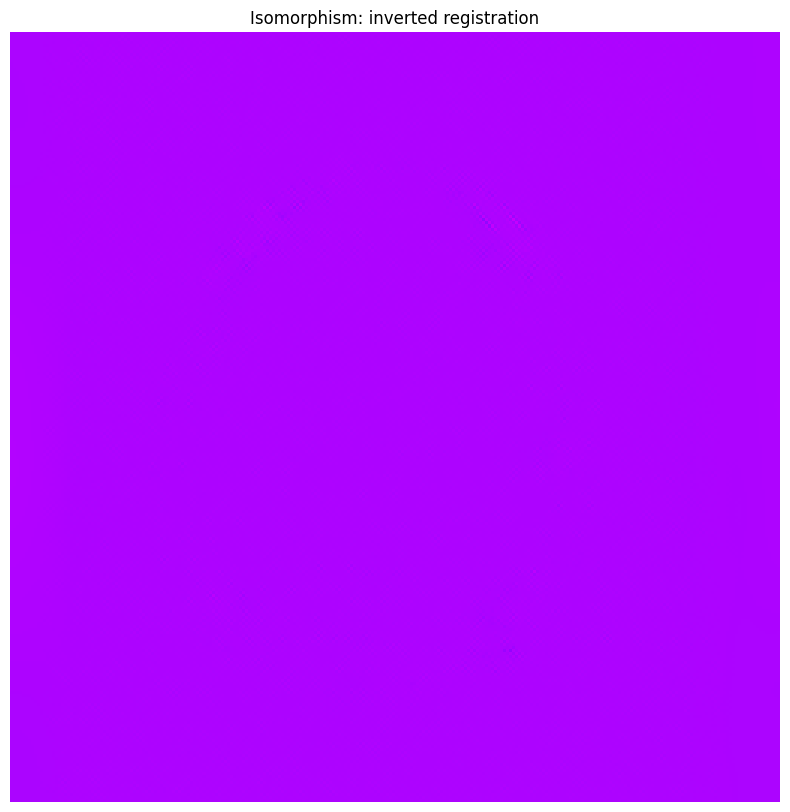

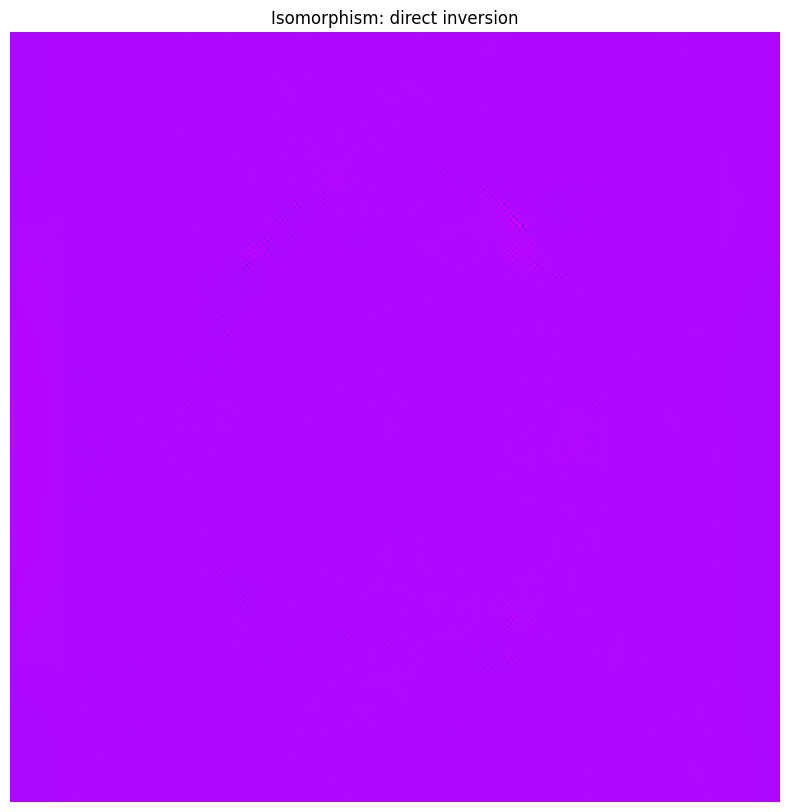

In [54]:
flow = np.stack([ux, uy], -1)
flowB = np.stack([uBx, uBy], -1)
flowB_direct = np.stack([uBx_direct, uBy_direct], -1)

def epe(flow1, flow2):
  return np.sqrt(np.sum(np.power(np.abs(flow1 - flow2),2), axis=-1))

def eae(flow1, flow2):
  return np.real(np.arccos((1 + np.sum(flow1 * flow2, axis=-1)) / (np.sqrt(1 + np.sum(np.power(flow1, 2), axis=-1)) * np.sqrt(1 + np.sum(np.power(flow2, 2), axis=-1))))) * 180 / np.pi

EPE = epe(flowB, flow)
EPE_direct = epe(flowB_direct, flow)

EAE = eae(flowB, flow)
EAE_direct = eae(flowB_direct, flow)

#plot([EPE, EAE], title='inverted registration: EPE | EAE')
#plot([EPE_direct, EAE_direct], title='direct inversion: EPE | EAE')
flowtest = EPE * np.exp(1j * EAE)
testx = np.real(flowtest)
testy = np.imag(flowtest)
plot_flow(np.stack([testx, testy], -1), title='Isomorphism: inverted registration')
flowtest = EPE_direct * np.exp(1j * EAE_direct)
testx = np.real(flowtest)
testy = np.imag(flowtest)
plot_flow(np.stack([testx, testy], -1), title='Isomorphism: direct inversion')

**Task 33:** Check if the flows are isomorph by warping a random image. Plot the respective errors for the backward flows (inverse registration and direct inversion).

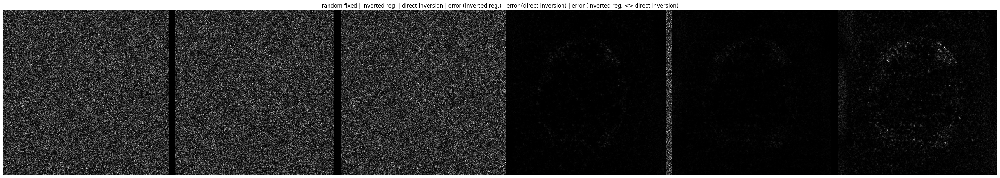

In [55]:
tmp = np.random.normal(size=np.shape(img_fixed))
iso = warp_2D(warp_2D(tmp, np.stack([uBx, uBy], -1)), np.stack([ux, uy], -1))

iso_direct = warp_2D(warp_2D(tmp, np.stack([uBx_direct, uBy_direct], -1)), np.stack([ux, uy], -1))

plot([tmp, iso, iso_direct, np.abs(tmp-iso), np.abs(tmp-iso_direct), np.abs(iso-iso_direct)], title='random fixed | inverted reg. | direct inversion | error (inverted reg.) | error (direct inversion) | error (inverted reg. <> direct inversion)')

Alternatively for an affine motion, we can also analytically calculate the motion field from the affine motion matrix. We provide the function `get_transform()` to return the flow fields:

```
def get_transform(img, p):
    # img      input image to be transformed
    # p        affine transformation parameters
    #          3D (rank(img) == 3): t_x, t_y, t_z, \phi [°], \theta [°], \psi [°], G_{xy}, G_{xz}, G_{yz}, S_x, S_y, S_z
    #          2D (rank(img) == 2): t_x, t_y, \phi [°], G_{xy}, S_x, S_y
    # return   deformation field
```

**Task 34:** You may rerun the previous tasks using the analytically derived motion field and compare it against the one obtained from registration.

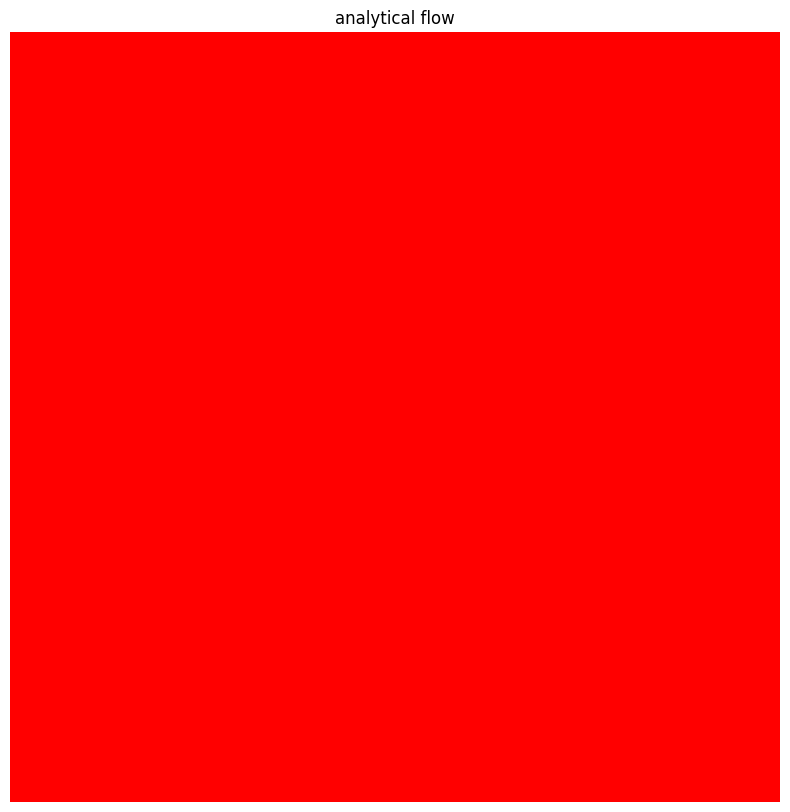

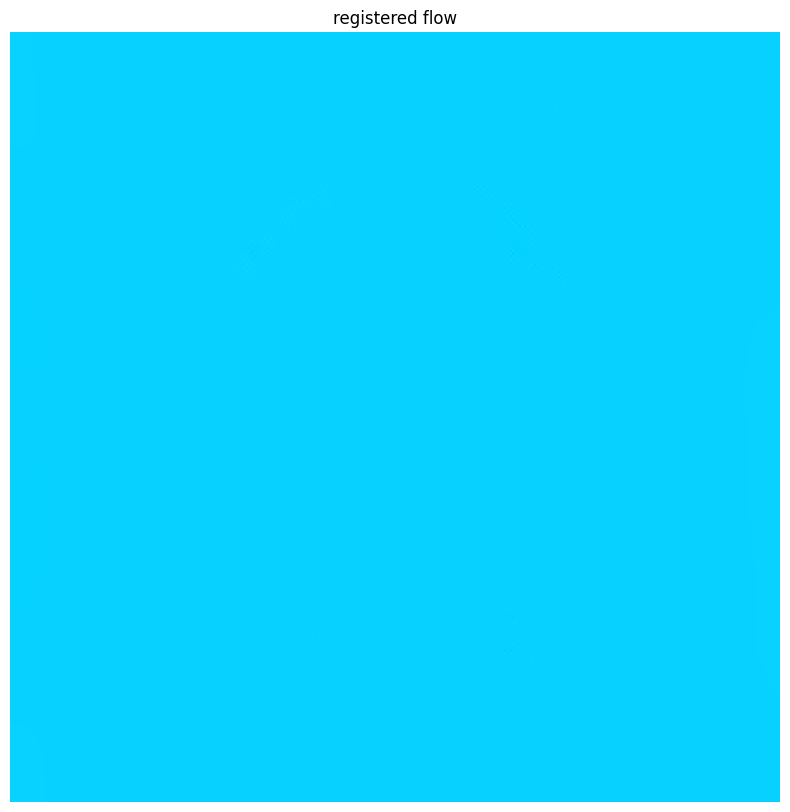

In [56]:
flow_ana = get_transform(img_rad, p)
flow_reg = np.stack([ux, uy], -1)

EPE = epe(flow_ana, flow_reg)
EAE = eae(flow_ana, flow_reg)

plot_flow(flow_ana, title='analytical flow')
plot_flow(flow_reg, title='registered flow')

### B-Spline
We will now perform a B-Spline based registration on the same pair of motion images as above.

**Task 35:** Perform a cubic B-Spline registration, aligning the moving image to the fixed image. Please use a Mean-Squared-Error metric, gradient descent optimizer, pyramidal multi-resolution registration with B-Spline mesh grid sizes of $[10, 6, 2, 1]$.

*Hint:* You may use [SimpleITK](https://simpleitk.readthedocs.io/en/master/link_ImageRegistrationMethodBSpline1_docs.html) for this.

--------- Resolution Changing ---------
  0 =    0.00204 : (-1.0091372688826784e-05, -0.00016664615160341106, -0.0001664641715697304, -1.0390176196223234e-05, -3.047533023257448e-07, -9.57055795088286e-07, -9.677873489291758e-07, -3.641474950507546e-07, -9.106031401590989e-07, -8.35604876704521e-05, -0.00023335348263156527, -5.0694763112518874e-05, -8.709609476365426e-08, -0.0001605637759647167, -0.002633177885788503, -0.00260154708774893, -0.00015905913557730925, -9.707842569796438e-05, -0.00027068920615684367, -0.0002476779002542326, -0.0002594238997601221, -4.808969408603585e-05, -0.001286897801128454, -0.003626816378578029, -0.0007938867662715308, -1.3856537752395278e-06, -0.0003467087111175923, -0.005638861129208297, -0.005566261848728374, -0.004185628887960863, -0.02401718165242638, -0.024947287369126492, -0.017030352886731322, -0.038326595842406316, -0.015330310677320306, -0.0032459104091358613, -0.0077076994548033765, -0.0016991037290951666, -3.0214471707457843e-06, -0.00037786

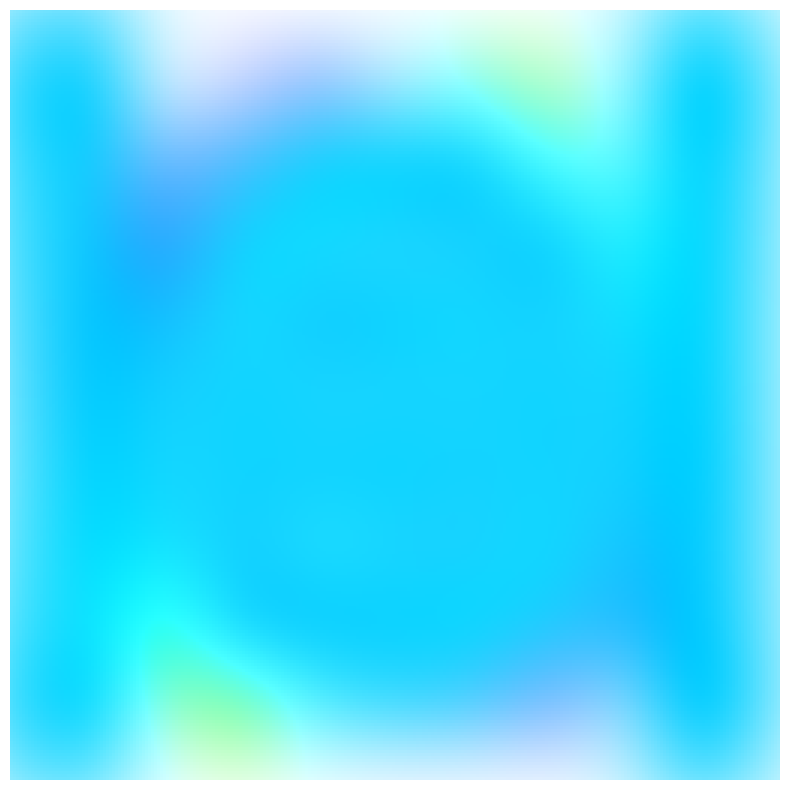

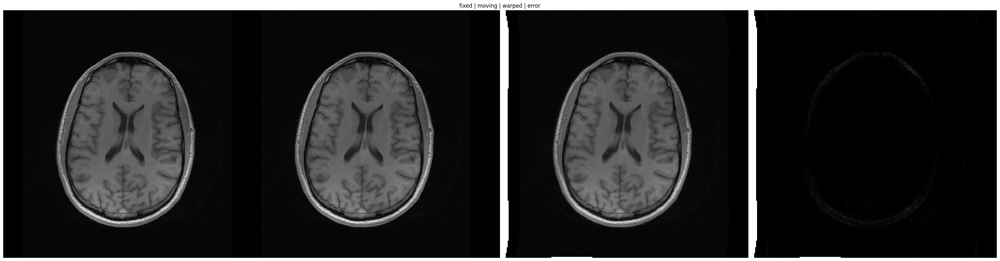

In [57]:
def command_iteration(method):
    print(
        f"{method.GetOptimizerIteration():3} "
        + f"= {method.GetMetricValue():10.5f} "
        + f": {method.GetOptimizerPosition()}"
    )

def command_multi_iteration(method):
    print("--------- Resolution Changing ---------")

fixed = sitk.GetImageFromArray(img_fixed)
moving = sitk.GetImageFromArray(img_moving)

transformDomainMeshSize = [10] * moving.GetDimension()
tx = sitk.BSplineTransformInitializer(fixed, transformDomainMeshSize)

R = sitk.ImageRegistrationMethod()
R.SetMetricAsMeanSquares()
R.SetOptimizerAsRegularStepGradientDescent(4.0, 0.01, 200)
R.SetOptimizerScalesFromPhysicalShift()
R.SetInitialTransform(tx) # sitk.TranslationTransform(fixed.GetDimension())
R.SetInterpolator(sitk.sitkLinear)
R.SetShrinkFactorsPerLevel([6, 2, 1])
R.SetSmoothingSigmasPerLevel([6, 2, 1])

R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))
R.AddCommand(
    sitk.sitkMultiResolutionIterationEvent, lambda: command_multi_iteration(R)
)

outTx = R.Execute(fixed, moving)

print("-------")
print(outTx)
print(f"Optimizer stop condition: {R.GetOptimizerStopConditionDescription()}")
print(f" Iteration: {R.GetOptimizerIteration()}")
print(f" Metric value: {R.GetMetricValue()}")

outFlow = sitk.TransformToDisplacementField(outTx,
                                  sitk.sitkVectorFloat64,
                                  fixed.GetSize(),
                                  fixed.GetOrigin(),
                                  fixed.GetSpacing(),
                                  fixed.GetDirection())

outFlow_np = sitk.GetArrayFromImage(outFlow)

resampler = sitk.ResampleImageFilter()
resampler.SetReferenceImage(fixed)
resampler.SetInterpolator(sitk.sitkLinear)
resampler.SetDefaultPixelValue(1)
resampler.SetTransform(outTx)
warped = resampler.Execute(moving)
warped_np = sitk.GetArrayFromImage(warped)

# composing in sitk
simg1 = sitk.Cast(sitk.RescaleIntensity(fixed), sitk.sitkUInt8)
simg2 = sitk.Cast(sitk.RescaleIntensity(warped), sitk.sitkUInt8)
cimg = sitk.Compose(simg1, simg2, simg1 // 2.0 + simg2 // 2.0)
cimg_np = sitk.GetArrayFromImage(cimg)

# plotting the results
plot_flow(outFlow_np)
plot([img_fixed, img_moving, warped_np, np.abs(warped_np - img_fixed)], title='fixed | moving | warped | error')

**Task 36:** Obtain the backward motion field by [displacement field inversion](https://simpleitk.org/doxygen/latest/html/classitk_1_1simple_1_1InverseDisplacementFieldImageFilter.html) and compare it against a registration with swapped moving and fixed image. Plot the flow fields and the warped images.

--------- Resolution Changing ---------
  0 =    0.00204 : (3.1345577545776996e-06, 0.00012243186180084544, 0.00020513615338408736, 2.5502385659647423e-05, 2.3402024153210467e-07, 7.835039142529761e-07, 1.1070925158629233e-06, 4.383379609655156e-07, 3.5521981675368403e-07, 4.6361078652515096e-05, 0.00023212279920921706, 8.97273800639022e-05, 8.602094894220653e-07, 4.991145434587604e-05, 0.0019364988271003915, 0.0032166293978285127, 0.000392450537507458, 5.991210588952692e-05, 0.0002614738464200714, 0.0002368171404874582, 0.0002872909154620606, 7.021316179711532e-05, 0.0007115202400611901, 0.003601492012635689, 0.0014032042883450704, 1.3630712123223462e-05, 0.00010821429010158268, 0.004154084982658352, 0.006859170861856071, 0.002846951828978847, 0.019466783678895382, 0.028281754500135668, 0.014810776852639396, 0.03638640866013494, 0.021884645124771514, 0.0028770032469589263, 0.0076434180915814845, 0.002998204817040319, 2.9573477488005633e-05, 0.00011840827343997691, 0.004493293700877802

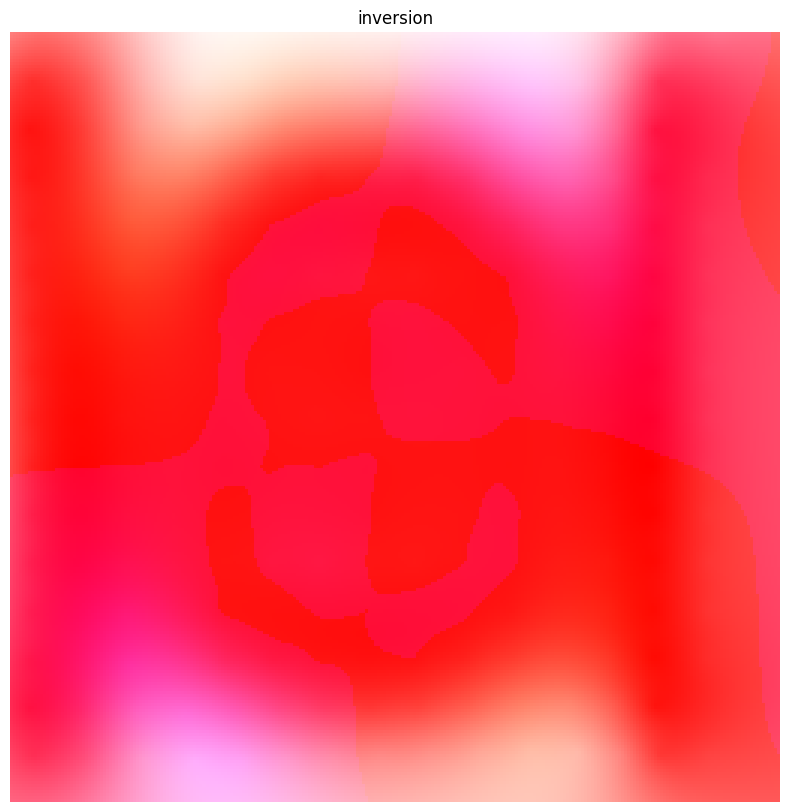

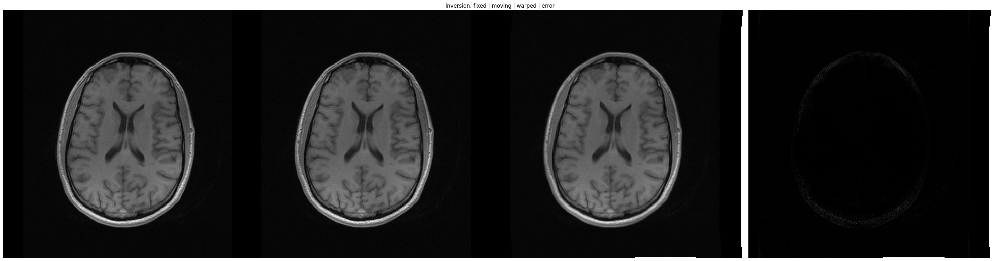

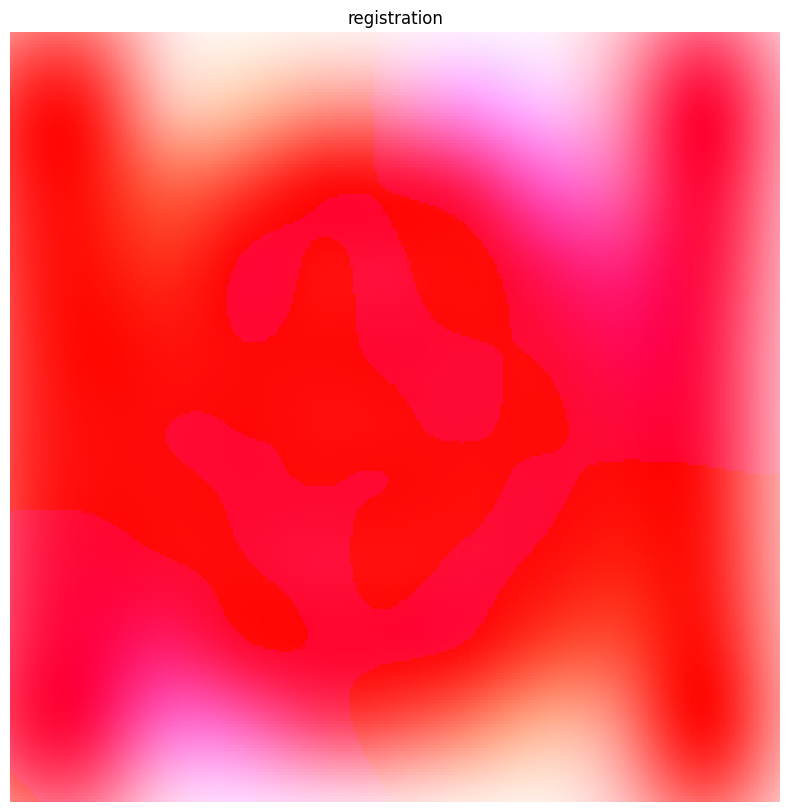

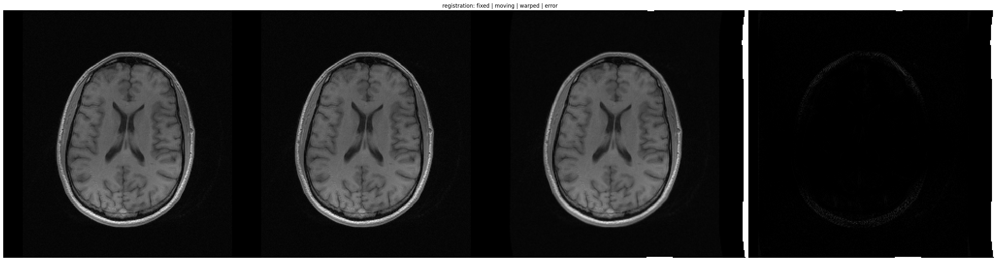

In [58]:
# flow field inversion
R = sitk.InverseDisplacementFieldImageFilter()
R.SetReferenceImage(moving)
outFlowB = R.Execute(outFlow)
outTxB = sitk.DisplacementFieldTransform(outFlowB)
outFlowB = sitk.TransformToDisplacementField(outTxB,
                                  sitk.sitkVectorFloat64,
                                  fixed.GetSize(),
                                  fixed.GetOrigin(),
                                  fixed.GetSpacing(),
                                  fixed.GetDirection())
outFlowB_np = sitk.GetArrayFromImage(outFlowB)

resampler = sitk.ResampleImageFilter()
resampler.SetReferenceImage(moving)
resampler.SetInterpolator(sitk.sitkLinear)
resampler.SetDefaultPixelValue(1)
resampler.SetTransform(outTxB)
warpedB = resampler.Execute(fixed)
warpedB_np = sitk.GetArrayFromImage(warpedB)

# inverse registration
def command_iteration(method):
    print(
        f"{method.GetOptimizerIteration():3} "
        + f"= {method.GetMetricValue():10.5f} "
        + f": {method.GetOptimizerPosition()}"
    )

def command_multi_iteration(method):
    print("--------- Resolution Changing ---------")

fixed = sitk.GetImageFromArray(img_fixed)
moving = sitk.GetImageFromArray(img_moving)

transformDomainMeshSize = [10] * moving.GetDimension()
tx = sitk.BSplineTransformInitializer(fixed, transformDomainMeshSize)

R = sitk.ImageRegistrationMethod()
R.SetMetricAsMeanSquares()
R.SetOptimizerAsRegularStepGradientDescent(4.0, 0.01, 200)
R.SetOptimizerScalesFromPhysicalShift()
R.SetInitialTransform(tx) # sitk.TranslationTransform(fixed.GetDimension())
R.SetInterpolator(sitk.sitkLinear)
R.SetShrinkFactorsPerLevel([6, 2, 1])
R.SetSmoothingSigmasPerLevel([6, 2, 1])

R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))
R.AddCommand(
    sitk.sitkMultiResolutionIterationEvent, lambda: command_multi_iteration(R)
)

outTxBreg = R.Execute(moving, fixed)

print("-------")
print(outTxBreg)
print(f"Optimizer stop condition: {R.GetOptimizerStopConditionDescription()}")
print(f" Iteration: {R.GetOptimizerIteration()}")
print(f" Metric value: {R.GetMetricValue()}")

outFlowBreg = sitk.TransformToDisplacementField(outTxBreg,
                                  sitk.sitkVectorFloat64,
                                  fixed.GetSize(),
                                  fixed.GetOrigin(),
                                  fixed.GetSpacing(),
                                  fixed.GetDirection())

outFlowBreg_np = sitk.GetArrayFromImage(outFlowBreg)

resampler = sitk.ResampleImageFilter()
resampler.SetReferenceImage(moving)
resampler.SetInterpolator(sitk.sitkLinear)
resampler.SetDefaultPixelValue(1)
resampler.SetTransform(outTxBreg)
warpedBreg = resampler.Execute(fixed)
warpedBreg_np = sitk.GetArrayFromImage(warpedBreg)

# plotting the results
plot_flow(outFlowB_np, title='inversion')
plot([img_fixed, img_moving, warpedB_np, np.abs(warpedB_np - img_moving)], title='inversion: fixed | moving | warped | error')

plot_flow(outFlowBreg_np, title='registration')
plot([img_fixed, img_moving, warpedBreg_np, np.abs(warpedBreg_np - img_moving)], title='registration: fixed | moving | warped | error')


Did you spot any difference? They are most likely neglectable, but computational demand is higher for a swapped registration than inverting the flow field.

**Task 37:** Evaluate the isomorphism of the flow fields: $u^{(F)}(u^{(B)}(r)) = r$.

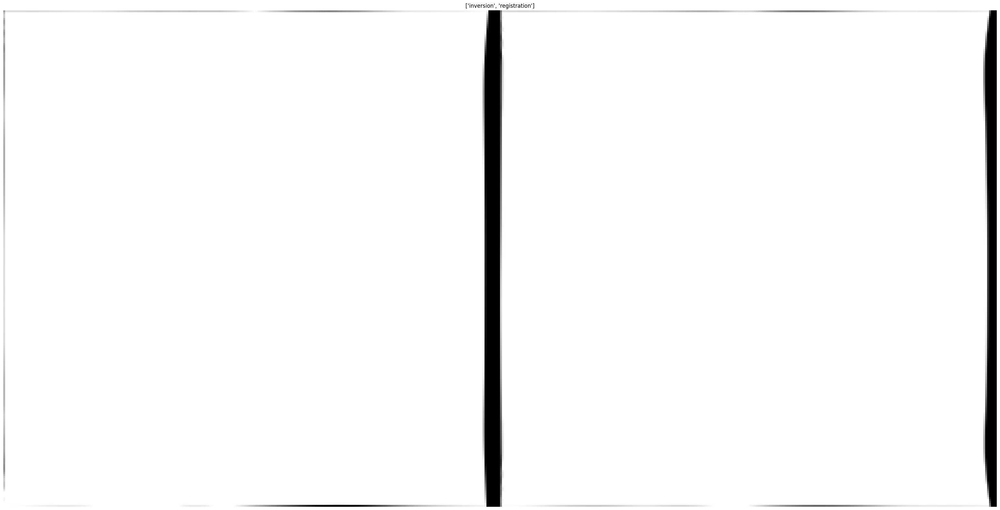

In [59]:
iso_inv_w = warp_2D(warp_2D(np.ones_like(img_fixed), outFlow_np), outFlowB_np)
iso_reg_w = warp_2D(warp_2D(np.ones_like(img_fixed), outFlow_np), outFlowBreg_np)
plot([iso_inv_w, iso_reg_w], title=['inversion', 'registration'])

**Task 38:** Change the metric to a Mattes Mutual Information metric and compare the registration with the previous one.

--------- Resolution Changing ---------
  0 =   -0.99650 : (-0.000534838625257704, -0.01730335300227543, -0.022412640916774137, -0.0016826686733398188, 9.597442700386296e-06, 1.1903143028586993e-05, -6.186321500339511e-07, 4.4094433658976725e-05, 3.3313528048312735e-05, -0.004244817627296789, -0.013501021641287228, -0.0029190035879083204, 1.0397483387451552e-08, -0.008637212530221709, -0.19821056312889668, -0.223804421813678, -0.014675376508999435, 0.000631903454016867, 0.0008817633553624708, -0.004412707510821772, -0.007709681090871358, -0.000940514041103293, -0.02830628102957052, -0.07970644023269276, -0.01419418073138098, 2.788169996635543e-05, -0.029787814903062437, -0.32939491595093084, -0.24133531788548787, -0.010355874025831003, 0.004965768834697434, 0.0011473563997674858, -0.14456965862805712, -0.35432808942778277, -0.11565001921873257, -0.006105746612972463, 0.020355796960858433, 0.014432045291429505, 0.00012997779806272558, -0.018190746907975935, -0.1845446038094312, -0.14460

113 =   -1.63031 : (-0.03303143169634694, -1.4875277458860139, -2.309061645232897, -0.22165189335675806, 0.0009708314521369661, 0.0013894055853361006, 5.638575326129976e-05, 0.00412624503105215, 0.004536345802624941, -0.3865019073230412, -1.267457483247294, -0.27599846224767216, 9.530452364055764e-07, -0.38870792253827074, -13.329499880132968, -18.52427326026402, -1.5598877177035708, 0.08008557869840956, 0.2908373360374068, -0.05049822223316941, -0.8770636715398513, -0.10607529338556618, -2.5523849183735137, -7.439756065615747, -1.338325497820604, 0.0025192082171234817, -0.6737858266966915, -11.110314867149466, -10.359696616421989, -0.4234663786593209, 0.5807272234211377, 2.9114665102913717, -1.8214701735548546, -8.124398736813017, -2.3441474677545413, -0.9524051489893534, 2.102760251181641, 1.4247905263081502, 0.012699762973387518, -0.37922336365207826, -8.631092065177269, -11.252886886633158, -0.9548054399079318, 0.5538288813537346, 0.8881661971663, -2.031646602360007, 2.445763026058

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



 83 =   -1.09252 : (-0.03719324817304363, -1.9006931885403908, -3.1101366679945497, -0.3161780637796233, -0.0009995869646237546, -0.00014933409522091169, -0.0030805858974903948, 0.0009139090186824953, 0.003495336901164626, -0.5983731986801899, -1.992624733098917, -0.4358260078815458, 1.8772986227703435e-06, -0.41985403461689624, -16.129371069845245, -23.411076524234485, -2.005171533701731, 0.08615035572215042, 0.3635670000548017, -0.008026925269519229, -1.057306898382254, -0.12842889355226525, -3.7895294225145424, -11.090695418093805, -1.9470432343391442, 0.004115157172104215, -0.6893976384310332, -11.916353942326982, -10.111604739726065, 0.052673304066281366, 0.01651505289611012, -0.5409913511015199, -3.6495721801170635, -8.583256806229665, -3.2152021333739564, -0.9674533987838876, 5.028785088943584, 2.755421071873263, 0.021312338247444693, -0.4031992401525933, -10.405171566791894, -12.802363029015433, -1.9590236522336142, -5.173090071052575, -8.016638065277757, -11.962613889319538, -

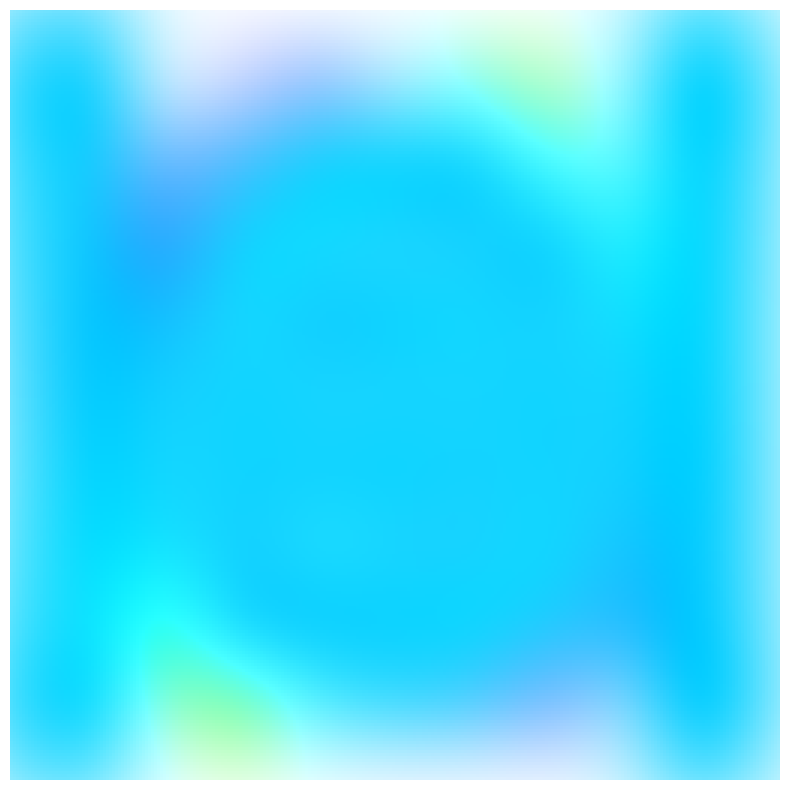

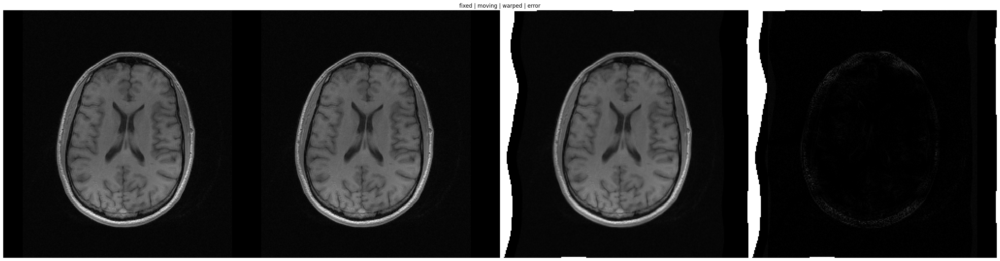

In [60]:
def command_iteration(method):
    print(
        f"{method.GetOptimizerIteration():3} "
        + f"= {method.GetMetricValue():10.5f} "
        + f": {method.GetOptimizerPosition()}"
    )

def command_multi_iteration(method):
    print("--------- Resolution Changing ---------")

fixed = sitk.GetImageFromArray(img_fixed)
moving = sitk.GetImageFromArray(img_moving)

transformDomainMeshSize = [10] * moving.GetDimension()
tx = sitk.BSplineTransformInitializer(fixed, transformDomainMeshSize)

R = sitk.ImageRegistrationMethod()
R.SetMetricAsMattesMutualInformation(24)
R.SetMetricSamplingPercentage(0.10, sitk.sitkWallClock)
R.SetMetricSamplingStrategy(R.RANDOM)
R.SetOptimizerAsRegularStepGradientDescent(4.0, 0.01, 200)
R.SetOptimizerScalesFromPhysicalShift()
R.SetInitialTransform(tx) # sitk.TranslationTransform(fixed.GetDimension())
R.SetInterpolator(sitk.sitkLinear)
R.SetShrinkFactorsPerLevel([6, 2, 1])
R.SetSmoothingSigmasPerLevel([6, 2, 1])

R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))
R.AddCommand(
    sitk.sitkMultiResolutionIterationEvent, lambda: command_multi_iteration(R)
)

outTx = R.Execute(fixed, moving)

print("-------")
print(outTx)
print(f"Optimizer stop condition: {R.GetOptimizerStopConditionDescription()}")
print(f" Iteration: {R.GetOptimizerIteration()}")
print(f" Metric value: {R.GetMetricValue()}")

outFlow = sitk.TransformToDisplacementField(outTx,
                                  sitk.sitkVectorFloat64,
                                  fixed.GetSize(),
                                  fixed.GetOrigin(),
                                  fixed.GetSpacing(),
                                  fixed.GetDirection())

outFlow_mi_np = sitk.GetArrayFromImage(outFlow)

resampler = sitk.ResampleImageFilter()
resampler.SetReferenceImage(fixed)
resampler.SetInterpolator(sitk.sitkLinear)
resampler.SetDefaultPixelValue(1)
resampler.SetTransform(outTx)
warped = resampler.Execute(moving)
warped_mi_np = sitk.GetArrayFromImage(warped)

# composing in sitk
#simg1 = sitk.Cast(sitk.RescaleIntensity(fixed), sitk.sitkUInt8)
#simg2 = sitk.Cast(sitk.RescaleIntensity(warped), sitk.sitkUInt8)
#cimg = sitk.Compose(simg1, simg2, simg1 // 2.0 + simg2 // 2.0)
#cimg_np = sitk.GetArrayFromImage(cimg)

# plotting the results
plot_flow(outFlow_np)
plot([img_fixed, img_moving, warped_mi_np, np.abs(warped_mi_np - img_fixed)], title='fixed | moving | warped | error')

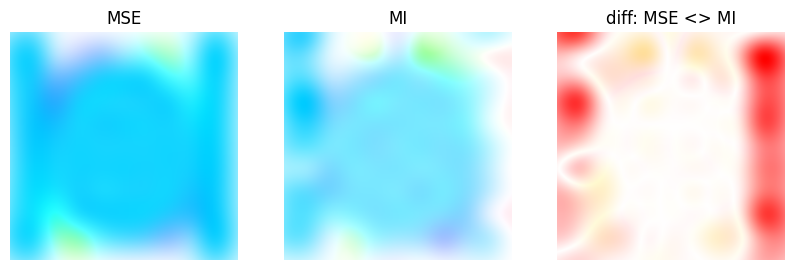

In [61]:
# comparison between MSE and MI metric
plot_flow([outFlow_np, outFlow_mi_np, np.abs(outFlow_np - outFlow_mi_np)], title=['MSE', 'MI', 'diff: MSE <> MI'])

You have most likely observed some incorrect motion estimates at the image boundaries. These are occuring in case you have too many degrees of freedom in your motion model (e.g. B-Spline) when applying to an affine motion (6 degrees of freedom in 2D).

**Task 39:** Adjust the used transformation that better suits your underlying motion with which you simulated your image pair `img_fixed` and `img_moving`.

*Hint:* You can find an overview of the available transformations [here](https://simpleitk.readthedocs.io/en/master/registrationOverview.html).

--------- Resolution Changing ---------
  0 =    0.01532 : (-3.9980967723679637, -0.12337827515760487)
  1 =    0.01231 : (-7.9959752570071565, 0.006881550034314718)
  2 =    0.00493 : (-11.99365791599394, -0.12925572640522592)
  3 =    0.00483 : (-10.000749805992145, 0.03902161933411641)
-------
itk::simple::TranslationTransform
 TranslationTransform (0x99528b0)
   RTTI typeinfo:   itk::TranslationTransform<double, 2u>
   Reference Count: 2
   Modified Time: 110296
   Debug: Off
   Object Name: 
   Observers: 
     none
   Offset: [-10.0007, 0.0390216]

Optimizer stop condition: RegularStepGradientDescentOptimizerv4: Gradient magnitude tolerance met after 4 iterations. Gradient magnitude (5.25858e-05) is less than gradient magnitude tolerance (0.0001).
 Iteration: 5
 Metric value: 3.168084251365138e-06


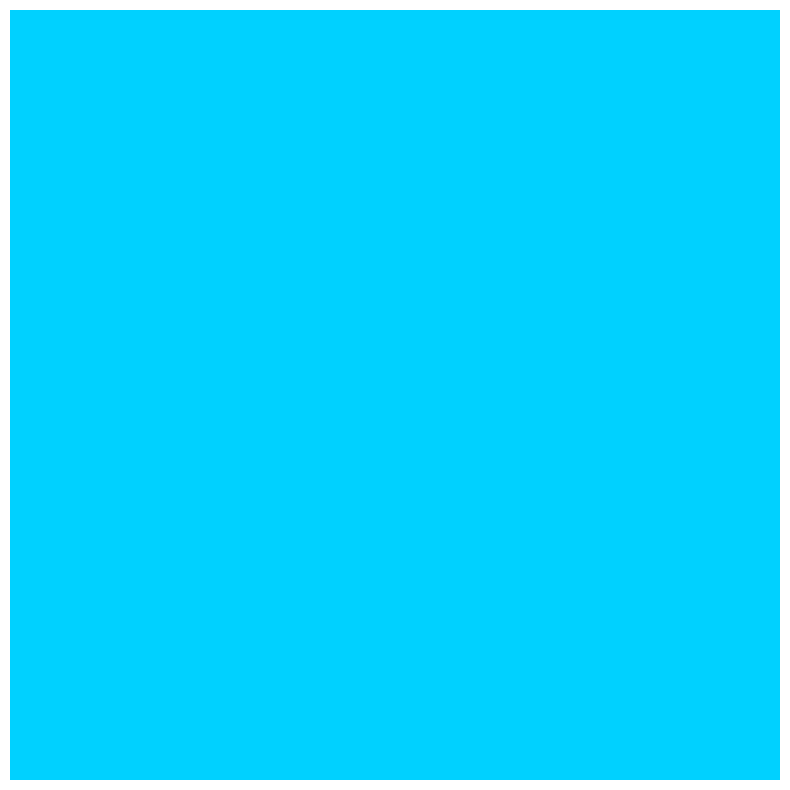

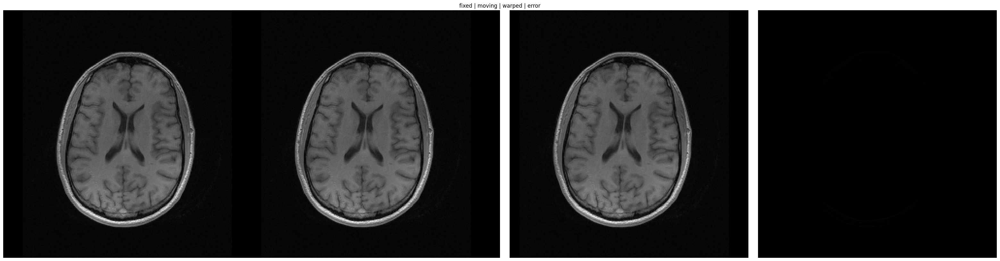

In [62]:
def command_iteration(method):
    print(
        f"{method.GetOptimizerIteration():3} "
        + f"= {method.GetMetricValue():10.5f} "
        + f": {method.GetOptimizerPosition()}"
    )

def command_multi_iteration(method):
    print("--------- Resolution Changing ---------")

fixed = sitk.GetImageFromArray(img_fixed)
moving = sitk.GetImageFromArray(img_moving)

R = sitk.ImageRegistrationMethod()
R.SetMetricAsMeanSquares()
R.SetOptimizerAsRegularStepGradientDescent(4.0, 0.01, 200)
R.SetInitialTransform(sitk.TranslationTransform(fixed.GetDimension()))
R.SetInterpolator(sitk.sitkLinear)


R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))
R.AddCommand(
    sitk.sitkMultiResolutionIterationEvent, lambda: command_multi_iteration(R)
)

outTx = R.Execute(fixed, moving)

print("-------")
print(outTx)
print(f"Optimizer stop condition: {R.GetOptimizerStopConditionDescription()}")
print(f" Iteration: {R.GetOptimizerIteration()}")
print(f" Metric value: {R.GetMetricValue()}")

outFlow = sitk.TransformToDisplacementField(outTx,
                                  sitk.sitkVectorFloat64,
                                  fixed.GetSize(),
                                  fixed.GetOrigin(),
                                  fixed.GetSpacing(),
                                  fixed.GetDirection())

outFlow_trans_np = sitk.GetArrayFromImage(outFlow)

resampler = sitk.ResampleImageFilter()
resampler.SetReferenceImage(fixed)
resampler.SetInterpolator(sitk.sitkLinear)
resampler.SetDefaultPixelValue(1)
resampler.SetTransform(outTx)
warped = resampler.Execute(moving)
warped_trans_np = sitk.GetArrayFromImage(warped)

# composing in sitk
simg1 = sitk.Cast(sitk.RescaleIntensity(fixed), sitk.sitkUInt8)
simg2 = sitk.Cast(sitk.RescaleIntensity(warped), sitk.sitkUInt8)
cimg = sitk.Compose(simg1, simg2, simg1 // 2.0 + simg2 // 2.0)
cimg_np = sitk.GetArrayFromImage(cimg)

# plotting the results
plot_flow(outFlow_trans_np)
plot([img_fixed, img_moving, warped_trans_np, np.abs(warped_trans_np - img_fixed)], title='fixed | moving | warped | error')

**Task 40:** Compare the flows obtained from the optical flow with the SimpleITK flows (B-Spline and other transformation as set in **Tasks 24/27, 35, 38** and **39**).

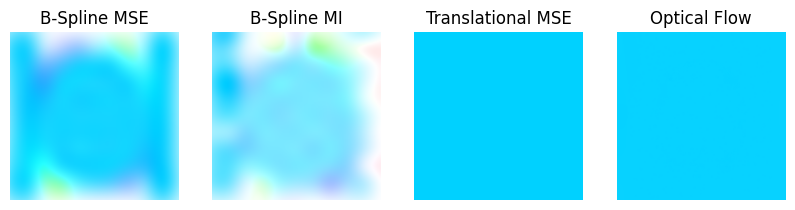

In [63]:
plot_flow([outFlow_np, outFlow_mi_np, outFlow_trans_np, flows], title=['B-Spline MSE', 'B-Spline MI', 'Translational MSE', 'Optical Flow'])

## Deep learning-based image registration
In recent years, deep learning solutions have also been proposed to address the image registration. A short (and by far complete) overview of deep learning image registrations for (single-modality) MRI is provided here:
- [LAPNet](https://ieeexplore.ieee.org/document/9478906)
- [CARMEN](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6677286/)
- [Voxelmorph](https://ieeexplore.ieee.org/document/8633930)
- [FlowNet](https://arxiv.org/abs/1504.06852)
- [RAFT](https://arxiv.org/abs/2003.12039)
- [MRAFT](https://link.springer.com/chapter/10.1007/978-3-030-88552-6_2)
- [MoCo-MoDL](https://onlinelibrary.wiley.com/doi/10.1002/mrm.28851)
- [GRN](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC9095964/)
- [DDR](https://www.sciencedirect.com/science/article/abs/pii/S0167865517301708)
- [DIRNet](https://link.springer.com/chapter/10.1007/978-3-319-67558-9_24)
- [AIRNet](https://arxiv.org/abs/1810.02583)
- [BIRNet](https://www.sciencedirect.com/science/article/abs/pii/S1361841519300805)
- [CVAE](https://arxiv.org/abs/1804.07172)
- [FCN](https://arxiv.org/abs/1801.04012)
- [DeformableReg](https://openreview.net/forum?id=HkmkmW2jM)
- [ICNet](https://arxiv.org/abs/1809.03443)
- ...



We will employ in this example the pre-trained Voxelmorph architecture - as we do not have the time and computing ressources to properly train a neural network from scratch here 😉 But we will dive into a simple exemplary training of an image registration network.

Download and extract the example data and pre-trained networks of Voxelmorph [here](https://surfer.nmr.mgh.harvard.edu/pub/data/voxelmorph/tutorial_data.tar.gz).


In [62]:
!wget https://surfer.nmr.mgh.harvard.edu/pub/data/voxelmorph/tutorial_data.tar.gz -O data.tar.gz
!tar -xzvf data.tar.gz

--2024-06-06 23:17:58--  https://surfer.nmr.mgh.harvard.edu/pub/data/voxelmorph/tutorial_data.tar.gz
Loaded CA certificate '/etc/ssl/certs/ca-certificates.crt'
Resolving surfer.nmr.mgh.harvard.edu (surfer.nmr.mgh.harvard.edu)... 132.183.1.43
Connecting to surfer.nmr.mgh.harvard.edu (surfer.nmr.mgh.harvard.edu)|132.183.1.43|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 16644702 (16M) [application/x-gzip]
Saving to: ‘data.tar.gz’

data.tar.gz         100%[===================>]  15.87M  4.11MB/s    in 7.7s    

2024-06-06 23:18:11 (2.06 MB/s) - ‘data.tar.gz’ saved [16644702/16644702]

brain_2d_no_smooth.h5
brain_2d_smooth.h5
brain_3d.h5
fs_rgb.npy
subj1.npz
subj2.npz
tutorial_data.npz


**Task 41:** Register the moving and the fixed image using the pre-trained Voxelmorph architecture `brain_2d_smooth.h5`. You frist need to specify the network architecture and hyperparameters as detailed here:


```
import voxelmorph as vxm
nb_features = [
    [32, 32, 32, 32],         # encoder features
    [32, 32, 32, 32, 32, 16]  # decoder features
]
vol_shape = tuple(np.shape(img_fixed))
vxm_model = vxm.networks.VxmDense(vol_shape, nb_features, int_steps=0)

losses = ['mse', vxm.losses.Grad('l2').loss]
loss_weights = [1, 0.01]

vxm_model.compile(optimizer=tf.keras.optimizers.Adam(lr=1e-4), loss=losses, loss_weights=loss_weights)

vxm_model.load_weights('brain_2d_smooth.h5')
```

The input to the network is defined as `inp = [img_moving, img_fixed]` and the prediction can be carried out with `out = vxm_model.predict(inp)` which returns a list containing the warped image and the motion field. Plot the warped image (using `plot()`) and the motion field (using `plot_flow()`).


*Hint:* Do not forget to add a batch and channel dimension (additional first and last dimension) to the inputs.

In [66]:
import voxelmorph as vxm
nb_features = [
    [32, 32, 32, 32],         # encoder features
    [32, 32, 32, 32, 32, 16]  # decoder features
]
vol_shape = tuple(np.shape(img_fixed))
vxm_model = vxm.networks.VxmDense(vol_shape, nb_features, int_steps=0)

losses = ['mse', vxm.losses.Grad('l2').loss]
loss_weights = [1, 0.01]

vxm_model.compile(optimizer=tf.keras.optimizers.Adam(lr=1e-4), loss=losses, loss_weights=loss_weights)

vxm_model.load_weights('brain_2d_smooth.h5')

val_input = [img_moving[np.newaxis, :, :, np.newaxis], img_fixed[np.newaxis, :, :, np.newaxis]]
val_pred = vxm_model.predict(val_input)

2024-06-06 23:29:28.829625: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-06 23:29:28.830074: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-06 23:29:28.988850: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1960] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the 

1/1 [==============================] - 0s 407ms/step


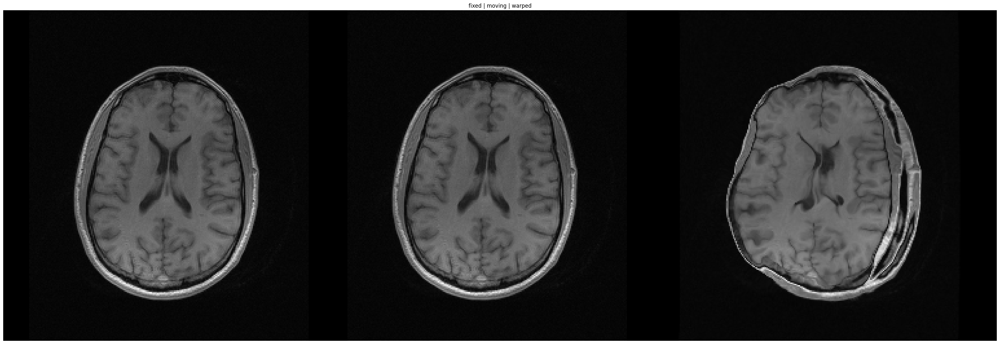

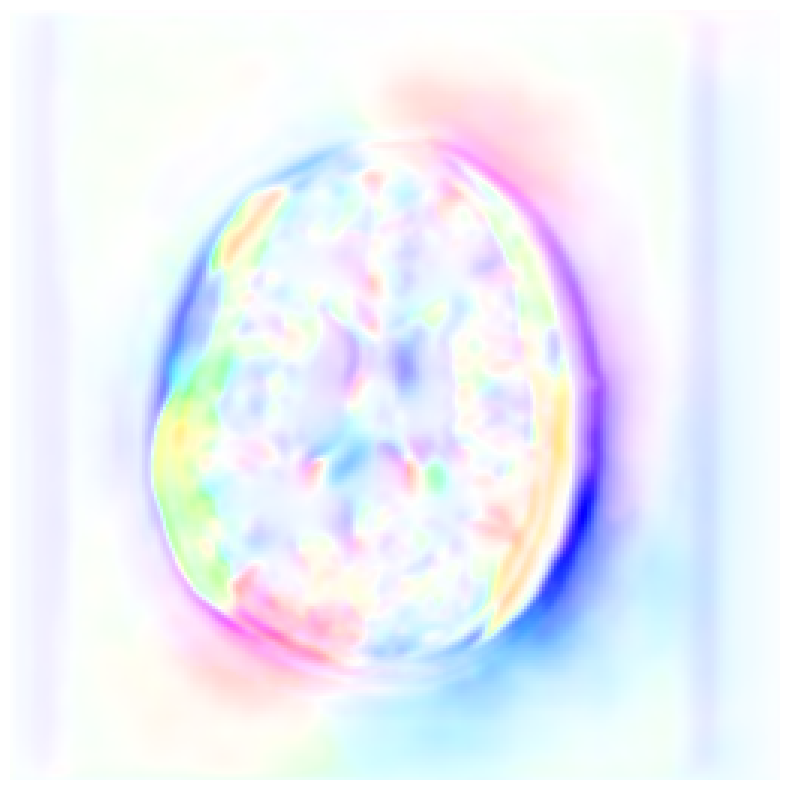

In [67]:
plot([img_fixed, img_moving, np.squeeze(val_pred[0], (0, -1))], title='fixed | moving | warped')
plot_flow(np.squeeze(val_pred[1], 0))

**Task 42:** Perform the above registration using the pre-trained network `brain_2d_no_smooth.h5`.

1/1 [==============================] - 0s 364ms/step


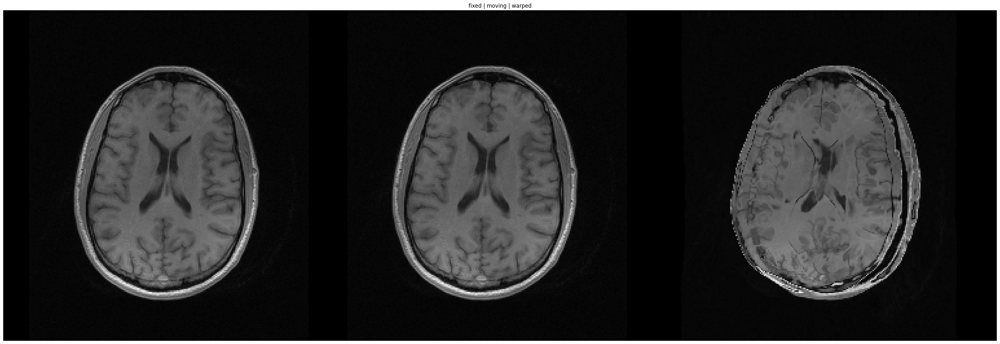

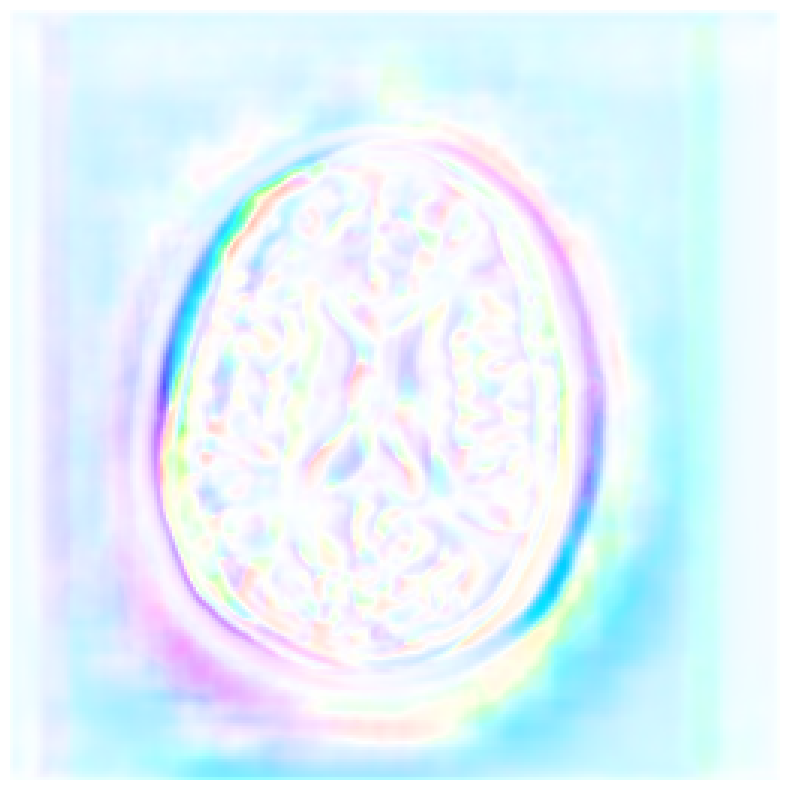

In [68]:
import voxelmorph as vxm
nb_features = [
    [32, 32, 32, 32],         # encoder features
    [32, 32, 32, 32, 32, 16]  # decoder features
]
vol_shape = tuple(np.shape(img_fixed))
vxm_model = vxm.networks.VxmDense(vol_shape, nb_features, int_steps=0)

losses = ['mse', vxm.losses.Grad('l2').loss]
loss_weights = [1, 0.01]

vxm_model.compile(optimizer=tf.keras.optimizers.Adam(lr=1e-4), loss=losses, loss_weights=loss_weights)

vxm_model.load_weights('brain_2d_no_smooth.h5')

val_input = [img_moving[np.newaxis, :, :, np.newaxis], img_fixed[np.newaxis, :, :, np.newaxis]]
val_pred = vxm_model.predict(val_input)
plot([img_fixed, img_moving, np.squeeze(val_pred[0], (0, -1))], title='fixed | moving | warped')
plot_flow(np.squeeze(val_pred[1], 0))

Most likely you have obtained in both cases a quite artistic looking warped image together with a smooth motion field. The reason for this is, that the pre-trained architectures were trained to match sagittal slices between different subjects (inter-subject registration) and different slices from the same subject to enable an atlas-style mapping.

Since we want to register the same moving slices onto each other, we need to retrain the architecture. We will use the axial slices of the two validation volumes in `subj1.npz` and `subj2.npz` provided with the Voxelmorph example data. The subsqeuent steps follow the [Voxelmorph tutorial](http://tutorial.voxelmorph.net/) loosely which can be used as guidance or inspiration.


We first need to rotate the images into axial orientation (`np.rot90(..., 1)`) and subsequently zeropad the images to a size of $X \times Y \times \text{slices} = 256 \times 256 \times 224$ (`zpad(..., (256, 256, 224))`). Move the axial slices now in the batch dimension (first dimension).

**Task 43:** Prepare the training data taken from the `subj1.npz` and `subj2.npz` as described above.

In [69]:
# prepare data from 3D val_volumes
val_volume_1 = np.load('subj1.npz')['vol']
val_volume_2 = np.load('subj2.npz')['vol']
traindata = np.concatenate((np.transpose(zpad(np.rot90(val_volume_1, 1), (256, 256, 224)), (2, 0, 1)),
                            np.transpose(zpad(np.rot90(val_volume_2, 1), (256, 256, 224)), (2, 0, 1))),0)

**Task 44:** Implement a data generator for neural network training that inputs to the network the `[moving_image, fixed_image]` in which the `moving_image` is obtained by an affine transformation (using `transform_img()`) of the `fixed_image` with randomly selected affine transformation parameters `p`. Decide for a suitable range of transformation parameters `p`.

*Hint:* You may refer to the function `vxm_data_generator()` in the [Voxelmorph tutorial](http://tutorial.voxelmorph.net/) for guidance.

In [70]:
def vxm_data_generator_new(x_data, batch_size=32, p_min=[0, 0, 0, 0, 80, 80], p_max=[100, 100, 90, 50, 100, 100]):
    """
    Generator that takes in data of size [N, H, W], and yields data for
    our custom vxm model.

    inputs:  moving [bs, H, W, 1], fixed image [bs, H, W, 1]
    outputs: moved image [bs, H, W, 1], zero-gradient [bs, H, W, 2]
    """

    # preliminary sizing
    vol_shape = x_data.shape[1:] # extract data shape
    ndims = len(vol_shape)

    # prepare a zero array the size of the deformation
    # to enable regularization
    zero_phi = np.zeros([batch_size, *vol_shape, ndims])

    while True:
        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1 = np.random.randint(0, x_data.shape[0], size=batch_size)
        fixed_images = x_data[idx1, ..., np.newaxis]
        moving_images = np.zeros_like(fixed_images)
        for b in range(np.shape(fixed_images)[0]):
          p_rand = np.random.randint(p_min, p_max).astype(np.float32)
          p_rand[-3:] = p_rand[-3:]/100
          moving_images[b, ...] = transform_img(fixed_images[b, ..., 0], p_rand)[..., np.newaxis]

        inputs = [moving_images, fixed_images]

        # prepare outputs (the 'true' moved image):
        # of course, we don't have this, but we know we want to compare
        # the resulting moved image with the fixed image.
        # we also wish to penalize the deformation field.
        outputs = [fixed_images, zero_phi]

        yield (inputs, outputs)


train_generator = vxm_data_generator_new(traindata, batch_size=8)

**Task 45:** Now train the Voxelmorph architecture using your prepared training data generator: `vxm_model.fit_generator(train_generator, epochs=nb_epochs, steps_per_epoch=steps_per_epoch, verbose=2)`. You may decide for the amount of epochs to train `nb_epochs` and the `steps_per_epoch` ($\leq 448$). Depending on your selection, training may take up to several minutes.

In [71]:
nb_features = [
    [32, 32, 32, 32],         # encoder features
    [32, 32, 32, 32, 32, 16]  # decoder features
]
vol_shape = tuple(np.shape(img_fixed))
vxm_model = vxm.networks.VxmDense(vol_shape, nb_features, int_steps=0)

losses = ['mse', vxm.losses.Grad('l2').loss]
loss_weights = [1, 0.01]

vxm_model.compile(optimizer=tf.keras.optimizers.Adam(lr=1e-4), loss=losses, loss_weights=loss_weights)
hist = vxm_model.fit_generator(train_generator, epochs=20, steps_per_epoch=200, verbose=2)

Epoch 1/20


/tmp/ipykernel_324856/3510707543.py:12: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  hist = vxm_model.fit_generator(train_generator, epochs=20, steps_per_epoch=200, verbose=2)


200/200 - 319s - loss: 0.0103 - vxm_dense_transformer_loss: 0.0087 - vxm_dense_flow_loss: 0.1635 - 319s/epoch - 2s/step
Epoch 2/20


KeyboardInterrupt: 

**Task 46:** Register the images using your trained network. Plot the warped image and the obtained flow.

*Hint:* `model.predict()` provides you the warped image and the flow field.

In [ ]:
val_input = [img_moving[np.newaxis, :, :, np.newaxis], img_fixed[np.newaxis, :, :, np.newaxis]]
val_pred = vxm_model.predict(val_input)

plot([img_fixed, img_moving, np.squeeze(val_pred[0], (0, -1))], title='fixed | moving | warped')
plot_flow(np.squeeze(val_pred[1], 0))

Were you able to train a good image registration network? A few points to consider when training your registration network:
- the complexity of your motion (rigid, affine, elastic)
- availability of enough diverse training data
- network architecture parametrization (kernel sizes, feature maps/channels, ...)
- hyperparameters (loss, learning rate, ...)

**Task 47:** You can play around now by changing some of the above points to see if you are able to obtain a better result.

# 3. Motion-compensated image reconstruction
<a name="MotionCompensated"></a>
In this part, we will embed the estimated motion in the image reconstruction task.

Before diving into the motion-compensated reconstruction task, we will shortly recap an iterative SENSE image reconstruction.

The goal is to recover the clean image $x$, which is obtained by (undersampled) k-space data $y$ and corrupted by additive Gaussian white noise $n$,
$$ y = Ax + n. $$
The rawdata $y$ was aquired with multiple receive coils. The linear operator $A$ denotes the mapping from image space to k-space.

Consequently we can define and implement the multi-coil forward operator $A$ in `mriForwardOp(image, mask, smaps)` mapping from `image` to k-space and the adjoint operator $A^*$ in `mriAdjointOp(kspace, mask, smaps)` mapping from `kspace` to image domain. `smaps` describes the coil sensitivity maps, and `mask` depicts the sampling trajectory.

We consider now the following minimization problem:

$$ \min_x  E(x,y) = \min_x \frac{1}{2} \Vert Ax - y \Vert_2^2 .$$

While in image denoising we are still able to compute a closed-form solution for this problem, this is not feasible for the task of MRI reconstruction anymore. We instead use first-order optimization methods and solve this by Gradient Descent:
$$ x^{t+1} = x^{t} - \alpha \nabla_x E(x,y) $$
$$ x^{t+1} = x^{t} - \alpha A^* (Ax^t - y) $$


**Suggested Readings:**

Pruessmann et al. [SENSE: Sensitivity encoding for fast MRI](https://onlinelibrary.wiley.com/doi/abs/10.1002/%28SICI%291522-2594%28199911%2942%3A5%3C952%3A%3AAID-MRM16%3E3.0.CO%3B2-S) Magnetic Resonance in Medicine, 43(5):952-962, 1999.

## iterative SENSE

Below is the implementation of the iterative SENSE reconstruction that follows the above formalism. The interface can be used to reconstruction Cartesian and non-Cartesian data - only determined by the definition of the respective forward and adjoint operators.

The Cartesian operators are given by:
- numpy: `mriForwardOp()` and `mriAdjointOp()` in `utils/mri.py`
- Tensorflow: `MulticoilForwardOp` and `MulticoilAdjointOp` in `merlintf.keras.layers.mri`.

The non-Cartesian operators are defined as:
- numpy: `GPUNUFFTOp.forward()` and `GPUNUFFTOp.adjoint()` in class `GPUNUFFTOp` of `utils/mri.py`
- Tensorflow: `GPUNUFFTFwd` and `GPUNUFFTAdj` in `utils/mri.py`.

The iterative SENSE reconstruction `iterativeSENSE()` in `utisl/mri.py` is automatically executed on GPU (if available and optox is used) and has the following interface:

```
def iterativeSENSE(kspace, smap=None, mask=None, noisy=None, dcf=None, flow=None,
            fwdop=MulticoilForwardOp, adjop=MulticoilAdjointOp,
            add_batch_dim=True, max_iter=10, tol=1e-12, weight_init=1.0, weight_scale=1.0, use_optox=False):
    # kspace        raw k-space data as [X, Y, coils] which will be converted to:
    #               Cartesian + no-motion compensation: [batch, coils, X, Y] or [batch, coils, X, Y, Z] or [batch, coils, time, X, Y] or [batch, coils, time, X, Y, Z] (numpy array)
    #               Cartesian + motion-compensation / non-Cartesian + no-motion/motion-comp.: [batch, X, Y, coils]
    # smap          coil sensitivity maps with same shape as kspace (or singleton dimension for time) (numpy array)
    # mask          subsampling including/excluding soft-weights with same shape as kspace (no-motion-comp) and shape: X, Y, coils, T (motion-comp) (numpy array)
    # noisy         initialiaztion for reconstructed image, if None it is created from A^H(kspace) (numpy array)
    # dcf           density compensation function (only non-Cartesian) (numpy array)
    # flow          flow field (numpy array)
    # fwdop         forward operator A
    # adjop         adjoint operator A^H
    # add_batch_dim automatically append batch dimension for GPU execution
    # max_iter      maximum number of iterations for CG/iterative SENSE
    # tol           tolerance for stopping condition for CG/iterative SENSE
    # weight_init   initial weighting for lambda regularization parameter
    # weight_scale  scaling factor for lambda regularization parameter
    # return:       reconstructed image (numpy array)
```



In the following, we will only focus on the numpy implementation (due to RAM limitations and GPU availability), but codes for GPU implementation are also provided (Attention: The GPU implementations require further improvement as currently handovers between CPU and GPU, i.e. type conversion between numpy and Tensorflow are happening).


We will see two examples below how to perform an iterative SENSE reconstruction for a 2D Cartesian and a 2D non-Cartesian imaging.

### 2D Cartesian reconstruction

In [ ]:
from merlintf.keras.layers.mri import MulticoilForwardOp, MulticoilAdjointOp

# prepare data
kspace = fft2c(img)
kspace_espirit = kspace[:,:,np.newaxis,:]
smaps_espirit = espirit.espirit(kspace_espirit, 8, 20, 0.05, 0)
smaps = smaps_espirit[:,:,0,:,0]

# Cartesian
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = MulticoilForwardOp(center=True, coil_axis=-3, channel_dim_defined=False)
  AH = MulticoilAdjointOp(center=True, coil_axis=-3, channel_dim_defined=False)
  use_optox = True
else:
  A = mriForwardOp
  AH = mriAdjointOp
  use_optox = False

img_recon = iterativeSENSE(kspace, smaps, fwdop=A, adjop=AH, use_optox=use_optox)
plot(img_recon)

### 2D non-Cartesian reconstruction
<a name="2DnonCart"></a>

In [ ]:
from mri.operators import NonCartesianFFT

# prepare data
nRead = np.amax(np.shape(img)[0:2])
img_qfov = zpad(img, (nRead, nRead, np.shape(img)[2])).astype(np.complex64)
img_qfov = img_qfov[:,:,np.newaxis,:]
kspace_qfov = fft2c(img_qfov)
smaps_rad_espirit = espirit.espirit(kspace_qfov, 8, 20, 0.05, 0)
smaps_rad = smaps_rad_espirit[:,:,0,:,0]
csm = np.transpose(smaps_rad, (2, 0, 1))
kpos, dcf = prepare_radial(acc=1, nRead=nRead)

# non-Cartesian
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = GPUNUFFTFwd(nRead, kpos, csm, dcf)
  AH = GPUNUFFTAdj(nRead, kpos, csm, dcf)
  #kspace_radial = np.squeeze(A(numpy2tensor(rss(img_qfov[:,:,0,:]), add_batch_dim=True, add_channel_dim=False)).numpy())
  kspace_radial = A.op.op(rss(img_qfov[:,:,0,:]))
  use_optox = True
else:
  nufft = GPUNUFFTOp(kpos, csm, dcf, nRead)
  A = nufft.forward
  AH = nufft.adjoint
  kspace_radial = nufft.forward(rss(img_qfov[:,:,0,:]))
  use_optox = False

img_recon_rad = iterativeSENSE(kspace_radial, csm, kpos, dcf=dcf, fwdop=A, adjop=AH, weight_scale=0.1, max_iter=2, use_optox=use_optox)
plot(img_recon_rad)

## Motion-compensated Batchelor-type reconstruction

Affine motion has a well-understood representation in k-space, however generalized elastic motion does not. An approach to correct for this type of motion is to consider the forward model of an acquisition corrupted by motion and solve the corresponding reconstruction problem [1]:

$$ \hat{x} = \arg\min_x \frac{1}{2} \Vert Ex - y \Vert_2^2 $$

where the forward model is given by:

$$ E = \sum_n A_n F C U_n $$

Under this representation, $A_n$ are the k-space sampling matrices for each motion state $n$, $F$ is the Fourier transform, $C$ are the coil sensitivities and $U_n$ are the motion fields for each motion state. The motion fields $U_n$ may be considered as sparse motion matrices where each row contains the interpolation weights $w_i^j$ associated with a given displacement. If nearest neighbour interpolation is considered, then $U_n$ become permutation matrices, i.e. only one interpolant per row and with value $w_i^j=1$. If linear interpolation is considered (as it is in this example implementation), then each row contains four interpolants (in 2D), such that $ \sum_j w_i^j = 1 $.

![](https://github.com/lab-midas/ismrm-moco-workshop/blob/master/doc/sparse_motion_mat.png?raw=true)

For a motion-compensated Batchelor-type reconstruction, we first need a simple representation of the motion as a sparse matrix.

This is implemented in `get_sparse_motion_matrix()` (converts dense flow field to sparse motion matrix) and `apply_sparse_motion()` (warps an image via matrix-vector multiplication) from `utils/motioncomp.py`. In the Cartesian case, these functions are invoked from the forward `BatchForwardOp()` $E$ and adjoint `BatchAdjointOp()` $E^H$ operators which are handed over to the iterative SENSE reconstruction `iterativeSENSE()`.

The forward and adjoint operators that take into account the motion model are defined as `BatchForwardOp()` and `BatchAdjointOp()` in `utils/mri.py`.

<br>

[1] Batchelor PG, Atkinson D, Irarrazaval P, Hill DL, Hajnal J, Larkman D. Matrix description of general motion correction applied to multishot images. Magnetic Resonance in Medicine: An Official Journal of the International Society for Magnetic Resonance in Medicine. 2005 Nov;54(5):1273-80.

**Task 48:** Apply an affine transformation to the coil-combined image (`img_cc = mriAdjointOp(kspace, np.ones_like(kspace), smaps`) and plot the motion-free and motion-affected image side-by-side (using `plot()`).

*Hint:* Please see **Task 1** for more information.

In [ ]:
kspace = fft2c(img)
kspace_espirit = kspace[:,:,np.newaxis,:]
smaps_espirit = espirit.espirit(kspace_espirit, 8, 20, 0.05, 0)
smaps = smaps_espirit[:,:,0,:,0]
smaps = smaps / rss(smaps)[:,:,np.newaxis]  # normalize coil sensitivities
img_cc = mriAdjointOp(kspace, np.ones_like(kspace), smaps)

img_affine = transform_img(img_cc, [-10, 30, 45, 0.1, 1, 1])
plot([img_cc, img_affine])

**Task 49:** Simulate a motion-corrupted acquisition such that every 2nd phase-encoding step is affected by an abrupt (and time-constant) affine motion. You can use the function `simulate_motion()` in `utils/motionsim.py`. Plot the motion-free and motion-affected scans.

*Hint:* Please see **Task 5** for more information.

In [ ]:
p = [-10, 30, 45, 0.1, 1, 1]
mask_motion = np.zeros(np.shape(kspace)[1])
mask_motion[::2] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]

kspace_motion, mask_motion = simulate_motion(img_cc, smaps, np.ones_like(kspace), p)
img_motion = mriAdjointOp(kspace_motion, np.ones_like(kspace), smaps)

plot([img_cc, img_motion])

**Task 50:** Simulate a translational motion-affected scan (every 2nd phase-encoding line is affected by motion) using `simulate_motion()`.

In [ ]:
p = [-10, 30, 0, 0, 1, 1]
mask_motion = np.zeros(np.shape(kspace)[1])
mask_motion[::2] = 1
p = mask_motion[:, np.newaxis] * np.asarray(p)[np.newaxis, :]

kspace_motion, mask_motion = simulate_motion(img_cc, smaps, np.ones_like(kspace), p)
img_motion = mriAdjointOp(kspace_motion, np.ones_like(kspace), smaps)

plot([img_cc, img_motion])

Before we can perform a motion-compensated image reconstruction, we need the deformation fields which are used in the forward `BatchForwardOp()` and adjoint operators `BatchAdjointOp()`.

We can either perform an image registration between the motion-free and motion-affected scan, please see **Tasks 23** to **47** in [2. Motion estimation / image registration](#MotionEstimation), or since we are applying an explicit (and known) affine motion to the image, we can analytically calculate the deformation field for it.

**Task 51:** Write the functions `get_affine_matrix()` which gives you the affine motion matrix for the motion parameters (see [Motion artifact appearance](#MotionArtifactAppearance)) and plug this into `get_deformation_field_from_affine()` which applies the affine motion matrix at each voxel location of the image to return the deformation field of shape $X \times Y \times 2$.

*Attention:* For `get_deformation_field_from_affine()` (and also in the Matlab code), the deformation field is usually overlaid with a grid which is used in the creation of the sparse matrix. For this, a grid is created via `np.mgrid` to which the affine motion matrix from `get_affine_matrix()` is multiplied. However, the Python code does not use this grid in the creation of the sparse matrix. We therefore provide here functions that add/remove the mesh from the flow field.



In [ ]:
def get_affine_matrix(img, p):
  if len(np.shape(img)) > 2:
    raise "Only 2D processing implemented"
  x, y = np.shape(img)
  x /= 2
  y /= 2

  # translation from origin to point (x,y)
  P1 = np.array([[1, 0, -x], [0, 1, -y], [0, 0, 1]])
  # translation back to origin from point (x,y)
  P2 = np.array([[1, 0, x], [0, 1, y], [0, 0, 1]])

  # translation
  T = np.array([[0, 0, p[0]], [0, 0, p[1]], [0, 0, 0]])

  # rotation
  radians = -np.pi * np.asarray(p[2]) / 180.
  R = np.array([[np.cos(radians), -np.sin(radians), 0],[np.sin(radians), np.cos(radians), 0], [0, 0, 1]])

  # shearing
  G = np.array([[1, p[3], 0], [0, 1, 0], [0, 0, 1]])

  # scaling
  S = np.array([[p[4], 0, 0], [0, p[5], 0], [0, 0, 1]])

  # affine matrix
  return np.linalg.multi_dot([P2, G, S, R, P1]) + T

In [ ]:
def get_deformation_field_from_affine(img, affine_mat):
  height, width = np.shape(img)
  gridY, gridX = np.mgrid[1:width+1, 1:height+1]
  positions = np.concatenate((np.transpose(gridX.flatten()[:, np.newaxis], (1, 0)), np.transpose(gridY.flatten()[:, np.newaxis], (1, 0)), np.ones((1, img.size))), axis=0)  # with overlaid grid
  #positions = np.concatenate((np.ones((1, img.size)), np.ones((1, img.size)), np.ones((1, img.size))), axis=0)
  u = affine_mat @ positions
  u = np.transpose(np.reshape(np.transpose(u[0:2, :], (1, 0)), (height, width, 2)), (1, 0, 2))
  return u

def add_mesh_to_def(u):
  height, width, nd = np.shape(u)
  gridY, gridX = np.mgrid[1:width+1, 1:height+1]
  q = np.zeros(np.shape(u))
  q[:,:,0] = u[:,:,0] + gridY
  q[:,:,1] = u[:,:,1] + gridX
  return q

def remove_mesh_from_def(u):
  height, width, nd = np.shape(u)
  gridY, gridX = np.mgrid[1:width+1, 1:height+1]
  q = np.zeros(np.shape(u))
  q[:,:,0] = u[:,:,0] - gridY
  q[:,:,1] = u[:,:,1] - gridX
  return q


**Task 52:** Obtain the deformation field via `get_flow()` in `utils/motionsim.py` for a translational displacement $t_x=10$ and plot the flow field using `plot_flow()`. Compare the warped image using the obtained flow field with the directly transformed image from `transform_img()`.

*Hint:* Please see **Task 1** for more information on transforming an image, and **Task 25** for more information on flow plotting. Do not forget to scale the images to a common range before comparing them.<br/>
The function `get_flow(img, p)` is a wrapper around `get_affine_matrix()`, `get_deformation_field_from_affine()` and `remove_mesh_from_def()`.

In [ ]:
# Converting affine matrices to dense motion fields will include an underlying
# coordinates mesh, which can be removed if needed
p = [-10, 0, 0, 0, 1, 1]
aff = get_affine_matrix(img_cc, p)
u = get_deformation_field_from_affine(img_cc, aff)
#q = remove_mesh_from_def(u)
q = get_flow(img_cc, p)

img_in = minmaxscale(np.abs(img_cc), [0, 1])
img_trans = transform_img(img_in, p)
img_warped = warp_2D(img_in, q)
mae = np.sum(np.sum(np.abs(img_warped-img_trans)))
plot([img_in, img_trans, np.abs(img_trans - img_in), img_warped, np.abs(img_warped-img_in), np.abs(img_warped-img_trans)])
plot_flow(u) # with mesh
plot_flow(q) # without mesh

#### Cartesian imaging

**Task 53:** Apply the forward operator `BatchForwardOp()` to the fully-sampled motion-free image using the flow field $u$ from **Task 52** to obtain a motion-corrupted acquisition. Subsequently apply the adjoint operator `BatchAdjointOp()` on this motion-corrupted data to obtain the zero-filled motion-corrected reconstruction. Compare this against the non-motion-corrected zero-filled reconstruction (using `mriAdjointOp()`). Simulate that every 2nd phase-encoding line is affected by motion. Plot the images.

*Hint:* Since we need a motion field for all time frames, we also require the identity flow field for the first time point which we can stack into a rank 4 matrix: $X \times Y \times 2 \ (u_x, u_y) \times 2 \ (\text{Time})$ <br/>
In a similar fashion we need to stack the masks so that they have a shape: $X \times Y \times \text{Channels} \times \text{Time}$.<br/>
Please use `get_flow()` to obtain the flow field from the affine motion parameters and `get_sparse_motion_matrix()` in `utils/motioncomp.py` to obtain the sparse motion matrices. A stack of vertical sparse tensors

```
from scipy.sparse import vstack
smm = vstack([smm0, smm1, ...])
```

is used in the Batchelor forward and adjoint operators.


In [ ]:
mask_fs = np.ones_like(kspace)
p = [-20, 40, 0, 0, 1, 1]
u = get_flow(img_cc, p)
u_id = get_flow(img_cc, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id, u], -1)
mask_motion1 = np.zeros_like(kspace)
mask_motion1[::2] = 1
mask_motion2 = np.ones_like(kspace)
mask_motion2 -= mask_motion1
masks_motion = np.stack([mask_motion1, mask_motion2], -1)
masks = np.stack([mask_fs, mask_fs], -1)

smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])

from scipy.sparse import vstack
smm = vstack([smm0, smm1])


In [ ]:
kspace_motion = BatchForwardOp(img_cc, masks_motion, smaps, smm)

img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks_motion, smaps, smm)
img_no_motion_corr_zf = BatchAdjointOp(kspace_motion, masks, smaps, smm)
plot([img_cc, img_no_motion_corr_zf, img_motion_corr_zf], title='motion-free | motion-affected | zero-filled motion-comp.')

Residual artefacts can be observed. This is because just applying the adjoint operator leads to a naive inversion, which corresponds to an image-based motion correction approach (i.e. reconstruct separate motion-resolved aliased images and then warp them to a common reference). This only works if the motion and the (undersampled) Fourier transform for each motion state commute, which is generally not the case.

Before going to an iterative SENSE reconstruction, we will solve the linear inverse problem by a simple gradient descent algorithm: compute the local gradient and take a small step in the direction that minimizes it. It iteratively solves for the solution.

**Attention**: The iterative SENSE reconstruction (on the GPU)requires some time. The gradient descent provides a faster approximate solution.

In [ ]:
# Gradient descent solver for linear inverse problem

def grad_descent_batch(kspace, masks_motion, smaps, smm, max_it):

  Ny, Nx, Nc = np.shape(kspace)

  #Right hand side
  m = BatchAdjointOp(kspace_motion, masks_motion, smaps, smm)
  ExEHxm = BatchAdjointOp(BatchForwardOp(m, masks_motion, smaps, smm), masks_motion, smaps, smm)

  # initial residual
  r = m - ExEHxm

  rho = np.zeros((Ny,Nx,max_it+1)) + 1j * np.zeros((Ny,Nx,max_it+1))

  # 0-th iteration, i.e., the "zero-filled" recon
  rho[:,:,0] = m

  for it in range(max_it):

      # Compute alpha
      aux = BatchAdjointOp(BatchForwardOp(r, masks_motion, smaps, smm), masks_motion, smaps, smm)
      top = np.sum(np.transpose(np.matrix.flatten(np.conj(r))) * np.matrix.flatten(r))
      bot = np.sum(np.transpose(np.matrix.flatten(np.conj(r))) * np.matrix.flatten(aux))
      alpha = (top / bot)

      # Update solution and residual
      m = m + alpha*r
      r = r - alpha*BatchAdjointOp(BatchForwardOp(r, masks_motion, smaps, smm), masks_motion, smaps, smm)

      # Save output
      rho[:,:,it+1] = m

  return rho

In [ ]:
# run batch recon iteratively
recon_its = grad_descent_batch(kspace_motion, masks_motion, smaps, smm, 3)

In [ ]:
# Now we can see how aliasing artefacts are completely removed when the reconstruction is properly solved
print(np.shape(recon_its))
plot(recon_its, title='gradient descent iterations')

**Task 54:** Perform a motion-compensated image reconstruction in `iterativeSENSE()` using the ingredients from **Task 52** and **Task 53**, and a non-motion compensated image reconstruction. Compare the reconstructed images with the zero-filled reconstructions.

*Hint:* You need to use the functions `BatchelorFwd` and `BatchelorAdj` inside the iterative SENSE which are Tensorflow layers wrapping around the `BatchForwardOp()` and `BatchAdjointOp()`. The iterative SENSE requires the non-sparse motion flows in order to wrap them into tensors.

In [ ]:
# gradient descent

recon_its = grad_descent_batch(kspace_motion, masks_motion, smaps, smm, 3)

plot([img_cc, img_motion_corr_zf, img_no_motion_corr_zf, recon_its[...,-1]], title='motion-free | zero-filled motion-comp. | zero-filled no motion-comp. | motion-comp. recon')

In [ ]:
# iterative SENSE

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorFwd()
  AH = BatchelorAdj()
  flowin = flow
  use_optox = True
else:
  A = BatchForwardOp
  AH = BatchAdjointOp
  flowin = smm
  use_optox = False
img_motion_corr_recon = iterativeSENSE(kspace_motion, smaps, mask=masks_motion, flow=flowin, fwdop=A, adjop=AH, use_optox=use_optox)

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = MulticoilForwardOp(center=True, coil_axis=-3, channel_dim_defined=False)
  AH = MulticoilAdjointOp(center=True, coil_axis=-3, channel_dim_defined=False)
else:
  A = mriForwardOp
  AH = mriAdjointOp

img_no_motion_corr_recon = iterativeSENSE(kspace_motion, smaps, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_zf, img_no_motion_corr_zf, img_motion_corr_recon, img_no_motion_corr_recon], title='motion-free | zero-filled motion-comp. | zero-filled no motion-comp. | motion-comp. recon | no-motion-comp. recon')

In [ ]:
A = BatchForwardOp
AH = BatchAdjointOp
noisy = None
dcf = None
mask = None
sm,a

if dcf is not None:
    bradial = True
else:
    bradial = False

if flow is not None:
    motioncomp = True
else:
    motioncomp = False

if bradial:
    Nx, Nspokes = np.shape(kspace)
    Ny = Nx
    Nc = 1
else:
    Nx, Ny, Nc = np.shape(kspace)
if motioncomp:
    Nt = np.shape(flow)[-1]
else:
    Nt = 1


**Task 55:** Repeat the **Tasks 52** to **54** for a rotational motion, i.e. perform a motion-compensated image reconstruction on rotational motion-affected data.

In [ ]:
# Fully-sampled sampling masks
mask_fs = np.ones_like(kspace)

# using meshless flow
p = [0, 0, 45, 0, 1, 1]
u = get_flow(img_cc, p)
u_id = get_flow(img_cc, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])

In [ ]:
# gradient descent

# Residual aliasing artefacts present with the naive inversion, but these are
# corrected with the iterative solution

kspace_motion = BatchForwardOp(img_cc, masks_motion, smaps, smm)
img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks_motion, smaps, smm)
img_no_motion_corr_zf = mriAdjointOp(kspace_motion, mask_fs, smaps)

recon_its = grad_descent_batch(kspace_motion, masks_motion, smaps, smm, 3)

plot([img_cc, img_no_motion_corr_zf,img_motion_corr_zf], title='motion-free | zero-filled no motion compensation | zero-filled motion compensation')
plot(recon_its, title='motion-compensated recon: gradient descent iterations')


In [ ]:
# iterative SENSE
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorFwd()
  AH = BatchelorAdj()
  flowin = flow
  use_optox = True
else:
  A = BatchForwardOp
  AH = BatchAdjointOp
  flowin = smm
  use_optox = False

img_motion_corr_recon = iterativeSENSE(kspace_motion, smaps, mask=masks_motion, flow=flowin, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_no_motion_corr_zf,img_motion_corr_zf, img_motion_corr_recon], title='motion-free | zero-filled no motion compensation | zero-filled motion compensation | motion-comp. recon')

**Task 56:** Now we want to examine the impact of the coil sensitivity maps on a motion-compensated reconstruction for a rotational motion (as in **Task 55**). Therefore, perform a motion-compensated reconstruction with and without coil sensitivity maps. Plot and compare the images.

In [ ]:
# gradient descent

# Considerable artefacts visible for recon without coil sensitivies. This is the actual
# image with the highest data consistency. It has removed all of the motion, however it is
# riddled with aliasing artefacts due to the k-space gaps opened by the rotational motion.
recon_its_no_csm = grad_descent_batch(kspace_motion, masks_motion, np.ones_like(smaps), smm, 3)

plot(recon_its, title='recon w/ csm')
plot(recon_its_no_csm, title='recon w/o csm')
#plot(recon_its_no_csm[:,:,0])
#plot(recon_its_no_csm[:,:,-1])

In [ ]:
# iterative SENSE
# with csm
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorFwd()
  AH = BatchelorAdj()
  flowin = flow
  use_optox = True
else:
  A = BatchForwardOp
  AH = BatchAdjointOp
  flowin = smm
  use_optox = False
#img_motion_corr_recon = iterativeSENSE(kspace_motion, smaps, mask=masks, flow=flowin, fwdop=A, adjop=AH)  # result from previous cell

# without csm
img_motion_corr_recon_no_csm = iterativeSENSE(kspace_motion, np.ones_like(smaps), mask=masks, flow=flowin, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_motion_corr_recon, img_motion_corr_recon_no_csm], title='with CSM | without CSM')

**Task 57:** Perform a motion-compensated image reconstruction for rotational and translational motion in a (regular and random) undersampled Cartesian acquisition. Each motion state has a different undersampling mask (but same acceleration factor).

*Hint:* Please see **Task 11** for creating an undersampling mask.

In [ ]:
p = [0, 10, 30, 0, 1, 1]
u = get_flow(img_cc, p)
u_id = get_flow(img_cc, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])

#sampling_mask1 = generate_mask(R=3, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='random')
#sampling_mask2 = generate_mask(R=3, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='random')

mask_fs = np.ones_like(kspace)
sampling_mask1 = np.zeros_like(kspace)
sampling_mask1[:,1::3,:] = 1
sampling_mask2 = np.zeros_like(kspace)
sampling_mask2[:,2::3,:] = 1

masks = np.stack([sampling_mask1, sampling_mask2], -1)

In [ ]:
# gradient descent

# More challenging case, with undersampling and rotational motion. Coil sensitivities
# help, but residual aliasing remains
kspace_motion = BatchForwardOp(img_cc, masks, smaps, smm)
img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks, smaps, smm)
img_no_motion_corr_zf = mriAdjointOp(kspace_motion, mask_fs, smaps)

recon_its = grad_descent_batch(kspace_motion, masks, smaps, smm, 10)

plot([img_cc, img_no_motion_corr_zf,img_motion_corr_zf], title='motion-free | zero-filled no motion compensation | zero-filled motion compensation')
plot(recon_its[:,:,0::3], title='motion-compensated recon')

In [ ]:
# iterative SENSE
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorFwd()
  AH = BatchelorAdj()
  flowin = flow
  use_optox = True
else:
  A = BatchForwardOp
  AH = BatchAdjointOp
  flowin = smm
  use_optox = False
masks = np.stack([sampling_mask1, sampling_mask2], -1)
img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks, smaps, smm)
img_motion_corr_recon = iterativeSENSE(kspace_motion, smaps, mask=masks, flow=flowin, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_zf, img_motion_corr_recon], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 58:** Perform a motion-compensated image reconstruction for an affine motion ($S_x=0.9$) on regular undersampled Cartesian data with acceleration factor 2. The k-space is additionally corrupted by additive white Gaussian noise. Coil sensitivity maps are available.

In [ ]:
p = [0, 0, 0, 0, 0.9, 1]
u = get_flow(img_cc, p)
u_id = get_flow(img_cc, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])

sampling_mask = generate_mask(R=2, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='regular')
masks = np.stack([np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1])), np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1]))], -1)

# motion-affected k-space
kspace_motion = BatchForwardOp(img_cc, masks, smaps, smm)

# add noise to k-space
max_s = np.amax(np.abs(kspace_motion))
noisestd = 1E-3
kspace_motion += max_s * noisestd * (np.random.randn(*np.shape(kspace_motion)) + 1j * np.random.randn(*np.shape(kspace_motion)))


In [ ]:
# gradient descent

# Reconstruct undersampled and noisy data corrupted by scaling motion. Residual
# aliasing and noise amplification is visible in the reconstructed images.
img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks, smaps, smm)
img_no_motion_corr_zf = mriAdjointOp(kspace_motion, mask_fs, smaps)

recon_its = grad_descent_batch(kspace_motion, masks, smaps, smm, 9)

plot([img_cc, img_no_motion_corr_zf, img_motion_corr_zf], title='motion-free | zero-filled no motion-comp. | zero-filled motion-comp.')
plot(recon_its[:,:,0::3], title='motion-compensated recon')
#plot(recon_its[:,:,0])
#plot(recon_its[:,:,-1])

In [ ]:
# iterative SENSE
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorFwd()
  AH = BatchelorAdj()
  flowin = flow
  use_optox = True
else:
  A = BatchForwardOp
  AH = BatchAdjointOp
  flowin = smm
  use_optox = False
img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks, smaps, smm)
img_motion_corr_recon = iterativeSENSE(kspace_motion, smaps, mask=masks, flow=flowin, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_zf, img_motion_corr_recon], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 59:** We want to see now what happens if we do not have access to an accurate motion model, i.e. if the image registration was inaccurate. For this purpose, we will adjust the affine motion parameters by an error term (e.g. 10% error), so that the actual obtained deformation field is not exactly reflecting the underlying applied motion. Perform a motion-compensated image reconstruction for an affine motion on regular undersampled Cartesian data. Additionally the k-space is affected by additive white Gaussian noise (refer to **Task 58**). Coil sensitivity maps are available.

In [ ]:
# sampling
sampling_mask = generate_mask(R=2, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='regular')
masks = np.stack([np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1])), np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1]))], -1)

# using get_def_field and meshless
p = [0, 0, 0, 0, 0.9, 1]
u = get_flow(img_cc, p)
u_id = get_flow(img_cc, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])

# motion-affected k-space
kspace_motion = BatchForwardOp(img_cc, masks, smaps, smm)

# add noise to k-space
max_s = np.amax(np.abs(kspace_motion))
noisestd = 1E-3
kspace_motion += max_s * noisestd * (np.random.randn(*np.shape(kspace_motion)) + 1j * np.random.randn(*np.shape(kspace_motion)))

# add error on motion field
p_error = p
p_error[4] *= 1.1  # 10% error

ue = get_flow(img_cc, p_error)
smm1e = get_sparse_motion_matrix(ue)

smme = vstack([smm0, smm1e])


In [ ]:
# gradient descent

# Reconstruct undersampled and noisy data corrupted by scaling motion with
# errors in the motion model. Errors in the motion model propagate into scaling motion
# artefacts in the reconstructed images.
img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks, smaps, smme)
img_no_motion_corr_zf = mriAdjointOp(kspace_motion, mask_fs, smaps)

recon_its = grad_descent_batch(kspace_motion, masks, smaps, smme, 9)

plot([img_cc, img_no_motion_corr_zf,img_motion_corr_zf], title='motion-free | zero-filled no motion-comp. | zero-filled motion-comp.')
plot(recon_its[:,:,0::3], title='motion-compensated recon')
#plot(recon_its[:,:,0])
#plot(recon_its[:,:,-1])

In [ ]:
# iterative SENSE
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorFwd()
  AH = BatchelorAdj()
  flowin = flow_error
  use_optox = True
else:
  A = BatchForwardOp
  AH = BatchAdjointOp
  flowin = smme
  use_optox = False
img_motion_corr_error_zf = BatchAdjointOp(kspace_motion, masks, smaps, smme)
img_motion_corr_error_recon = iterativeSENSE(kspace_motion, smaps, mask=masks, flow=flowin, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_error_zf, img_motion_corr_error_recon], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 60:** In a next step we will regularize the reconstruction by providing a prior to help with the challenging case of motion-compensated image reconstruction in undersampled Cartesian data with k-space noise. The setting is otherwise similar to **Task 59**.

In [ ]:
# A simple version of a regularized gradient descent for problems of the type
# ||Ex-k||_2 + lambda ||x-x_reg||_2, which is equivalent to solving the problem
# Fx = b, where F = E*E^H + I*lambda and b = E^H*k + lambda*x_reg

def reg_grad_descent_batch(kspace, masks_motion, smaps, smm, max_it,x_reg,lambda_reg):

  Ny, Nx, Nc = np.shape(kspace)

  #Right hand side
  m = BatchAdjointOp(kspace_motion, masks_motion, smaps, smm) + lambda_reg*x_reg
  ExEHxm = BatchAdjointOp(BatchForwardOp(m, masks_motion, smaps, smm), masks_motion, smaps, smm) + lambda_reg*m

  # initial residual
  r = m - ExEHxm

  rho = np.zeros((Ny,Nx,max_it+1)) + 1j * np.zeros((Ny,Nx,max_it+1))

  # 0-th iteration, i.e., the "zero-filled" recon
  rho[:,:,0] = m

  for it in range(max_it):

      # Compute alpha
      aux = BatchAdjointOp(BatchForwardOp(r, masks_motion, smaps, smm), masks_motion, smaps, smm) + lambda_reg*r
      top = np.sum(np.transpose(np.matrix.flatten(np.conj(r))) * np.matrix.flatten(r))
      bot = np.sum(np.transpose(np.matrix.flatten(np.conj(r))) * np.matrix.flatten(aux))
      alpha = (top / bot)

      # Update solution and residual
      m = m + alpha*r
      r = r - alpha*BatchAdjointOp(BatchForwardOp(r, masks_motion, smaps, smm), masks_motion, smaps, smm) + lambda_reg*r

      # Save output
      rho[:,:,it+1] = m

  return rho


In [ ]:
from scipy.ndimage import gaussian_filter

# sampling
sampling_mask = generate_mask(R=2, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='regular')
masks = np.stack([np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1])), np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1]))], -1)

# using meshless u
p = [0, 0, 0, 0, 0.9, 1]
u = get_flow(img_cc, p)
u_id = get_flow(img_cc, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])

# motion-affected k-space
kspace_motion = BatchForwardOp(img_cc, masks, smaps, smm)

# add noise to k-space
max_s = np.amax(np.abs(kspace_motion))
noisestd = 2E-3
kspace_motion += max_s * noisestd * (np.random.randn(*np.shape(kspace_motion)) + 1j * np.random.randn(*np.shape(kspace_motion)))

# add error on motion field
p_error = p
p_error[4] *= 1.1  # 10% error

ue = get_flow(img_cc, p_error)
smm1e = get_sparse_motion_matrix(ue)

smme = vstack([smm0, smm1e])

img_prior = gaussian_filter(img_cc, sigma=5)


In [ ]:
# gradient descent

# Reconstruct undersampled and noisy data corrupted by scaling motion with
# errors in the motion model, but now regularized by a low resolution prior.
# Some suppression of noise and aliasing is achieved, but superior performance
# is achieved with a regularized conjugate gradient
img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks, smaps, smme)
img_no_motion_corr_zf = mriAdjointOp(kspace_motion, mask_fs, smaps)

maxit = 9
lambda_reg = 1

recon_its = grad_descent_batch(kspace_motion, masks, smaps, smme, maxit)
recon_its_reg = reg_grad_descent_batch(kspace_motion, masks, smaps, smme, maxit,img_prior,lambda_reg)

plot([img_cc, img_no_motion_corr_zf, img_motion_corr_zf], title='motion-free | zero-filled no motion-comp. | zero-filled motion-comp.')
plot(recon_its[:,:,0::3], title='motion-compensated reconstruction')
plot(recon_its_reg[:,:,0::3], title='regularized motion-compensated reconstruction')
#plot(recon_its[:,:,-1])
#plot(recon_its_reg[:,:,-1])

In [ ]:
# iterative SENSE
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorFwd()
  AH = BatchelorAdj()
  flowin = flow_error
  use_optox = True
else:
  A = BatchForwardOp
  AH = BatchAdjointOp
  flowin = smme
  use_optox = False
img_motion_corr_error_zf = BatchAdjointOp(kspace_motion, masks, smaps, smme)
img_motion_corr_error_recon = iterativeSENSE(kspace_motion, smaps, mask=masks, flow=flowin, noisy=img_prior, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_error_zf, img_motion_corr_error_recon], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 61:** Perform a similar motion-compensated image reconstruction as in **Task 60**, but now having three motion states.

In [ ]:
from scipy.ndimage import gaussian_filter

p = [3, 6, 10, 0, 1, 1.05]
u = get_flow(img_cc, p)

p2 = [-4, -8, -20, 0, 0.95, 1]
u2 = get_flow(img_cc, p2)

u_id = get_flow(img_cc, [0, 0, 0, 0, 1, 1])

flow = np.stack([u_id, u, u2], -1)

smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
smm2 = get_sparse_motion_matrix(flow[:,:,:,2])
from scipy.sparse import vstack
smm = vstack([smm0, smm1, smm2])

# sampling
sampling_mask = generate_mask(R=2, nPE=np.shape(img_cc)[1], nFE=np.shape(img_cc)[0], mode='regular')
masks = np.stack([np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1])),
                  np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1])),
                  np.tile(sampling_mask, (1, 1, np.shape(smaps)[-1]))], -1)


kspace_motion = BatchForwardOp(img_cc, masks, smaps, smm)

# add noise to k-space
max_s = np.amax(np.abs(kspace_motion))
noisestd = 2E-3
kspace_motion += max_s * noisestd * (np.random.randn(*np.shape(kspace_motion)) + 1j * np.random.randn(*np.shape(kspace_motion)))


In [ ]:
# add error on motion field
p_error = np.multiply(p,[0.98, 0.98, 0.98, 0.98, 0.98, 0.98])
u_error = get_flow(img_cc, p_error)

p2_error = np.multiply(p2,[0.98, 0.98, 0.98, 0.98, 0.98, 0.98])
u2_error = get_flow(img_cc, p2_error)

flow_error = np.stack([u_id, u_error, u2_error], -1)

smm1e = get_sparse_motion_matrix(u_error)
smm2e = get_sparse_motion_matrix(u2_error)

smme = vstack([smm0, smm1e, smm2e])

# image prior
img_prior = gaussian_filter(img_cc, sigma=3)

In [ ]:
# gradient descent

# Reconstruct undersampled and noisy data corrupted by scaling motion with
# errors in the motion model and regularized by a low resolution prior but with
# 3 motion states (and less motion amplitude per state).
# Some suppression of noise and aliasing is achieved, but superior performance
# is achieved with a regularized conjugate gradient
img_motion_corr_zf = BatchAdjointOp(kspace_motion, masks, smaps, smme)
img_no_motion_corr_zf = mriAdjointOp(kspace_motion, mask_fs, smaps)

maxit = 9
lambda_reg = 1.5

recon_true_motion = grad_descent_batch(kspace_motion, masks, smaps, smm, maxit)
recon_its = grad_descent_batch(kspace_motion, masks, smaps, smme, maxit)
recon_its_reg = reg_grad_descent_batch(kspace_motion, masks, smaps, smme, maxit,img_prior,lambda_reg)

plot([img_cc, img_no_motion_corr_zf, img_motion_corr_zf], title='motion-free | zero-filled no motion-comp. | zero-filled motion-comp.')
plot(recon_true_motion[:,:,0::3], title='motion-compensated reconstruction (true motion)')
plot(recon_its[:,:,0::3], title='motion-compensated reconstruction (error motion)')
plot(recon_its_reg[:,:,0::3], title='motion-compensated reconstruction (error motion) with regularization')
#plot(recon_true_motion[:,:,-1])
#plot(recon_its[:,:,-1])
#plot(recon_its_reg[:,:,-1])

In [ ]:
# iterative SENSE
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorFwd()
  AH = BatchelorAdj()
  flowin = flow_error
  use_optox = True
else:
  A = BatchForwardOp
  AH = BatchAdjointOp
  flowin = smme
  use_optox = False
img_motion_corr_error_zf = BatchAdjointOp(kspace_motion, masks, smaps, smme)
img_motion_corr_error_recon = iterativeSENSE(kspace_motion, smaps, mask=masks, flow=flowin, noisy=img_prior, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_error_zf, img_motion_corr_error_recon], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 62:** Repeat the above **Task 61** with changing sampling pattern per motion state (acceleration factor and/or sampled points), motion errors on motion fields, number of motion states or changing additive noise.

#### Non-Cartesian imaging
**Attention:** If you are running this in Google Colab, you may not have enough RAM to execute the motion-compensated reconstruction together with GPUNUFFT. You need to run this locally, upgrade to a paid tier in Google Colab or have a look at the Matlab code which showcases these examples.

**Task 63:** Perform a motion-compensated image reconstruction for an affine motion on fully-sampled non-Cartesian data. The respective forward and adjoint operators are given in `utils/mri.py` as `BatchGPUNUFFTForwardOp()` and `BatchGPUNUFFTAdjointOp()`. Inside the iterative SENSE reconstruction, you need to use for Tensorflow: `BatchelorGPUNUFFTFwd` and `BatchelorGPUNUFFTAdj` (Tensorflow wrappers similar to the Cartesian case around the previously mentioned motion-compensated GPUNUFFT operators); for numpy: `BatchGPUNUFFTForwardOp()` and `BatchGPUNUFFTAdjointOp()`.

*Hint:* Please refer to the [above](#2DnonCart) example for non-Cartesian iterative SENSE.

In [ ]:
# prepare radial image
nRead = np.amax(np.shape(img)[0:2])
img_qfov = zpad(img, (nRead, nRead, np.shape(img)[2])).astype(np.complex64)
img_qfov = img_qfov[:,:,np.newaxis,:]
kspace_qfov = fft2c(img_qfov)
smaps_rad_espirit = espirit.espirit(kspace_qfov, 8, 20, 0.05, 0)
smaps_rad = smaps_rad_espirit[:,:,0,:,0]
csm = np.transpose(smaps_rad, (2, 0, 1))
img_rad = rss(img_qfov[:,:,0,:])

# affine motion
p = [15, 10, 30, 0.1, 1, 1]
u = get_transform(img_rad, p)
u_id_rad = get_transform(img_rad, [0, 0, 0, 0, 1, 1])
#u = get_deformation_field_from_affine(img_rad, get_affine_matrix(img_rad, p))
#u_id_rad = get_deformation_field_from_affine(img_rad, get_affine_matrix(img_rad, [0, 0, 0, 0, 1, 1]))
flow = np.stack([u_id_rad, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])
kpos, dcf = prepare_radial(acc=1, nRead=nRead)

# split kpos and dcf into motion states
kpos1 = kpos[::2,:]
dcf1 = dcf[::2,:]
kpos2 = kpos[1::2,:]
dcf2 = dcf[1::2,:]
kpos_all = np.stack([kpos1, kpos2], -1)
dcf_all = np.stack([dcf1, dcf2], -1)

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorGPUNUFFTFwd(nRead, kpos_all, csm, dcf_all)
  AH = BatchelorGPUNUFFTAdj(nRead, kpos_all, csm, dcf_all)
  kspace_motion_rad = A.op(img_rad, kpos_all, csm, dcf_all, flow)
  use_optox = True
else:
  A = BatchGPUNUFFTForwardOp
  AH = BatchGPUNUFFTAdjointOp
  kspace_motion_rad = A(img_rad, kpos_all, csm, dcf_all, smm)
  use_optox = False

# no motion compensation
flow_no = np.stack([u_id_rad, u_id_rad], -1)
smm_no = vstack([smm0, smm0])
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  flowin = flow_no
  img_no_motion_corr_zf_rad = AH.op(kspace_motion_rad, kpos_all, csm, dcf_all, flow_no)
else:
  flowin = smm_no
  img_no_motion_corr_zf_rad = AH(kspace_motion_rad, kpos_all, csm, dcf_all, smm_no)

img_no_motion_corr_recon_rad = iterativeSENSE(kspace_radial, csm, kpos_all, dcf=dcf_all, flow=flowin, fwdop=A, adjop=AH, weight_scale=0.1, use_optox=use_optox)

# motion-compensated
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  flowin = flow
  img_motion_corr_zf_rad = AH.op(kspace_motion_rad, kpos_all, csm, dcf_all, flow)
else:
  flowin = smm
  img_motion_corr_zf_rad = AH(kspace_motion_rad, kpos_all, csm, dcf_all, smm)

img_motion_corr_recon_rad = iterativeSENSE(kspace_radial, csm, kpos_all, dcf=dcf_all, flow=flowin, fwdop=A, adjop=AH, weight_scale=0.1, use_optox=use_optox)
plot([img_rad, img_no_motion_corr_zf_rad, img_no_motion_corr_recon_rad, img_motion_corr_zf_rad, img_motion_corr_recon_rad], title='motion-free | zero-filled no motion-comp. | no motion-comp. recon | zero-filled motion-comp. | motion-compensated recon')

**Task 64:** Perform a motion-compensated image reconstruction for an affine motion on accelerated non-Cartesian data.

In [ ]:
p = [15, 10, 30, 0.1, 1, 1]
img_rad = rss(img_qfov[:,:,0,:])
u = get_transform(img_rad, p)
u_id_rad = get_transform(img_rad, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id_rad, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])
kpos, dcf = prepare_radial(acc=4, nRead=nRead)

# split kpos and dcf into motion states
kpos1 = kpos[::2,:]
dcf1 = dcf[::2,:]
kpos2 = kpos[1::2,:]
dcf2 = dcf[1::2,:]
kpos_all = np.stack([kpos1, kpos2], -1)
dcf_all = np.stack([dcf1, dcf2], -1)

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorGPUNUFFTFwd(nRead, kpos_all, csm, dcf_all)
  AH = BatchelorGPUNUFFTAdj(nRead, kpos_all, csm, dcf_all)
  kspace_motion_rad = A.op(img_rad, kpos_all, csm, dcf_all, flow)
  img_motion_corr_zf_rad = AH.op(kspace_motion_rad, csm, kpos_all, dcf_all, flow)
  flowin = flow
  use_optox = True
else:
  A = BatchGPUNUFFTForwardOp
  AH = BatchGPUNUFFTAdjointOp
  kspace_motion_rad = A(img_rad, kpos_all, csm, dcf_all, smm)
  img_motion_corr_zf_rad = AH(kspace_motion_rad, csm, kpos_all, dcf_all, smm)
  flowin = smm
  use_optox = False

img_motion_corr_recon_rad = iterativeSENSE(kspace_radial, csm, kpos_all, dcf=dcf_all, flow=flowin, fwdop=A, adjop=AH, weight_scale=0.1, use_optox=use_optox)
plot([img_rad, img_motion_corr_zf_rad, img_motion_corr_recon_rad], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 65:** Examine again the impact of using the coil sensitivity maps (with and without) for non-Cartesian imaging and compare to the reconstructions in **Task 64**.

In [ ]:
if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorGPUNUFFTFwd(nRead, kpos_all, np.ones_like(csm), dcf_all)
  AH = BatchelorGPUNUFFTAdj(nRead, kpos_all, np.ones_like(csm), dcf_all)
  flowin = flow
  use_optox = True
else:
  A = BatchGPUNUFFTForwardOp
  AH = BatchGPUNUFFTAdjointOp
  flowin = smm
  use_optox = False

img_motion_corr_recon_no_csm_rad = iterativeSENSE(kspace_radial, np.ones_like(csm), kpos_all, dcf=dcf_all, flow=flowin, fwdop=A, adjop=AH, weight_scale=0.1, use_optox=use_optox)

plot([img_motion_corr_recon_rad, img_motion_corr_recon_no_csm_rad], title='with CSM | without CSM')

**Task 66:** In a similar fashion, we want to examine the impact of a motion field error (i.e. inaccurate image registration) for the fully-sampled and undersampled non-Cartesian imaging. Perform a motion-compensated image reconstruction for an affine motion on regular undersampled Cartesian data. Additionally the k-space is affected by additive white Gaussian noise. Coil sensitivity maps are available.

In [ ]:
p = [15, 10, 30, 0.1, 1, 1]
img_rad = rss(img_qfov[:,:,0,:])
u = get_transform(img_rad, p)
u_id_rad = get_transform(img_rad, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id_rad, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])
kpos, dcf = prepare_radial(acc=1, nRead=nRead)

# split kpos and dcf into motion states
kpos1 = kpos[::2,:]
dcf1 = dcf[::2,:]
kpos2 = kpos[1::2,:]
dcf2 = dcf[1::2,:]
kpos_all = np.stack([kpos1, kpos2], -1)
dcf_all = np.stack([dcf1, dcf2], -1)

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorGPUNUFFTFwd(nRead, kpos_all, csm, dcf_all)
  AH = BatchelorGPUNUFFTAdj(nRead, kpos_all, csm, dcf_all)
  kspace_motion_rad = A.op(img_rad, kpos_all, csm, dcf_all, flow)
  use_optox = True
else:
  A = BatchGPUNUFFTForwardOp
  AH = BatchGPUNUFFTAdjointOp
  kspace_motion_rad = A(img_rad, kpos_all, csm, dcf_all, smm)
  use_optox = False

# add noise to k-space
max_s = np.amax(np.abs(kspace_motion))
noisestd = 2E-3
kspace_motion += max_s * noisestd * (np.random.randn(*np.shape(kspace_motion)) + 1j * np.random.randn(*np.shape(kspace_motion)))

# add error on motion field
p_error = np.multiply(p,[0.9, 0.9, 0.9, 0.9, 1, 1])
u_error = get_transform(img_rad, p_error)
flow_error = np.stack([u_id_rad, u_error], -1)
smm_error0 = get_sparse_motion_matrix(flow_error[:,:,:,0])
smm_error1 = get_sparse_motion_matrix(flow_error[:,:,:,1])
from scipy.sparse import vstack
smm_error = vstack([smm_error0, smm_error1])

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  flowin = flow_error
  img_motion_corr_error_rad_zf = AH.op(kspace_motion_rad, kpos_all, csm, dcf_all, flow_error)
else:
  flowin = smm_error
  img_motion_corr_error_rad_zf = AH(kspace_motion_rad, kpos_all, csm, dcf_all, smm_error)

img_motion_corr_error_recon_rad = iterativeSENSE(kspace_motion_rad, smaps, mask=kpos_all, flow=flowin, dcf=dcf_all, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_error_rad_zf, img_motion_corr_error_recon_rad], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 67:** Provide the same image prior for the motion-compensated image reconstruction on undersampled non-Cartesian data. The setting is otherwise similar to **Task 66**.

In [ ]:
p = [15, 10, 30, 0.1, 1, 1]
img_rad = rss(img_qfov[:,:,0,:])
u = get_transform(img_rad, p)
u_id_rad = get_transform(img_rad, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id_rad, u], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])
kpos, dcf = prepare_radial(acc=4, nRead=nRead)

# split kpos and dcf into motion states
kpos1 = kpos[::2,:]
dcf1 = dcf[::2,:]
kpos2 = kpos[1::2,:]
dcf2 = dcf[1::2,:]
kpos_all = np.stack([kpos1, kpos2], -1)
dcf_all = np.stack([dcf1, dcf2], -1)

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorGPUNUFFTFwd(nRead, kpos_all, csm, dcf_all)
  AH = BatchelorGPUNUFFTAdj(nRead, kpos_all, csm, dcf_all)
  kspace_motion_rad = A.op(img_rad, kpos_all, csm, dcf_all, flow)
  use_optox = True
else:
  A = BatchGPUNUFFTForwardOp
  AH = BatchGPUNUFFTAdjointOp
  kspace_motion_rad = A(img_rad, kpos_all, csm, dcf_all, smm)
  use_optox = False

# add noise to k-space
max_s = np.amax(np.abs(kspace_motion))
noisestd = 2E-3
kspace_motion += max_s * noisestd * (np.random.randn(*np.shape(kspace_motion)) + 1j * np.random.randn(*np.shape(kspace_motion)))

# add error on motion field
p_error = np.multiply(p,[0.9, 0.9, 0.9, 0.9, 1, 1]) # 10% error
u_error = get_transform(img_rad, p_error)
flow_error = np.stack([u_id_rad, u_error], -1)
smm_error0 = get_sparse_motion_matrix(flow_error[:,:,:,0])
smm_error1 = get_sparse_motion_matrix(flow_error[:,:,:,1])
from scipy.sparse import vstack
smm_error = vstack([smm_error0, smm_error1])

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  flowin = flow_error
  img_motion_corr_error_rad_zf = AH.op(kspace_motion_rad, kpos_all, csm, dcf_all, flow_error)
else:
  flowin = smm_error
  img_motion_corr_error_rad_zf = AH(kspace_motion_rad, kpos_all, csm, dcf_all, smm_error)

img_prior = gaussian_filter(img_cc, sigma=11)

img_motion_corr_error_recon_rad = iterativeSENSE(kspace_motion_rad, smaps, mask=kpos_all, flow=flowin, dcf=dcf, noisy=img_prior, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_error_rad_zf, img_motion_corr_error_recon_rad], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 68:** Perform a similar motion-compensated image reconstruction as in **Task 67**, but now having three motion states.

In [ ]:
p = [15, 10, 30, 0.1, 1, 1]
img_rad = rss(img_qfov[:,:,0,:])
u = get_transform(img_rad, p)
p2 = [5, -10, 20, 0, 1, 1]
u2 = get_transform(img_rad, p2)
u_id_rad = get_transform(img_rad, [0, 0, 0, 0, 1, 1])
flow = np.stack([u_id_rad, u, u2], -1)
smm0 = get_sparse_motion_matrix(flow[:,:,:,0])
smm1 = get_sparse_motion_matrix(flow[:,:,:,1])
from scipy.sparse import vstack
smm = vstack([smm0, smm1])
kpos, dcf = prepare_radial(acc=2, nRead=nRead)

# split kpos and dcf into motion states
kpos1 = kpos[::3,:]
dcf1 = dcf[::3,:]
kpos2 = kpos[1::3,:]
dcf2 = dcf[1::3,:]
kpos3 = kpos[2::3,:]
dcf3 = dcf[2::3,:]
kpos_all = np.stack([kpos1, kpos2, kpos3], -1)
dcf_all = np.stack([dcf1, dcf2, dcf3], -1)

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  A = BatchelorGPUNUFFTFwd(nRead, kpos_all, csm, dcf_all)
  AH = BatchelorGPUNUFFTAdj(nRead, kpos_all, csm, dcf_all)
  kspace_motion_rad = A.op(img_rad, kpos_all, csm, dcf_all, flow)
  use_optox = True
else:
  A = BatchGPUNUFFTForwardOp
  AH = BatchGPUNUFFTAdjointOp
  kspace_motion_rad = A(img_rad, kpos_all, csm, dcf_all, smm)
  use_optox = False

# add noise to k-space
max_s = np.amax(np.abs(kspace_motion))
noisestd = 2E-3
kspace_motion += max_s * noisestd * (np.random.randn(*np.shape(kspace_motion)) + 1j * np.random.randn(*np.shape(kspace_motion)))

# add error on motion field
p_error = np.multiply(p,[0.9, 0.9, 0.9, 0.9, 1, 1]) # 10% error
u_error = get_transform(img_rad, p_error)
p_error = np.multiply(p2,[0.9, 0.9, 0.9, 0.9, 1, 1])
u2_error = get_transform(img_rad, p2_error)
flow_error = np.stack([u_id_rad, u_error, u2_error], -1)
smm_error0 = get_sparse_motion_matrix(flow_error[:,:,:,0])
smm_error1 = get_sparse_motion_matrix(flow_error[:,:,:,1])
smm_error2 = get_sparse_motion_matrix(flow_error[:,:,:,2])
from scipy.sparse import vstack
smm_error = vstack([smm_error0, smm_error1, smm_error2])

if os.getenv("USE_OPTOX") and os.environ["USE_OPTOX"] == "true":  # Tensorflow
  flowin = flow_error
  img_motion_corr_error_rad_zf = AH.op(kspace_motion_rad, kpos_all, csm, dcf_all, flow_error)
else:
  flowin = smm_error
  img_motion_corr_error_rad_zf = AH(kspace_motion_rad, kpos_all, csm, dcf_all, smm_error)

img_prior = gaussian_filter(img_cc, sigma=11)

img_motion_corr_error_recon_rad = iterativeSENSE(kspace_motion_rad, smaps, mask=kpos_all, flow=flowin, dcf=dcf_all, noisy=img_prior, fwdop=A, adjop=AH, use_optox=use_optox)

plot([img_cc, img_motion_corr_error_rad_zf, img_motion_corr_error_recon_rad], title='motion-free | zero-filled motion-comp. | motion-compensated recon')

**Task 69:** Repeat the above **Task 68** with changing sampling pattern per motion state (acceleration factor and/or sampled points), motion errors on motion fields, number of motion states or changing additive noise.

**Task 70:** Repeat the **Tasks 53** to **69** using a different dataset, e.g. cardiac CINE.

### Further exercises
To be performed on numerical and/or in-vivo data:
1. Evaluate the performance of both reconstructions in the presence of noise, different degrees of undersampling, model errors (coils and/or motion), etc.

2. Implement a motion corrected reconstruction using nearest neighbour or cubic spline interpolations (current implementation uses linear). Evaluate the performance of the recon, particularly in the presence of large scalings. <br/>
Notice how the motion matrix reduces to a permutation matrix in the case of nearest neighbour interpolation.

3. Inspect the convergence of the motion corrected reconstruction without normalizing the interpolants when the tranpose motion is applied (i.e. set the "motion_norm" variable inside "mtimes.m" to identity). Experiment with different interpolation strategies, rotations, scalings and shearings.

4. Combine both itSENSE recon and the motion correction recon with compressed sensing and evalute their performances as in "1.".

5. Evaluate the performance of all the previous exercises in terms of SNR, SSIM, RMSE, etc

6. Simulate a case with through-plane motion and observe the performance of a (in-plane) motion corrected reconstruction.

7. Evaluate the g-factor of the motion corrected reconstruction for different types of motion and sampling.

8. Motion correction can be combined with soft-weighting to alleviate the inherent noise amplification. With soft-weighting, the sampling matrices are real-valued [0,1] and each k-space data can partially belong to multiple motion states. Implement such a soft-weighted motion corrected reconstruction and evaluate its' performance.

9. The current implementation assumes the object is acquired during a steady state. Contrast resolved reconstructions can be easily solved using low rank subspace forward models. Combine a low rank constrained reconstruction with motion correction to enable contrast resolved motion correction.

10. Plenty of other parameters can go into the forward model. For example, B0 and B1 can vary with motion. Implement a variant of the motion corrected reconstruction that accounts for B0 and B1 variations due to motion.
